Team Gordon

Student Name	Student Number
 Alisha Sahota	20497348
 Anthony Ramelo	20499391
 Chris Wu	10182394
 Elizabeth Zhang	20161231
 Emily Zhao	10096273
 Sam Hossain	20466500


In [1]:
# ----------------------------
# 1. Import Necessary Libraries
# ----------------------------
import os
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import shap
# Machine Learning Libraries
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, StratifiedKFold
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.svm import SVR
from sklearn.svm import SVC  # Add this import
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.metrics import (
    mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error,
    accuracy_score, precision_score, recall_score, f1_score, roc_auc_score,
    roc_curve, classification_report, confusion_matrix)
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, label_binarize  # Imported label_binarize
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, confusion_matrix, roc_curve, auc
)
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier

from imblearn.over_sampling import SMOTE, ADASYN, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN

import xgboost as xgb
import lightgbm as lgb
import shap
from sklearn.neural_network import MLPRegressor, MLPClassifier
import xgboost as xgb
import lightgbm as lgb

# Resampling Techniques
from imblearn.over_sampling import SMOTE, RandomOverSampler, ADASYN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN

# Feature Selection
from sklearn.feature_selection import SelectKBest, chi2, RFE

# Model Persistence
import joblib

# Suppress warnings for cleaner output
import warnings
warnings.filterwarnings('ignore')

# Set Plot Style
sns.set(style='whitegrid')

In [2]:
# ----------------------------
# 2. Define Constants and Paths
# ----------------------------
DATA_FILE_PATH = 'Input/Data 3 - October, 2024.xlsx'  # Update this path as needed
OUTPUT_DIR = 'output_cis'
os.makedirs(OUTPUT_DIR, exist_ok=True)
CURRENT_DATE = datetime.now().strftime('%Y-%m-%d')

# ----------------------------
# 3. Data Loading and Merging
# ----------------------------
print("Loading and merging data...\n")

# Load Monthly Engagement Data
try:
    monthly_engagement = pd.read_excel(DATA_FILE_PATH, sheet_name='Monthly Wellness and Engagement')
    print("Loaded 'Monthly Wellness and Engagement' sheet successfully.")
except Exception as e:
    print(f"Error loading 'Monthly Wellness and Engagement' sheet: {e}")
    raise

# Load Parachute Cross Section Data
try:
    parachute_cross_section = pd.read_excel(DATA_FILE_PATH, sheet_name='Parachute - Cross Section')
    print("Loaded 'Parachute - Cross Section' sheet successfully.")
except Exception as e:
    print(f"Error loading 'Parachute - Cross Section' sheet: {e}")
    raise

# Load TU - Panel Data
try:
    tu_df = pd.read_excel(DATA_FILE_PATH, sheet_name='TU - Panel')
    print("Loaded 'TU - Panel' sheet successfully.")
except Exception as e:
    print(f"Error loading 'TU - Panel' sheet: {e}")
    raise

# Aggregate FICO Scores by 'loan_id'
tu_df = tu_df.groupby('loan_id', as_index=False)['fico_score'].mean()

# Function to Check Missing Values
def check_missing_values(df, df_name):
    missing = df.isnull().sum()
    print(f"\nMissing values in {df_name} dataset:")
    if missing.sum() > 0:
        print(missing[missing > 0])
    else:
        print("No missing values detected.")

# Check for Missing Values
check_missing_values(monthly_engagement, 'Monthly Engagement')
check_missing_values(parachute_cross_section, 'Parachute Cross Section')
check_missing_values(tu_df, 'TU - Panel')

# Handle Missing Values in Monthly Engagement
monthly_engagement['wellness_score'].fillna(monthly_engagement['wellness_score'].mean(), inplace=True)
category_columns = monthly_engagement.select_dtypes(include=['object']).columns
monthly_engagement[category_columns] = monthly_engagement[category_columns].fillna('Unknown')

# Convert Date Columns to Datetime
monthly_engagement['month'] = pd.to_datetime(monthly_engagement['month'], format='%Y-%m', errors='coerce')
parachute_cross_section['Disbursement Date'] = pd.to_datetime(parachute_cross_section['Disbursement Date'], errors='coerce')
parachute_cross_section['Date of Birth'] = pd.to_datetime(parachute_cross_section['Date of Birth'], errors='coerce')

# Rename ID Columns to 'customer_id' for Consistency
monthly_engagement.rename(columns={'loanid': 'customer_id'}, inplace=True)
parachute_cross_section.rename(columns={'ID': 'customer_id'}, inplace=True)
tu_df.rename(columns={'loan_id': 'customer_id'}, inplace=True)

# Modify 'customer_id' Formats
tu_df['customer_id'] = tu_df['customer_id'].astype(str)
parachute_cross_section['customer_id'] = parachute_cross_section['customer_id'].astype(str)
monthly_engagement['customer_id'] = monthly_engagement['customer_id'].astype(str)

# Remove Duplicates
monthly_engagement.drop_duplicates(inplace=True)
parachute_cross_section.drop_duplicates(inplace=True)
tu_df.drop_duplicates(inplace=True)

# Merge Datasets
engagement_cross_section = pd.merge(monthly_engagement, parachute_cross_section, on='customer_id', how='left')
full_data = pd.merge(engagement_cross_section, tu_df, on='customer_id', how='inner')

print("\nMerged Dataset Shape:", full_data.shape)
print("\nMerged Dataset Columns:")
print(full_data.columns.tolist())

# Calculate Customer's Age at Disbursement
full_data['age_at_disbursement'] = (full_data['Disbursement Date'] - full_data['Date of Birth']).dt.days // 365

# Ensure 'Outstanding Balance' and 'Qualified / Verified Income' are Numeric
full_data['Outstanding Balance'] = pd.to_numeric(full_data['Outstanding Balance'], errors='coerce')
full_data['Qualified / Verified\nIncome'] = pd.to_numeric(full_data['Qualified / Verified\nIncome'], errors='coerce')
full_data['Loan_to_Income_Ratio'] = full_data['Loan Amount'] / full_data['Qualified / Verified\nIncome']
full_data['Monthly_Repayment_Burden'] = full_data['Outstanding Balance'] / full_data['Loan Term (Months)']
# Calculate Debt-to-Income Ratio
full_data['debt_to_income_ratio'] = full_data['Outstanding Balance'] / full_data['Qualified / Verified\nIncome']

# Exploratory Data Analysis (EDA)
print("\nSummary Statistics:")
print(full_data.describe())

# Feature Engineering: Engagement Level
conditions = [
    (full_data['activities_count'] <= 5),
    (full_data['activities_count'] > 5) & (full_data['activities_count'] <= 15),
    (full_data['activities_count'] > 15)
]
choices = ['Low', 'Medium', 'High']
full_data['engagement_level'] = np.select(conditions, choices)

# One-Hot Encoding for Categorical Variables
full_data_encoded = pd.get_dummies(full_data, columns=category_columns, drop_first=True)

# Handle Missing Values in New Features
full_data_encoded['dti_missing'] = full_data_encoded['debt_to_income_ratio'].isnull().astype(int)

# Predictive Imputation Using KNN Imputer
imputation_features = [
    'debt_to_income_ratio',
    'Outstanding Balance',
    'Qualified / Verified\nIncome',
    'age_at_disbursement',
    'Financial Literacy Score',
    'Aptitude for change Score',
    # Add other relevant features if available
]
# Ensure all imputation features are present
missing_imputation_features = [feat for feat in imputation_features if feat not in full_data_encoded.columns]
if missing_imputation_features:
    print(f"\nWarning: The following imputation features are missing in the data and will be skipped: {missing_imputation_features}")
    imputation_features = [feat for feat in imputation_features if feat in full_data_encoded.columns]

full_data_encoded[imputation_features] = full_data_encoded[imputation_features].astype(float)
imputer = KNNImputer(n_neighbors=5)
full_data_encoded[imputation_features] = imputer.fit_transform(full_data_encoded[imputation_features])

print("\nData Preprocessing Completed.\n")

Loading and merging data...

Loaded 'Monthly Wellness and Engagement' sheet successfully.
Loaded 'Parachute - Cross Section' sheet successfully.
Loaded 'TU - Panel' sheet successfully.

Missing values in Monthly Engagement dataset:
wellness_score    216
dtype: int64

Missing values in Parachute Cross Section dataset:
Aptitude for change Score             23
Financial Literacy Score              23
Self Assessments                      61
Quiz Count                            61
Mood Count                            61
Inspiration Count                     61
Total Activities                      61
Average total activities per month    61
Average activities per day            61
dtype: int64

Missing values in TU - Panel dataset:
No missing values detected.

Merged Dataset Shape: (2064, 32)

Merged Dataset Columns:
['customer_id', 'id-date', 'month', 'quiz_answer_count', 'mood_answer_count', 'inspiration_answer_count', 'self_assessment_count', 'activities_count', 'wellness_score', 'Dis

Training Customer Engagement Model (Regression)...


Linear Regression Performance:
Mean Absolute Error (MAE): 3.49
Root Mean Squared Error (RMSE): 5.14
R-squared (R2 ): 0.06
Mean Absolute Percentage Error (MAPE): 117.05%
Adjusted R-squared (Adjusted R2): 0.05

Decision Tree Performance:
Mean Absolute Error (MAE): 3.78
Root Mean Squared Error (RMSE): 7.25
R-squared (R2 ): -0.87
Mean Absolute Percentage Error (MAPE): 100.16%
Adjusted R-squared (Adjusted R2): -0.90

Random Forest Performance:
Mean Absolute Error (MAE): 3.42
Root Mean Squared Error (RMSE): 5.42
R-squared (R2 ): -0.05
Mean Absolute Percentage Error (MAPE): 97.36%
Adjusted R-squared (Adjusted R2): -0.06

XGBoost Performance:
Mean Absolute Error (MAE): 3.49
Root Mean Squared Error (RMSE): 6.30
R-squared (R2 ): -0.41
Mean Absolute Percentage Error (MAPE): 93.60%
Adjusted R-squared (Adjusted R2): -0.43

Regression Model Performance Comparison:
               Model   MAE  RMSE    R2  MAPE (%)  Adjusted R2
0  Linear Regression  

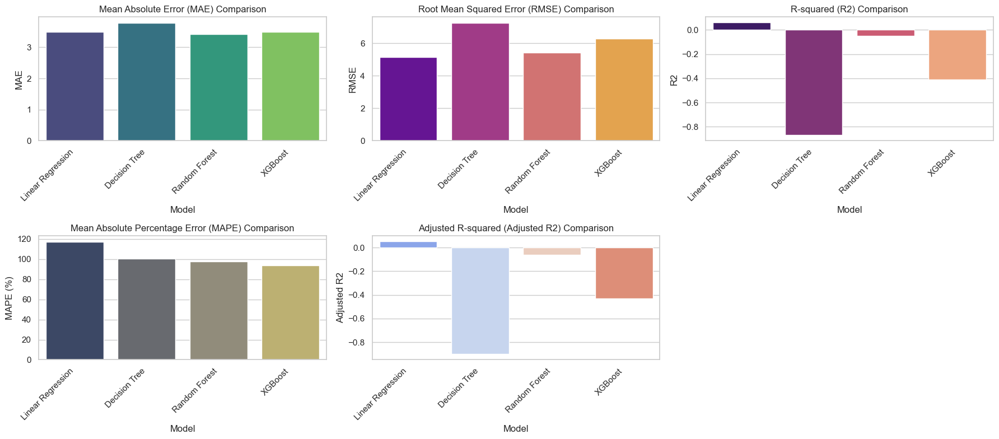

Regression performance comparison plot saved to 'regression_performance_comparison.png'.


Best Regression Model: Linear Regression
Best Regression Model saved as 'best_regression_model_Linear Regression.joblib'


Feature Coefficients from Linear Regression:
                     Feature  Coefficient
1   Financial Literacy Score    -0.994993
3        age_at_disbursement     0.717208
2  Aptitude for change Score    -0.395967
0             wellness_score    -0.354302
4       debt_to_income_ratio     0.256857
Linear Regression coefficients saved to 'linear_regression_coefficients.csv'.



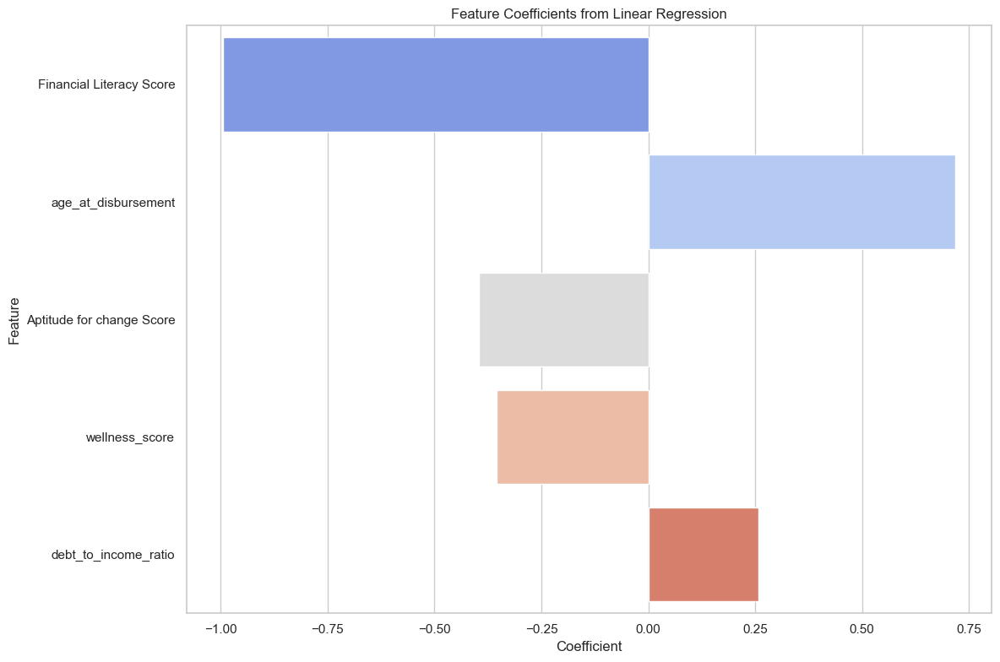

Coefficient plot saved to 'linear_regression_coefficients.png'.


Feature Coefficients for Linear Regression:
                     Feature  Coefficient
3        age_at_disbursement     0.717208
4       debt_to_income_ratio     0.256857
0             wellness_score    -0.354302
2  Aptitude for change Score    -0.395967
1   Financial Literacy Score    -0.994993
Linear Regression coefficients saved to 'linear_regression_coefficients.csv'.



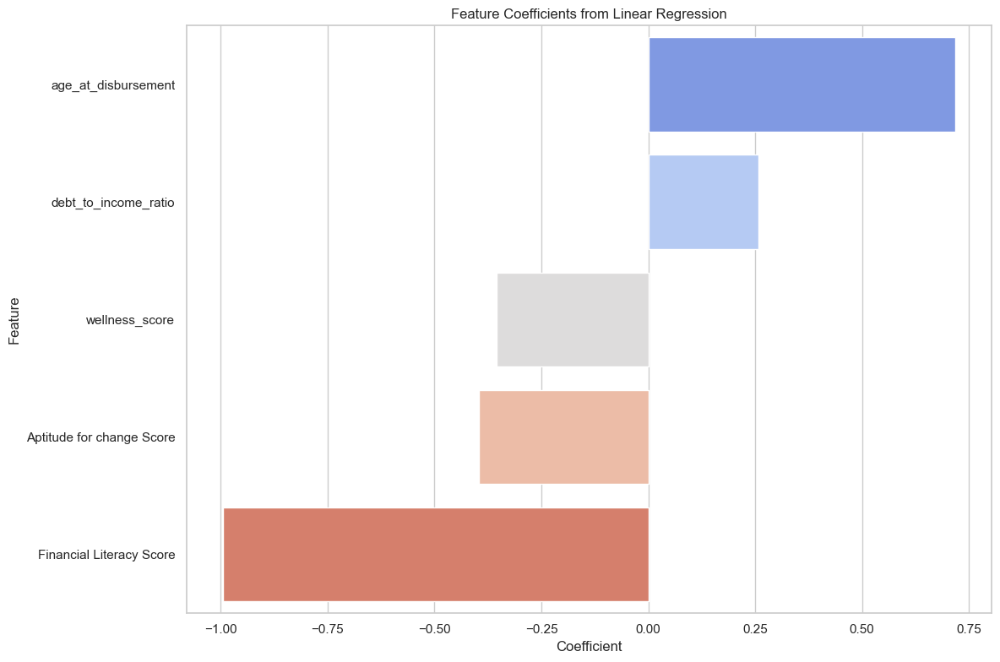

Linear Regression coefficients plot saved to 'linear_regression_coefficients.png'.


Sample of df_engagement:
     customer_id  wellness_score  Financial Literacy Score  \
1667       16138       53.000000                       2.0   
480         1215       48.936533                       0.0   
905        14063       41.000000                       5.0   
1151        1463       19.000000                       0.0   
29         11036       50.000000                       4.0   

      Aptitude for change Score  age_at_disbursement  debt_to_income_ratio  \
1667                       4.00                 31.0              0.362265   
480                        3.67                 50.0              0.213059   
905                        3.17                 60.0              0.493272   
1151                       4.00                 33.0              0.229721   
29                         2.33                 60.0              0.177331   

      Actual_activities_count  Predicted_activit

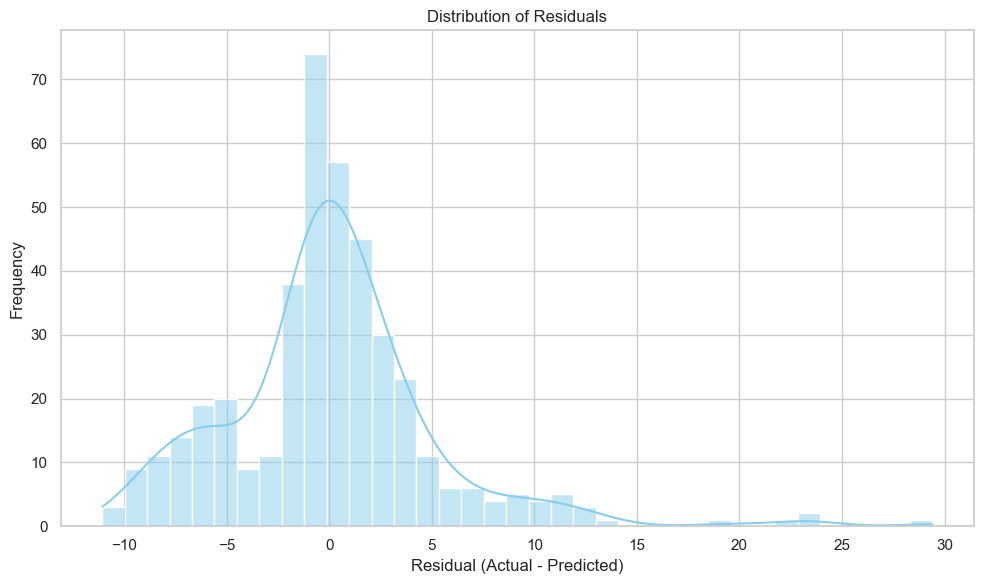

Residuals distribution plot saved to 'residuals_distribution.png'.



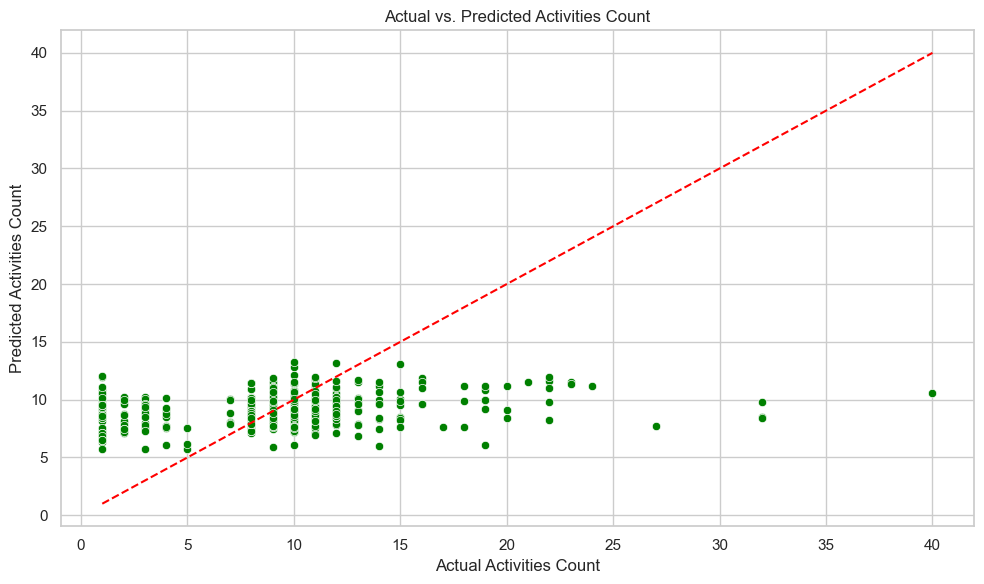

Actual vs. Predicted Activities Count plot saved to 'actual_vs_predicted_activities.png'.



In [3]:
# ----------------------------
# 5. Customer Engagement Model (Regression)
# ----------------------------
print("Training Customer Engagement Model (Regression)...\n")

# Define Feature Columns for Engagement Model (Removed 'dti_missing')
engagement_feature_columns = [
    'wellness_score',
    'Financial Literacy Score',
    'Aptitude for change Score',
    'age_at_disbursement',
    'debt_to_income_ratio'
] + [col for col in full_data_encoded.columns 
     if 'Gender_' in col or 'Province_' in col or 'Residential Status_' in col]

# Ensure all engagement feature columns exist
missing_eng_features = [feat for feat in engagement_feature_columns if feat not in full_data_encoded.columns]
if missing_eng_features:
    print(f"\nWarning: The following engagement features are missing and will be skipped: {missing_eng_features}")
    engagement_feature_columns = [feat for feat in engagement_feature_columns if feat in full_data_encoded.columns]

# Features and Target
X_engagement = full_data_encoded[engagement_feature_columns]
y_engagement = full_data_encoded['activities_count']

# Extract customer_id
customer_ids = full_data_encoded['customer_id']

# Train-Test Split (Include customer_id)
X_train_eng, X_test_eng, y_train_eng, y_test_eng, customer_train, customer_test = train_test_split(
    X_engagement, y_engagement, customer_ids, test_size=0.2, random_state=42
)

# Feature Scaling
scaler_eng = StandardScaler()
X_train_eng_scaled = scaler_eng.fit_transform(X_train_eng)
X_test_eng_scaled = scaler_eng.transform(X_test_eng)

# Define Regression Models (Removed LightGBM, SVR, KNN, Neural Network)
regression_models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(
        n_estimators=200, max_depth=None, min_samples_split=2, random_state=42
    ),
    'XGBoost': xgb.XGBRegressor(
        objective='reg:squarederror', n_estimators=200, max_depth=None,
        learning_rate=0.1, random_state=42
    )
}

# Dictionary to Store Performance Metrics
regression_performance = {
    'Model': [],
    'MAE': [],
    'RMSE': [],
    'R2': [],
    'MAPE (%)': [],
    'Adjusted R2': []
}

# Function to Calculate Adjusted R²
def adjusted_r2(r2, n, k):
    if n - k - 1 != 0:
        return 1 - (1 - r2) * (n - 1) / (n - k - 1)
    else:
        return np.nan

# Train and Evaluate Regression Models
for model_name, model in regression_models.items():
    # Select appropriate data
    if model_name in ['Linear Regression', 'Random Forest', 'XGBoost']:
        X_tr = X_train_eng_scaled
        X_te = X_test_eng_scaled
    else:
        X_tr = X_train_eng
        X_te = X_test_eng

    # Train the model
    model.fit(X_tr, y_train_eng)

    # Predict on test data
    y_pred = model.predict(X_te)

    # Calculate metrics
    mae = mean_absolute_error(y_test_eng, y_pred)
    mse = mean_squared_error(y_test_eng, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test_eng, y_pred)
    # Handle cases where y_test_eng contains zeros for MAPE
    if (y_test_eng == 0).any():
        mape = np.nan
    else:
        mape = mean_absolute_percentage_error(y_test_eng, y_pred) * 100
    n = X_test_eng.shape[0]
    k = X_test_eng.shape[1]
    adj_r2 = adjusted_r2(r2, n, k)

    # Store metrics
    regression_performance['Model'].append(model_name)
    regression_performance['MAE'].append(round(mae, 2))
    regression_performance['RMSE'].append(round(rmse, 2))
    regression_performance['R2'].append(round(r2, 2))
    regression_performance['MAPE (%)'].append(round(mape, 2) if not np.isnan(mape) else 'NaN')
    regression_performance['Adjusted R2'].append(round(adj_r2, 2) if not np.isnan(adj_r2) else 'NaN')

    # Print metrics
    print(f"\n{model_name} Performance:")
    print(f"Mean Absolute Error (MAE): {mae:.2f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
    print(f"R-squared (R2 ): {r2:.2f}")
    if not np.isnan(mape):
        print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")
    else:
        print("Mean Absolute Percentage Error (MAPE): NaN (Division by zero encountered)")
    if not np.isnan(adj_r2):
        print(f"Adjusted R-squared (Adjusted R2): {adj_r2:.2f}")
    else:
        print("Adjusted R-squared (Adjusted R2): NaN (Insufficient data for adjustment)")

# Compare Regression Models
regression_performance_df = pd.DataFrame(regression_performance)
print("\nRegression Model Performance Comparison:")
print(regression_performance_df.sort_values(by='R2', ascending=False))

# Save Regression Performance
regression_performance_df.to_csv(os.path.join(OUTPUT_DIR, 'regression_performance.csv'), index=False)
print("\nRegression performance metrics saved to 'regression_performance.csv'.\n")

# Visualize Regression Performance
plt.figure(figsize=(18, 8))

# MAE Comparison
plt.subplot(2, 3, 1)
sns.barplot(data=regression_performance_df, x='Model', y='MAE', palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Mean Absolute Error (MAE) Comparison')
plt.ylabel('MAE')
plt.xlabel('Model')

# RMSE Comparison
plt.subplot(2, 3, 2)
sns.barplot(data=regression_performance_df, x='Model', y='RMSE', palette='plasma')
plt.xticks(rotation=45, ha='right')
plt.title('Root Mean Squared Error (RMSE) Comparison')
plt.ylabel('RMSE')
plt.xlabel('Model')

# R2 Comparison
plt.subplot(2, 3, 3)
sns.barplot(data=regression_performance_df, x='Model', y='R2', palette='magma')
plt.xticks(rotation=45, ha='right')
plt.title('R-squared (R2) Comparison')
plt.ylabel('R2')
plt.xlabel('Model')

# MAPE Comparison
plt.subplot(2, 3, 4)
sns.barplot(data=regression_performance_df, x='Model', y='MAPE (%)', palette='cividis')
plt.xticks(rotation=45, ha='right')
plt.title('Mean Absolute Percentage Error (MAPE) Comparison')
plt.ylabel('MAPE (%)')
plt.xlabel('Model')

# Adjusted R2 Comparison
plt.subplot(2, 3, 5)
sns.barplot(data=regression_performance_df, x='Model', y='Adjusted R2', palette='coolwarm')
plt.xticks(rotation=45, ha='right')
plt.title('Adjusted R-squared (Adjusted R2) Comparison')
plt.ylabel('Adjusted R2')
plt.xlabel('Model')

plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, 'regression_performance_comparison.png'))
plt.show()
print("Regression performance comparison plot saved to 'regression_performance_comparison.png'.\n")

# Identify Best Regression Model
best_regression_model_name = regression_performance_df.sort_values(by='R2', ascending=False).iloc[0]['Model']
best_regression_model = regression_models[best_regression_model_name]
print(f"\nBest Regression Model: {best_regression_model_name}")

# Save the Best Regression Model
joblib.dump(best_regression_model, os.path.join(OUTPUT_DIR, f'best_regression_model_{best_regression_model_name}.joblib'))
print(f"Best Regression Model saved as 'best_regression_model_{best_regression_model_name}.joblib'\n")

# Feature Importance for Best Regression Model
if best_regression_model_name in ['Random Forest', 'XGBoost']:
    importances = best_regression_model.feature_importances_
    feature_names = engagement_feature_columns
    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': importances
    }).sort_values(by='Importance', ascending=False)
    
    # Plot Feature Importances
    plt.figure(figsize=(12, 8))
    sns.barplot(data=feature_importance_df, x='Importance', y='Feature', palette='magma')
    plt.title(f'Feature Importances from {best_regression_model_name}')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, f'feature_importance_{best_regression_model_name}.png'))
    plt.show()
    print(f"Feature importance plot saved to 'feature_importance_{best_regression_model_name}.png'.\n")
elif best_regression_model_name == 'Linear Regression':
    coefficients = best_regression_model.coef_
    feature_names = engagement_feature_columns
    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Coefficient': coefficients
    })
    feature_importance_df['Importance'] = feature_importance_df['Coefficient'].abs()
    feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)
    
    # Display coefficients
    print("\nFeature Coefficients from Linear Regression:")
    print(feature_importance_df[['Feature', 'Coefficient']])
    
    # Save coefficients to CSV
    feature_importance_df[['Feature', 'Coefficient']].to_csv(os.path.join(OUTPUT_DIR, 'linear_regression_coefficients.csv'), index=False)
    print("Linear Regression coefficients saved to 'linear_regression_coefficients.csv'.\n")
    
    # Plot Coefficients
    plt.figure(figsize=(12, 8))
    sns.barplot(data=feature_importance_df, x='Coefficient', y='Feature', palette='coolwarm')
    plt.title('Feature Coefficients from Linear Regression')
    plt.xlabel('Coefficient')
    plt.ylabel('Feature')
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, 'linear_regression_coefficients.png'))
    plt.show()
    print("Coefficient plot saved to 'linear_regression_coefficients.png'.\n")
elif best_regression_model_name == 'Decision Tree':
    importances = best_regression_model.feature_importances_
    feature_names = engagement_feature_columns
    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': importances
    }).sort_values(by='Importance', ascending=False)
    
    # Plot Feature Importances
    plt.figure(figsize=(12, 8))
    sns.barplot(data=feature_importance_df, x='Importance', y='Feature', palette='cividis')
    plt.title('Feature Importances from Decision Tree Regressor')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, 'feature_importance_decision_tree.png'))
    plt.show()
    print("Feature importance plot saved to 'feature_importance_decision_tree.png'.\n")
else:
    print(f"{best_regression_model_name} does not provide straightforward feature importances.\n")

# ----------------------------
# 5.1. Extracting and Displaying Coefficients for Different Classes
# ----------------------------

# Check if the best model is Linear Regression to extract coefficients
if best_regression_model_name == 'Linear Regression':
    coefficients = best_regression_model.coef_
    feature_names = engagement_feature_columns
    coef_df = pd.DataFrame({
        'Feature': feature_names,
        'Coefficient': coefficients
    })
    
    # Display coefficients
    print("\nFeature Coefficients for Linear Regression:")
    print(coef_df.sort_values(by='Coefficient', ascending=False))
    
    # Save coefficients to CSV
    coef_df.to_csv(os.path.join(OUTPUT_DIR, 'linear_regression_coefficients.csv'), index=False)
    print("Linear Regression coefficients saved to 'linear_regression_coefficients.csv'.\n")
    
    # Visualize Coefficients
    plt.figure(figsize=(12, 8))
    sns.barplot(data=coef_df.sort_values(by='Coefficient', ascending=False), x='Coefficient', y='Feature', palette='coolwarm')
    plt.title('Feature Coefficients from Linear Regression')
    plt.xlabel('Coefficient')
    plt.ylabel('Feature')
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, 'linear_regression_coefficients.png'))
    plt.show()
    print("Linear Regression coefficients plot saved to 'linear_regression_coefficients.png'.\n")
    
# For tree-based models, feature importances have already been plotted above

# ----------------------------
# 5.2. Exporting Predictions to df_engagement
# ----------------------------

# Make sure to define y_pred_final using the best model
if best_regression_model_name in ['Linear Regression', 'Random Forest', 'XGBoost']:
    # These models were trained on scaled data
    y_pred_final = best_regression_model.predict(X_test_eng_scaled)
elif best_regression_model_name == 'Decision Tree':
    # Decision Tree was trained on unscaled data
    y_pred_final = best_regression_model.predict(X_test_eng)
else:
    # Default to scaled data if unsure
    y_pred_final = best_regression_model.predict(X_test_eng_scaled)

# Create a DataFrame with test set features, customer_id, actual, and predicted activities_count
df_engagement = X_test_eng.copy()

# Add customer_id
df_engagement['customer_id'] = customer_test.values

# Add actual activities_count
df_engagement['Actual_activities_count'] = y_test_eng.values

# Add predicted activities_count
df_engagement['Predicted_activities_count'] = y_pred_final

# Calculate residuals (Actual - Predicted)
df_engagement['Residual'] = df_engagement['Actual_activities_count'] - df_engagement['Predicted_activities_count']

# Reorder columns to place customer_id first
columns_order = ['customer_id'] + [col for col in df_engagement.columns if col != 'customer_id']
df_engagement = df_engagement[columns_order]

# Display the first few rows of df_engagement
print("\nSample of df_engagement:")
print(df_engagement.head())

# Save df_engagement to CSV
df_engagement.to_csv(os.path.join(OUTPUT_DIR, 'df_engagement.csv'), index=False)
print(f"\ndf_engagement saved to '{os.path.join(OUTPUT_DIR, 'df_engagement.csv')}'.\n")

# Optional: Visualize residuals
plt.figure(figsize=(10, 6))
sns.histplot(df_engagement['Residual'], kde=True, color='skyblue')
plt.title('Distribution of Residuals')
plt.xlabel('Residual (Actual - Predicted)')
plt.ylabel('Frequency')
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, 'residuals_distribution.png'))
plt.show()
print("Residuals distribution plot saved to 'residuals_distribution.png'.\n")

# Optional: Plot Actual vs Predicted Activities Count
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Actual_activities_count', y='Predicted_activities_count', data=df_engagement, color='green')
plt.plot([df_engagement['Actual_activities_count'].min(), df_engagement['Actual_activities_count'].max()],
         [df_engagement['Actual_activities_count'].min(), df_engagement['Actual_activities_count'].max()],
         color='red', linestyle='--')
plt.title('Actual vs. Predicted Activities Count')
plt.xlabel('Actual Activities Count')
plt.ylabel('Predicted Activities Count')
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, 'actual_vs_predicted_activities.png'))
plt.show()
print("Actual vs. Predicted Activities Count plot saved to 'actual_vs_predicted_activities.png'.\n")


Training Loan Repayment Risk Model (Classification)...


Dropped 0 duplicate records from full_data.

Repayment_Risk column created in full_data:
   customer_id  Loan Status  Repayment_Risk
0        11011       Active               0
19       11036       Active               0
39       11154  Written off               1
42       11169     Past due               1
43       11182       Repaid               0
Number of high-risk loans: 37

Unique customer_ids in full_data: 188
Unique customer_ids in full_data_encoded: 149
Number of missing 'customer_id's in 'full_data_encoded': 39
Missing 'customer_id's: ['163', '14497', '15565', '11247', '16436']

Records after left merge: 413
_merge
both          413
left_only       0
right_only      0
Name: count, dtype: int64
Missing 'Repayment_Risk' before imputation: 0
Filled missing 'Repayment_Risk' with 0 (Low Risk). Remaining missing: 0

Number of duplicate 'customer_id's in cis_data: 264
Duplicates found. Aggregating data by 'customer_id'.
Reco

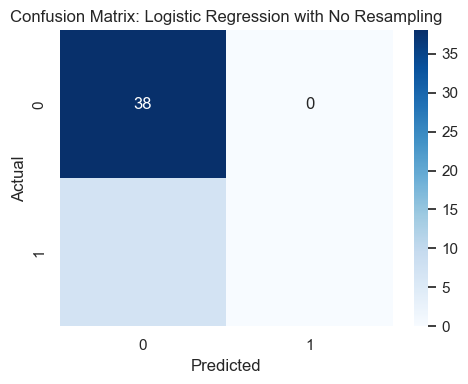

Confusion matrix saved to 'confusion_matrix_Logistic Regression_No Resampling.png'.



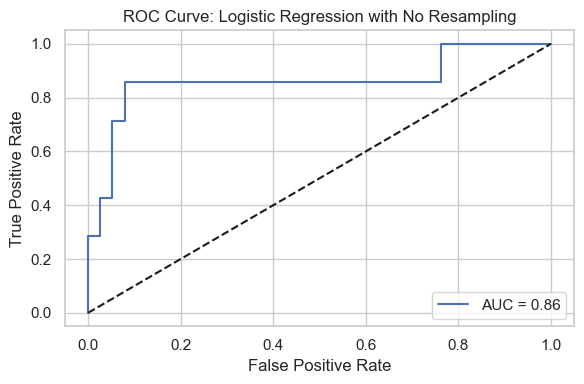

ROC curve saved to 'roc_curve_Logistic Regression_No Resampling.png'.


Training and tuning Decision Tree with No Resampling...

Decision Tree Performance with No Resampling:
Accuracy: 0.89
Precision: 0.75
Recall: 0.43
F1-Score: 0.55
AUC: 0.83


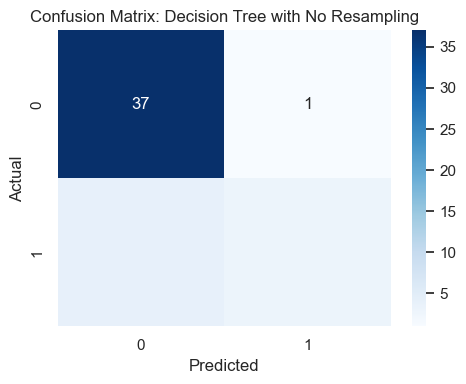

Confusion matrix saved to 'confusion_matrix_Decision Tree_No Resampling.png'.



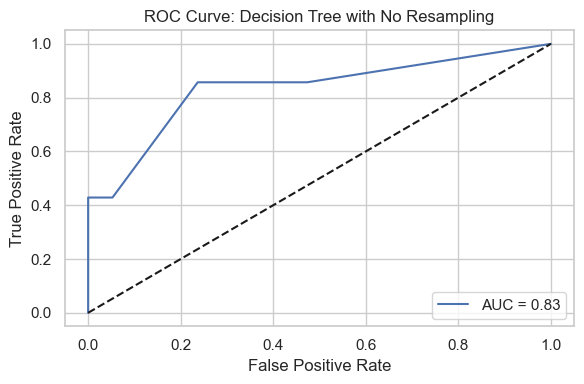

ROC curve saved to 'roc_curve_Decision Tree_No Resampling.png'.


Training and tuning Random Forest with No Resampling...

Random Forest Performance with No Resampling:
Accuracy: 0.87
Precision: 1.00
Recall: 0.14
F1-Score: 0.25
AUC: 0.91


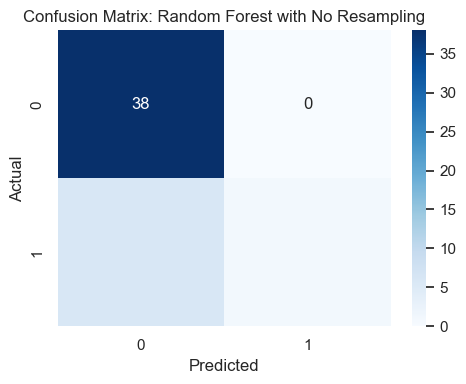

Confusion matrix saved to 'confusion_matrix_Random Forest_No Resampling.png'.



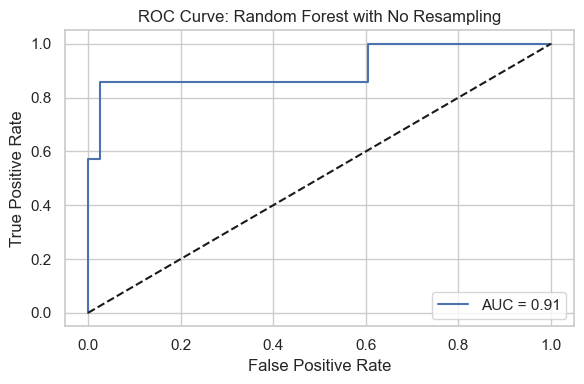

ROC curve saved to 'roc_curve_Random Forest_No Resampling.png'.


Training and tuning XGBoost with No Resampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:42:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:42:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:42:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:42:58] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with No Resampling:
Accuracy: 0.82
Precision: 0.00
Recall: 0.00
F1-Score: 0.00
AUC: 0.81


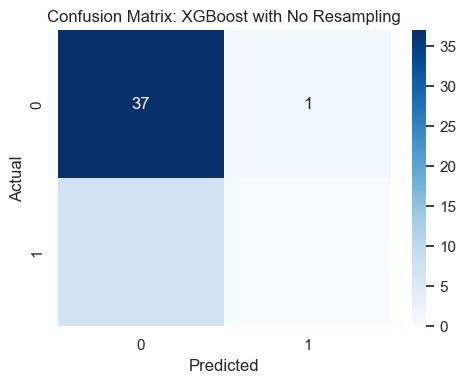

Confusion matrix saved to 'confusion_matrix_XGBoost_No Resampling.png'.



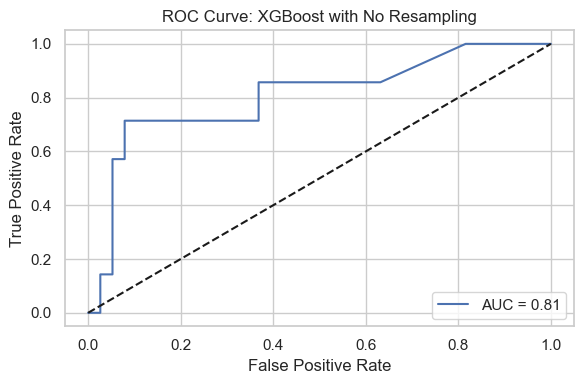

ROC curve saved to 'roc_curve_XGBoost_No Resampling.png'.


Training and tuning LightGBM with No Resampling...
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 88
[LightGBM] [Info] Number of data points in the train set: 83, number of used features: 3
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] Number of positive: 12, number of negative: 71
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] Number of positive: 13, number of negative: 70
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.156627 -> initscore=-1.683546
[LightG

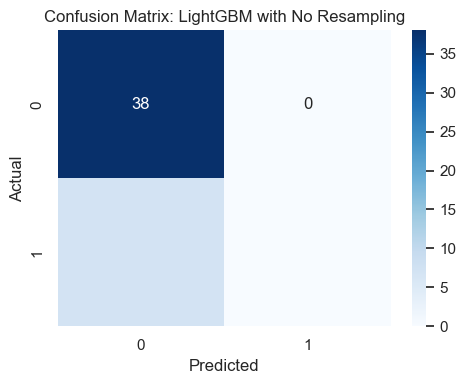

Confusion matrix saved to 'confusion_matrix_LightGBM_No Resampling.png'.



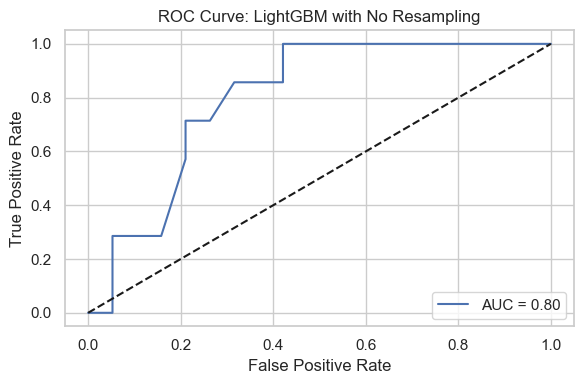

ROC curve saved to 'roc_curve_LightGBM_No Resampling.png'.


Training and tuning KNN with No Resampling...

KNN Performance with No Resampling:
Accuracy: 0.84
Precision: 0.00
Recall: 0.00
F1-Score: 0.00
AUC: 0.77


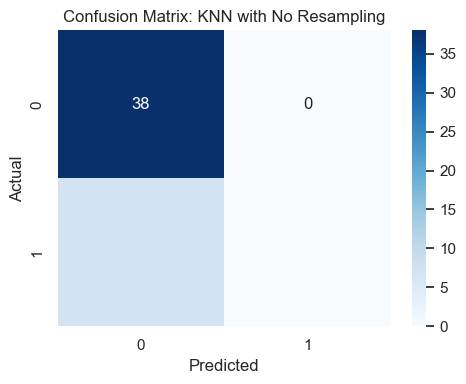

Confusion matrix saved to 'confusion_matrix_KNN_No Resampling.png'.



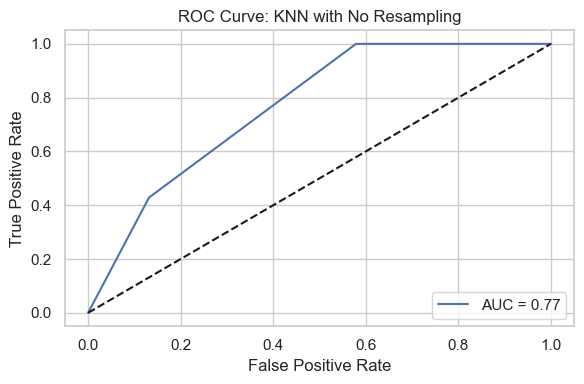

ROC curve saved to 'roc_curve_KNN_No Resampling.png'.


--- Resampling Method: Random Under-Sampling ---

Applied Random Under-Sampling. Resampled training set size: 32

Training and tuning Logistic Regression with Random Under-Sampling...

Logistic Regression Performance with Random Under-Sampling:
Accuracy: 0.58
Precision: 0.23
Recall: 0.71
F1-Score: 0.34
AUC: 0.77


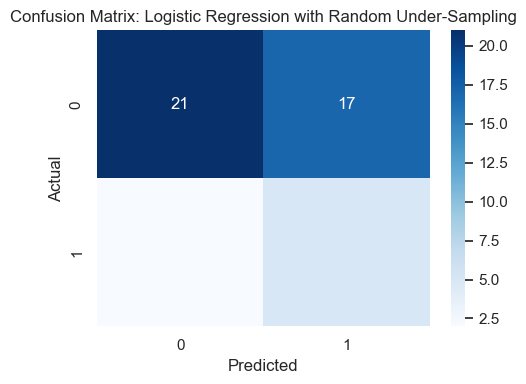

Confusion matrix saved to 'confusion_matrix_Logistic Regression_Random Under-Sampling.png'.



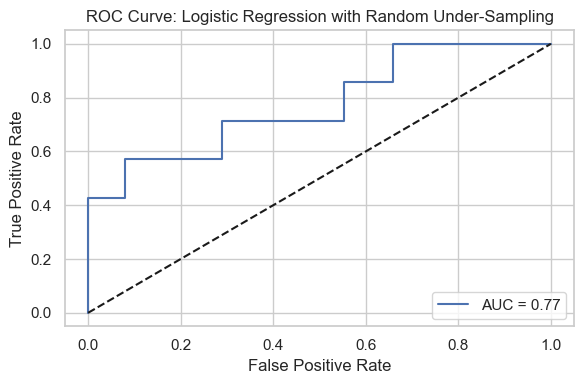

ROC curve saved to 'roc_curve_Logistic Regression_Random Under-Sampling.png'.


Training and tuning Decision Tree with Random Under-Sampling...

Decision Tree Performance with Random Under-Sampling:
Accuracy: 0.42
Precision: 0.19
Recall: 0.86
F1-Score: 0.32
AUC: 0.58


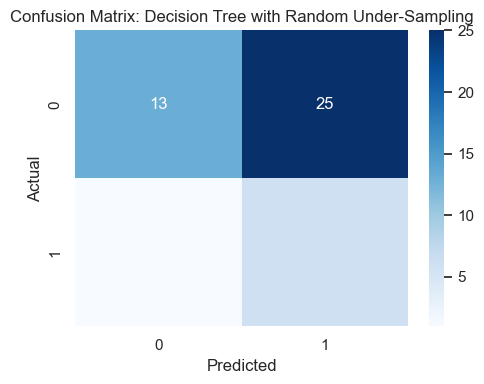

Confusion matrix saved to 'confusion_matrix_Decision Tree_Random Under-Sampling.png'.



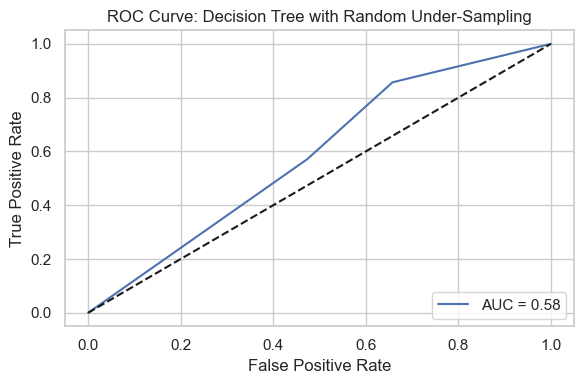

ROC curve saved to 'roc_curve_Decision Tree_Random Under-Sampling.png'.


Training and tuning Random Forest with Random Under-Sampling...

Random Forest Performance with Random Under-Sampling:
Accuracy: 0.47
Precision: 0.19
Recall: 0.71
F1-Score: 0.29
AUC: 0.75


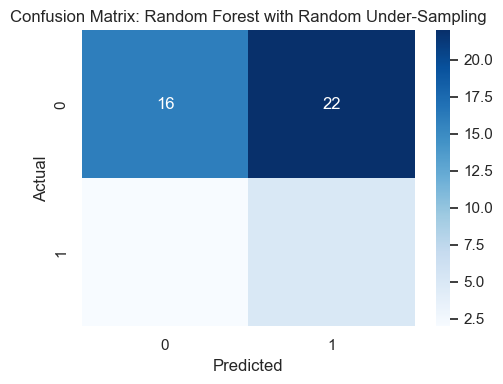

Confusion matrix saved to 'confusion_matrix_Random Forest_Random Under-Sampling.png'.



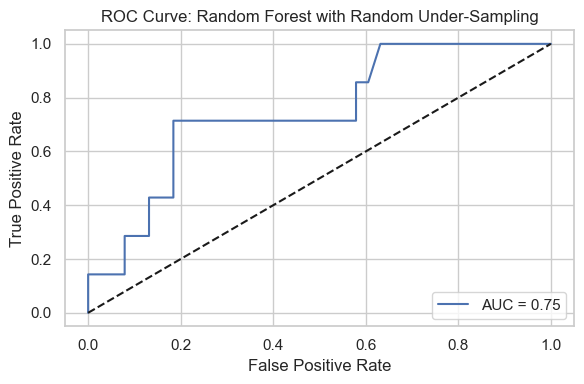

ROC curve saved to 'roc_curve_Random Forest_Random Under-Sampling.png'.


Training and tuning XGBoost with Random Under-Sampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with Random Under-Sampling:
Accuracy: 0.60
Precision: 0.26
Recall: 0.86
F1-Score: 0.40
AUC: 0.78


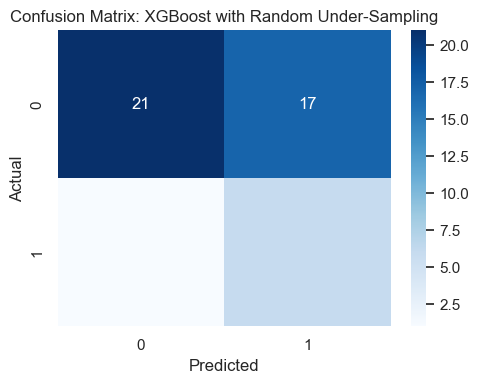

Confusion matrix saved to 'confusion_matrix_XGBoost_Random Under-Sampling.png'.



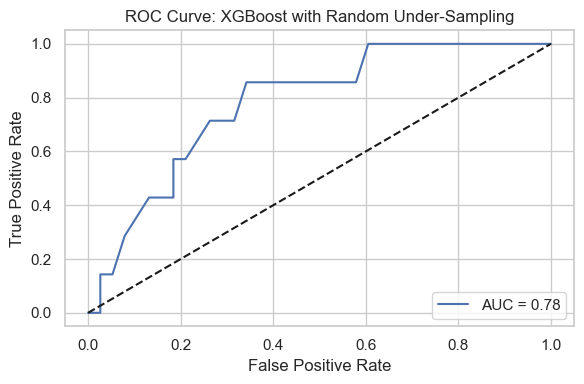

ROC curve saved to 'roc_curve_XGBoost_Random Under-Sampling.png'.


Training and tuning LightGBM with Random Under-Sampling...
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 13, number of negative: 12
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 25, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520000 -> initscore=0.080043
[LightGBM] [Info] Start training from score 0.080043
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopp

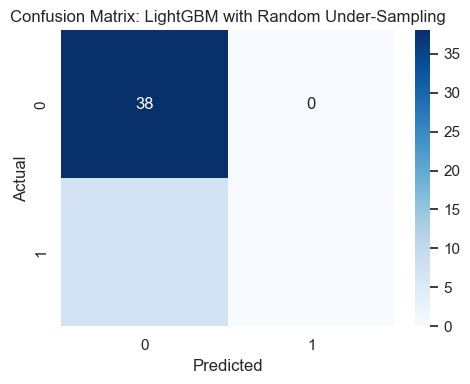

Confusion matrix saved to 'confusion_matrix_LightGBM_Random Under-Sampling.png'.



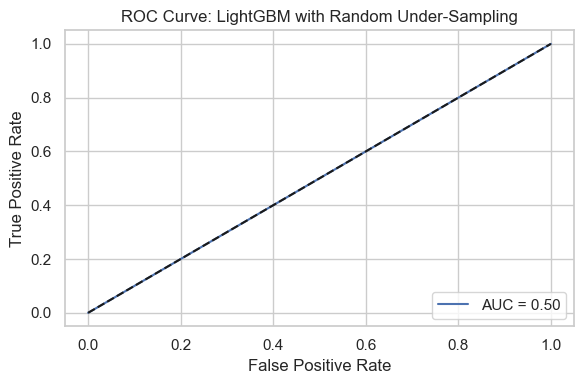

ROC curve saved to 'roc_curve_LightGBM_Random Under-Sampling.png'.


Training and tuning KNN with Random Under-Sampling...

KNN Performance with Random Under-Sampling:
Accuracy: 0.53
Precision: 0.23
Recall: 0.86
F1-Score: 0.36
AUC: 0.77


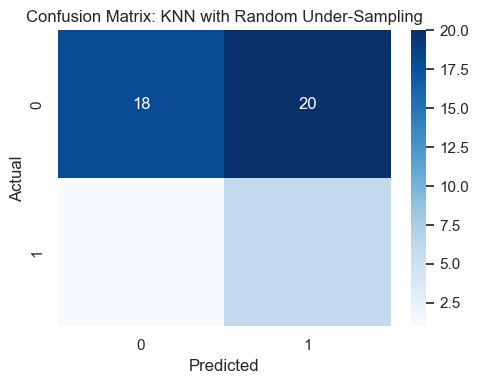

Confusion matrix saved to 'confusion_matrix_KNN_Random Under-Sampling.png'.



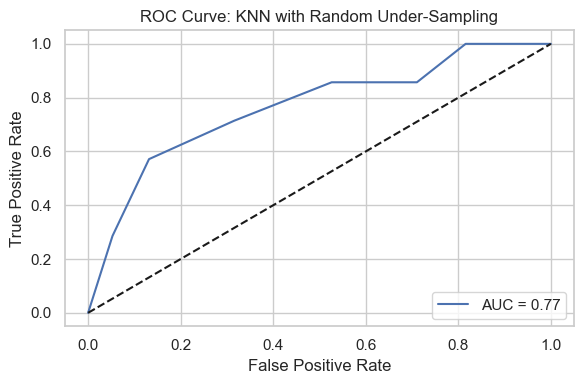

ROC curve saved to 'roc_curve_KNN_Random Under-Sampling.png'.


--- Resampling Method: Random Over-Sampling ---

Applied Random Over-Sampling. Resampled training set size: 176

Training and tuning Logistic Regression with Random Over-Sampling...

Logistic Regression Performance with Random Over-Sampling:
Accuracy: 0.69
Precision: 0.32
Recall: 0.86
F1-Score: 0.46
AUC: 0.86


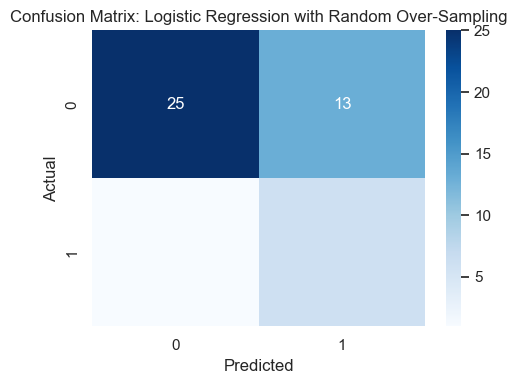

Confusion matrix saved to 'confusion_matrix_Logistic Regression_Random Over-Sampling.png'.



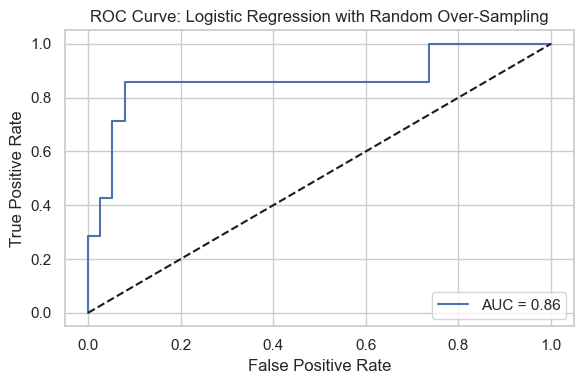

ROC curve saved to 'roc_curve_Logistic Regression_Random Over-Sampling.png'.


Training and tuning Decision Tree with Random Over-Sampling...

Decision Tree Performance with Random Over-Sampling:
Accuracy: 0.84
Precision: 0.50
Recall: 0.43
F1-Score: 0.46
AUC: 0.68


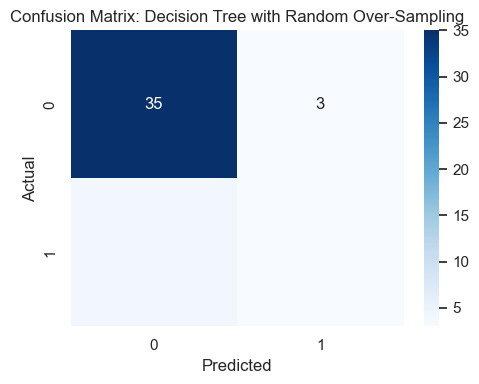

Confusion matrix saved to 'confusion_matrix_Decision Tree_Random Over-Sampling.png'.



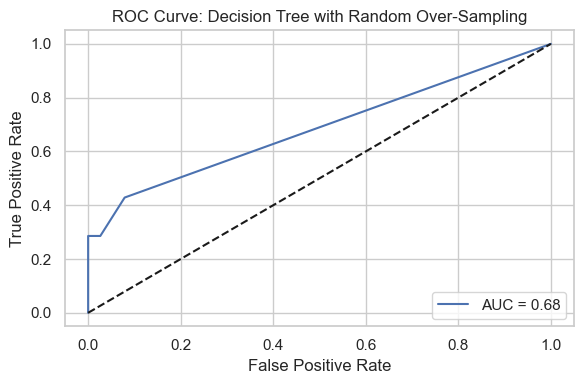

ROC curve saved to 'roc_curve_Decision Tree_Random Over-Sampling.png'.


Training and tuning Random Forest with Random Over-Sampling...

Random Forest Performance with Random Over-Sampling:
Accuracy: 0.89
Precision: 0.62
Recall: 0.71
F1-Score: 0.67
AUC: 0.84


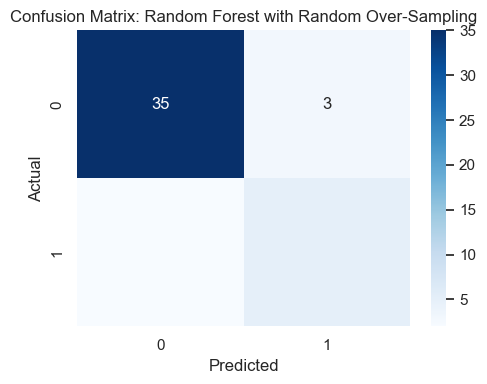

Confusion matrix saved to 'confusion_matrix_Random Forest_Random Over-Sampling.png'.



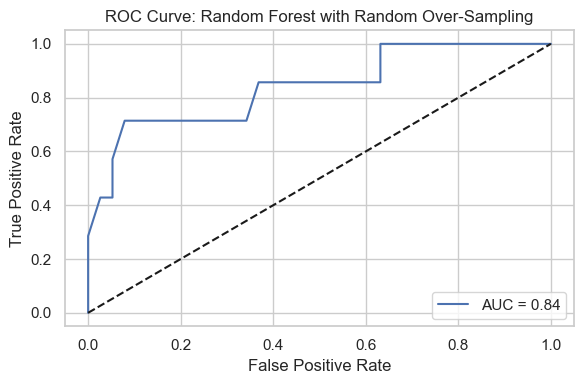

ROC curve saved to 'roc_curve_Random Forest_Random Over-Sampling.png'.


Training and tuning XGBoost with Random Over-Sampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with Random Over-Sampling:
Accuracy: 0.91
Precision: 0.71
Recall: 0.71
F1-Score: 0.71
AUC: 0.84


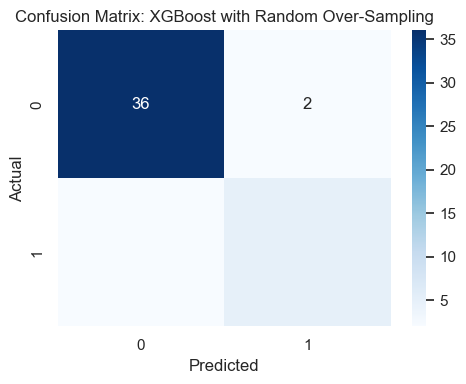

Confusion matrix saved to 'confusion_matrix_XGBoost_Random Over-Sampling.png'.



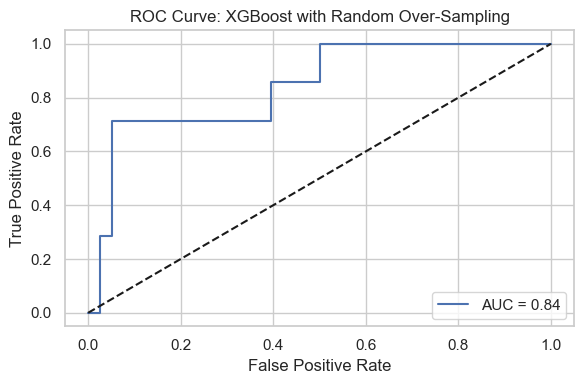

ROC curve saved to 'roc_curve_XGBoost_Random Over-Sampling.png'.


Training and tuning LightGBM with Random Over-Sampling...
[LightGBM] [Info] Number of positive: 70, number of negative: 70
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 108
[LightGBM] [Info] Number of data points in the train set: 140, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

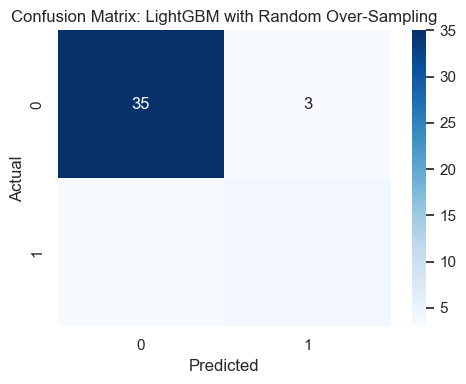

Confusion matrix saved to 'confusion_matrix_LightGBM_Random Over-Sampling.png'.



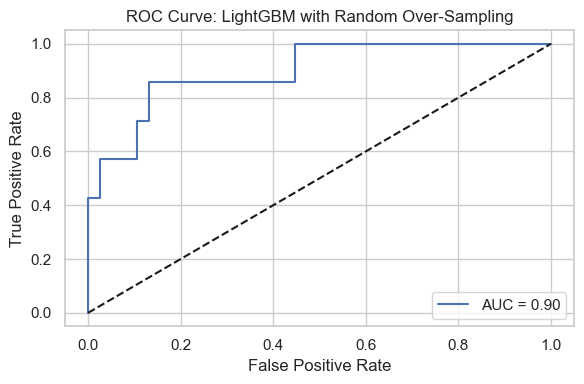

ROC curve saved to 'roc_curve_LightGBM_Random Over-Sampling.png'.


Training and tuning KNN with Random Over-Sampling...

KNN Performance with Random Over-Sampling:
Accuracy: 0.56
Precision: 0.24
Recall: 0.86
F1-Score: 0.38
AUC: 0.72


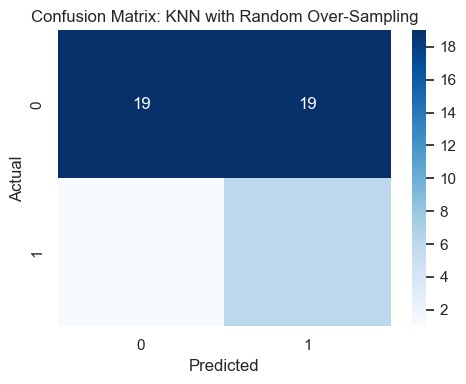

Confusion matrix saved to 'confusion_matrix_KNN_Random Over-Sampling.png'.



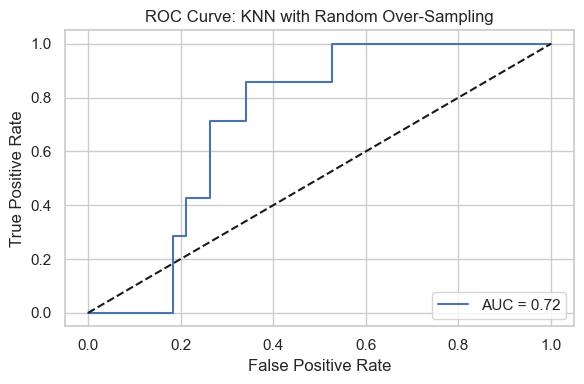

ROC curve saved to 'roc_curve_KNN_Random Over-Sampling.png'.


--- Resampling Method: SMOTE ---

Applied SMOTE. Resampled training set size: 176

Training and tuning Logistic Regression with SMOTE...

Logistic Regression Performance with SMOTE:
Accuracy: 0.71
Precision: 0.33
Recall: 0.86
F1-Score: 0.48
AUC: 0.85


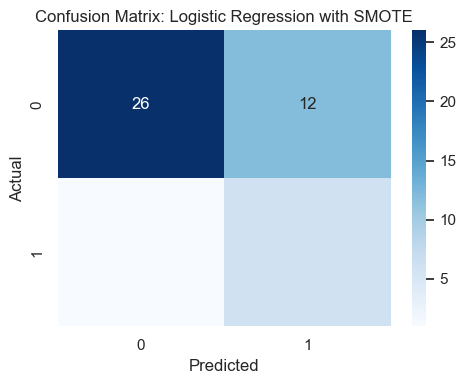

Confusion matrix saved to 'confusion_matrix_Logistic Regression_SMOTE.png'.



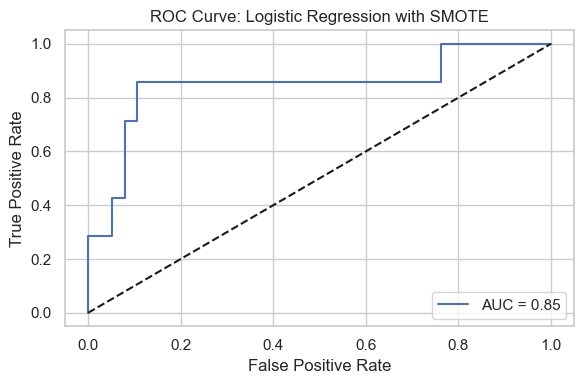

ROC curve saved to 'roc_curve_Logistic Regression_SMOTE.png'.


Training and tuning Decision Tree with SMOTE...

Decision Tree Performance with SMOTE:
Accuracy: 0.69
Precision: 0.29
Recall: 0.71
F1-Score: 0.42
AUC: 0.67


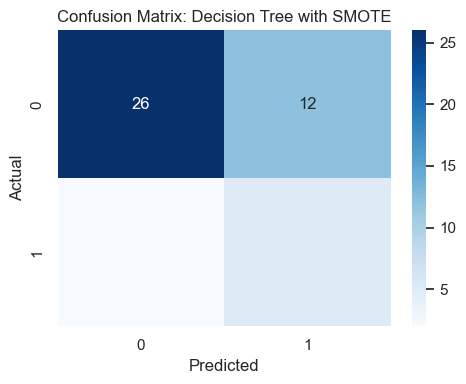

Confusion matrix saved to 'confusion_matrix_Decision Tree_SMOTE.png'.



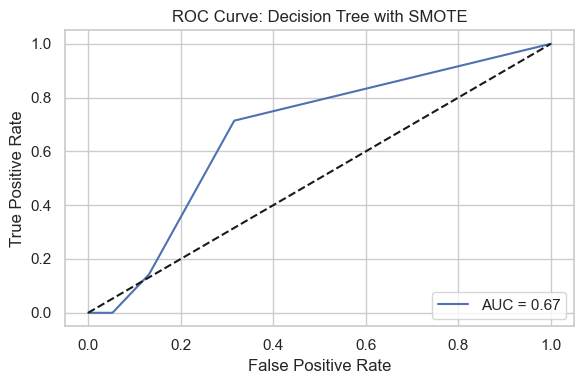

ROC curve saved to 'roc_curve_Decision Tree_SMOTE.png'.


Training and tuning Random Forest with SMOTE...

Random Forest Performance with SMOTE:
Accuracy: 0.78
Precision: 0.36
Recall: 0.57
F1-Score: 0.44
AUC: 0.75


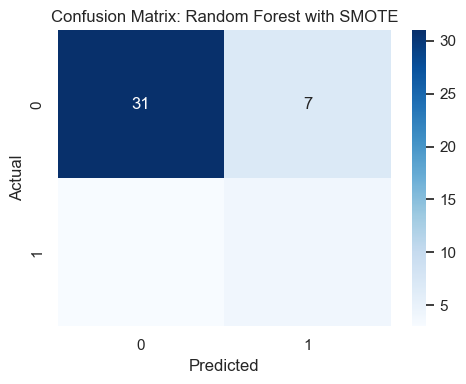

Confusion matrix saved to 'confusion_matrix_Random Forest_SMOTE.png'.



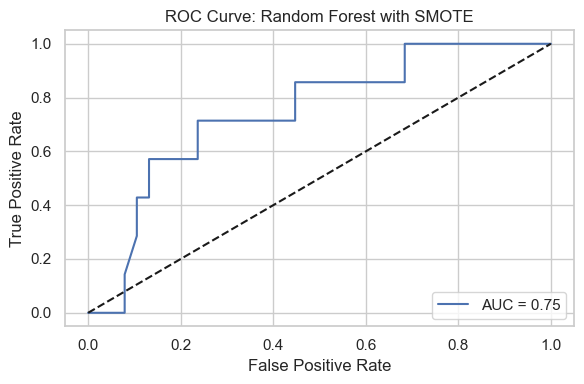

ROC curve saved to 'roc_curve_Random Forest_SMOTE.png'.


Training and tuning XGBoost with SMOTE...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:41] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:41] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:41] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:41] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with SMOTE:
Accuracy: 0.82
Precision: 0.44
Recall: 0.57
F1-Score: 0.50
AUC: 0.83


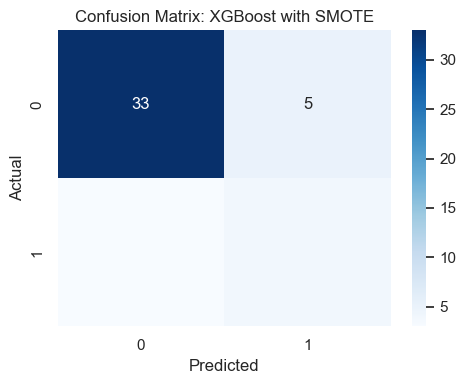

Confusion matrix saved to 'confusion_matrix_XGBoost_SMOTE.png'.



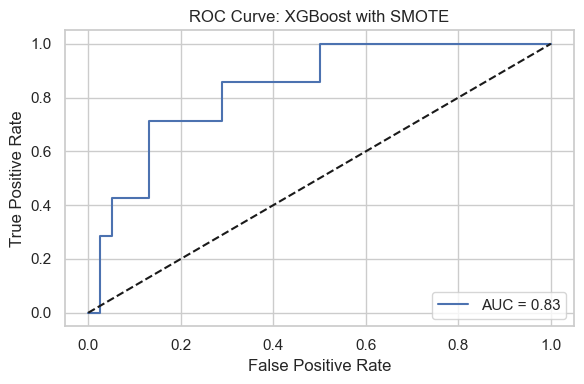

ROC curve saved to 'roc_curve_XGBoost_SMOTE.png'.


Training and tuning LightGBM with SMOTE...
[LightGBM] [Info] Number of positive: 70, number of negative: 70
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 144
[LightGBM] [Info] Number of data points in the train set: 140, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 71, number of negative: 70
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001302 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 146
[LightGBM] [Info] Number of data points in the train set: 141, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.5

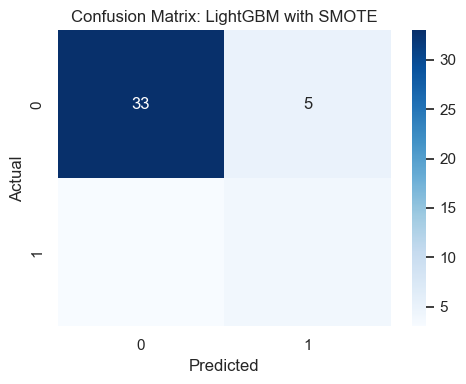

Confusion matrix saved to 'confusion_matrix_LightGBM_SMOTE.png'.



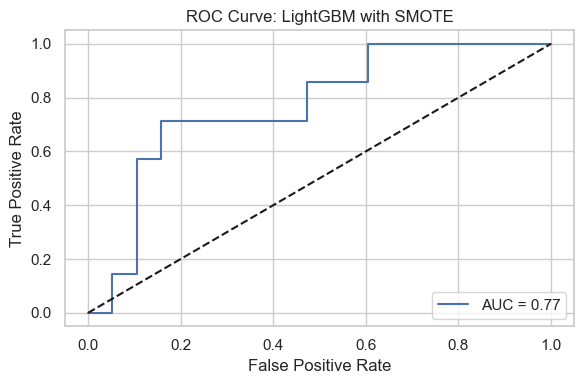

ROC curve saved to 'roc_curve_LightGBM_SMOTE.png'.


Training and tuning KNN with SMOTE...

KNN Performance with SMOTE:
Accuracy: 0.60
Precision: 0.24
Recall: 0.71
F1-Score: 0.36
AUC: 0.75


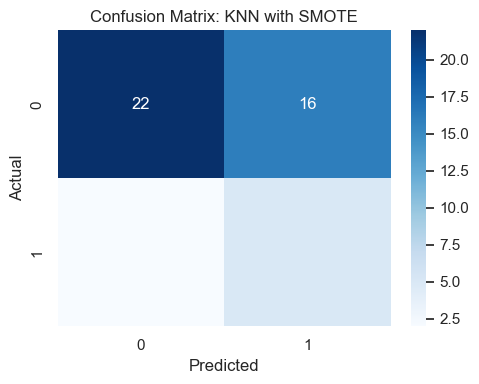

Confusion matrix saved to 'confusion_matrix_KNN_SMOTE.png'.



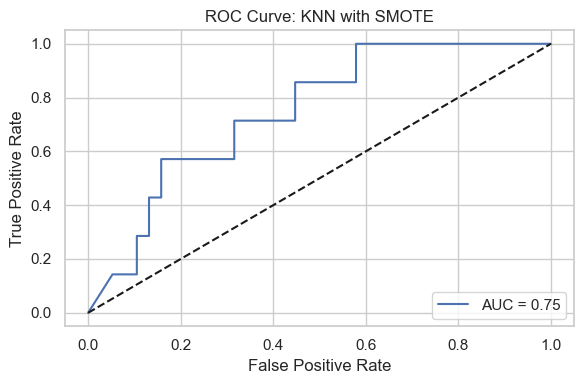

ROC curve saved to 'roc_curve_KNN_SMOTE.png'.


--- Resampling Method: ADASYN ---

Applied ADASYN. Resampled training set size: 172

Training and tuning Logistic Regression with ADASYN...

Logistic Regression Performance with ADASYN:
Accuracy: 0.71
Precision: 0.33
Recall: 0.86
F1-Score: 0.48
AUC: 0.86


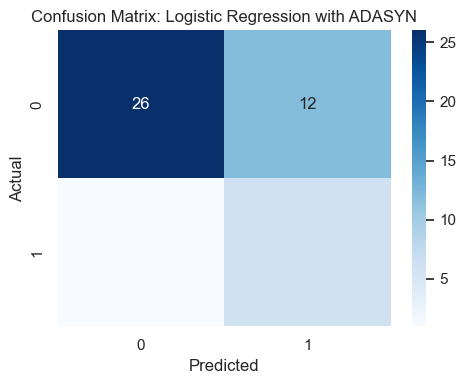

Confusion matrix saved to 'confusion_matrix_Logistic Regression_ADASYN.png'.



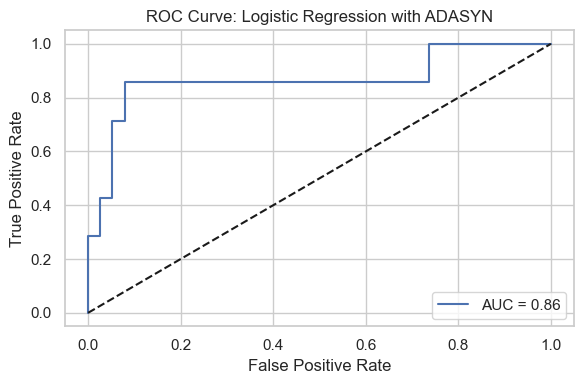

ROC curve saved to 'roc_curve_Logistic Regression_ADASYN.png'.


Training and tuning Decision Tree with ADASYN...

Decision Tree Performance with ADASYN:
Accuracy: 0.67
Precision: 0.28
Recall: 0.71
F1-Score: 0.40
AUC: 0.62


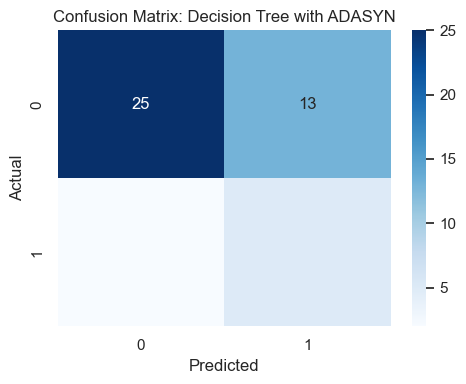

Confusion matrix saved to 'confusion_matrix_Decision Tree_ADASYN.png'.



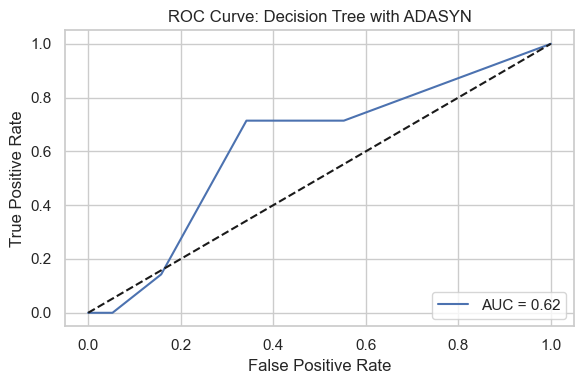

ROC curve saved to 'roc_curve_Decision Tree_ADASYN.png'.


Training and tuning Random Forest with ADASYN...

Random Forest Performance with ADASYN:
Accuracy: 0.80
Precision: 0.42
Recall: 0.71
F1-Score: 0.53
AUC: 0.78


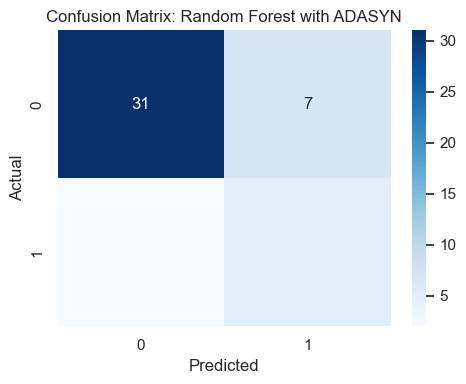

Confusion matrix saved to 'confusion_matrix_Random Forest_ADASYN.png'.



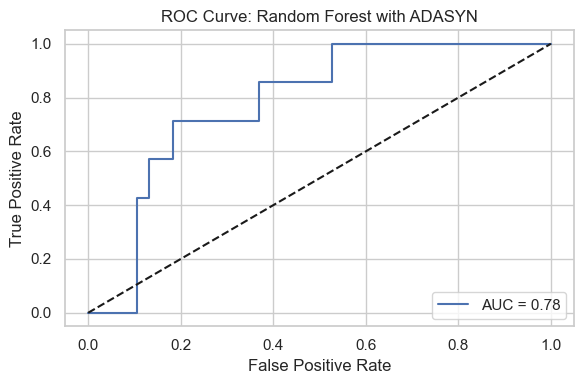

ROC curve saved to 'roc_curve_Random Forest_ADASYN.png'.


Training and tuning XGBoost with ADASYN...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:59] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:59] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:59] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:43:59] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with ADASYN:
Accuracy: 0.78
Precision: 0.33
Recall: 0.43
F1-Score: 0.38
AUC: 0.78


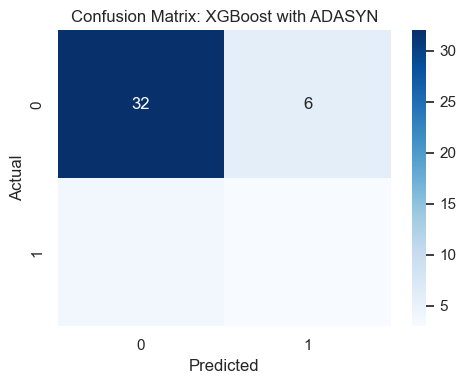

Confusion matrix saved to 'confusion_matrix_XGBoost_ADASYN.png'.



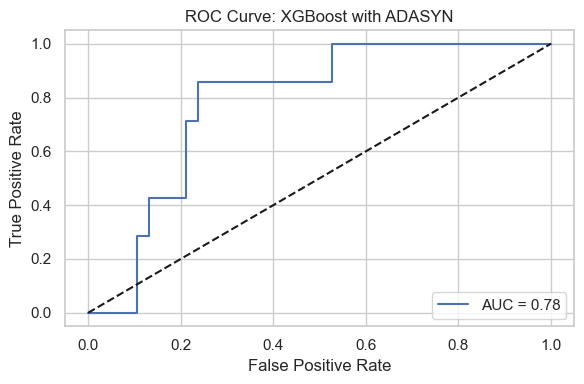

ROC curve saved to 'roc_curve_XGBoost_ADASYN.png'.


Training and tuning LightGBM with ADASYN...
[LightGBM] [Info] Number of positive: 67, number of negative: 70
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000128 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 137, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.489051 -> initscore=-0.043803
[LightGBM] [Info] Start training from score -0.043803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 67, number of negative: 70
[LightGBM] [Info] Number of positive: 68, number of negative: 70
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001006 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] N

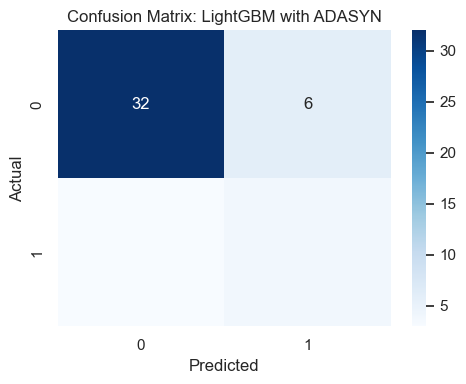

Confusion matrix saved to 'confusion_matrix_LightGBM_ADASYN.png'.



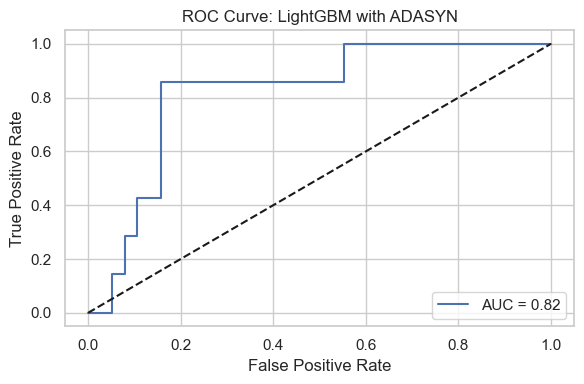

ROC curve saved to 'roc_curve_LightGBM_ADASYN.png'.


Training and tuning KNN with ADASYN...

KNN Performance with ADASYN:
Accuracy: 0.60
Precision: 0.26
Recall: 0.86
F1-Score: 0.40
AUC: 0.73


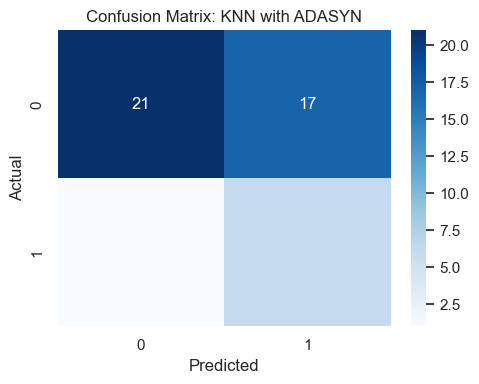

Confusion matrix saved to 'confusion_matrix_KNN_ADASYN.png'.



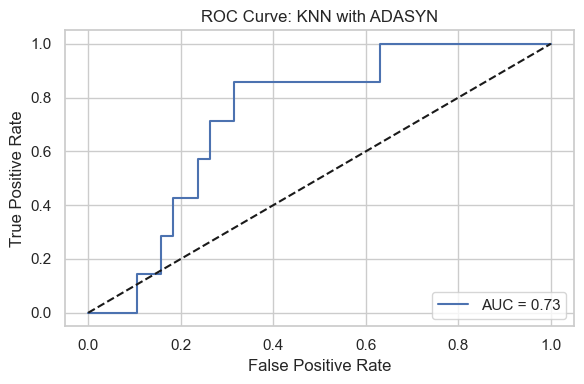

ROC curve saved to 'roc_curve_KNN_ADASYN.png'.


--- Resampling Method: SMOTEENN ---

Applied SMOTEENN. Resampled training set size: 106

Training and tuning Logistic Regression with SMOTEENN...

Logistic Regression Performance with SMOTEENN:
Accuracy: 0.38
Precision: 0.18
Recall: 0.86
F1-Score: 0.30
AUC: 0.83


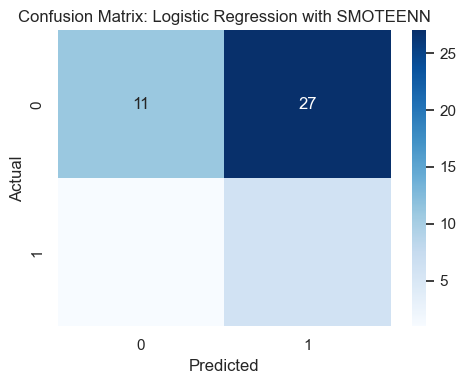

Confusion matrix saved to 'confusion_matrix_Logistic Regression_SMOTEENN.png'.



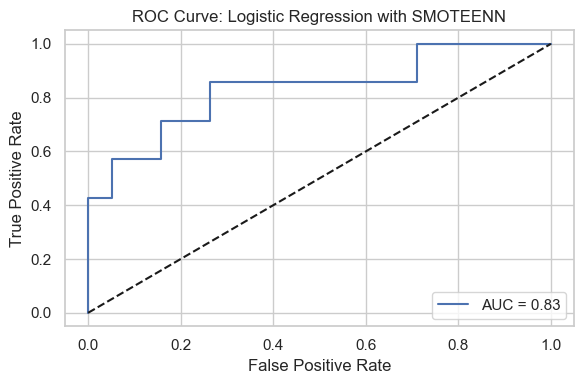

ROC curve saved to 'roc_curve_Logistic Regression_SMOTEENN.png'.


Training and tuning Decision Tree with SMOTEENN...

Decision Tree Performance with SMOTEENN:
Accuracy: 0.49
Precision: 0.19
Recall: 0.71
F1-Score: 0.30
AUC: 0.59


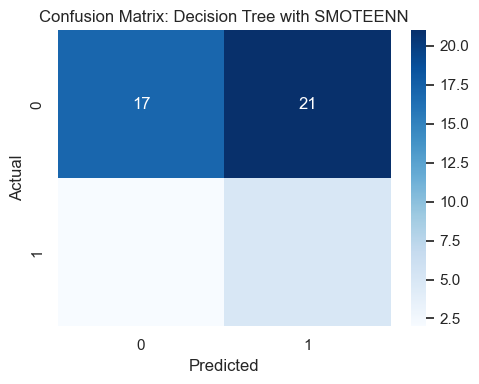

Confusion matrix saved to 'confusion_matrix_Decision Tree_SMOTEENN.png'.



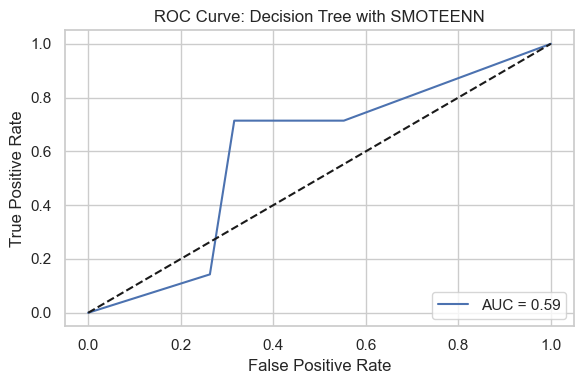

ROC curve saved to 'roc_curve_Decision Tree_SMOTEENN.png'.


Training and tuning Random Forest with SMOTEENN...

Random Forest Performance with SMOTEENN:
Accuracy: 0.62
Precision: 0.25
Recall: 0.71
F1-Score: 0.37
AUC: 0.65


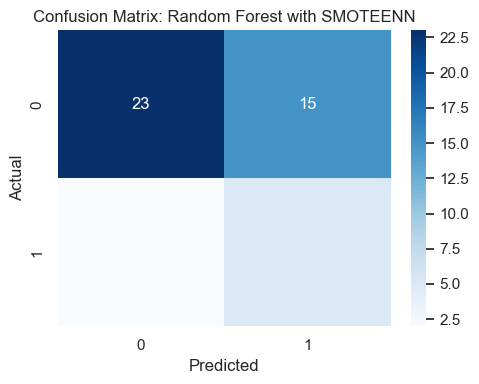

Confusion matrix saved to 'confusion_matrix_Random Forest_SMOTEENN.png'.



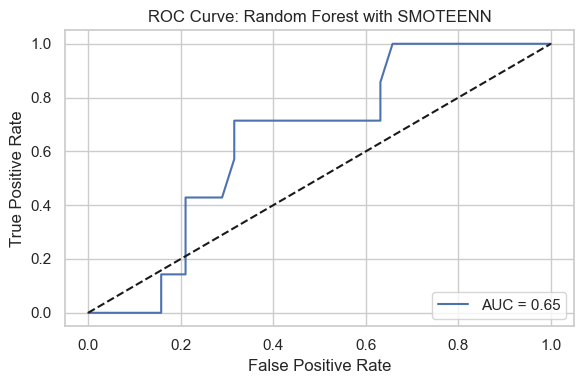

ROC curve saved to 'roc_curve_Random Forest_SMOTEENN.png'.


Training and tuning XGBoost with SMOTEENN...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:44:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:44:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:44:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:44:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with SMOTEENN:
Accuracy: 0.49
Precision: 0.19
Recall: 0.71
F1-Score: 0.30
AUC: 0.62


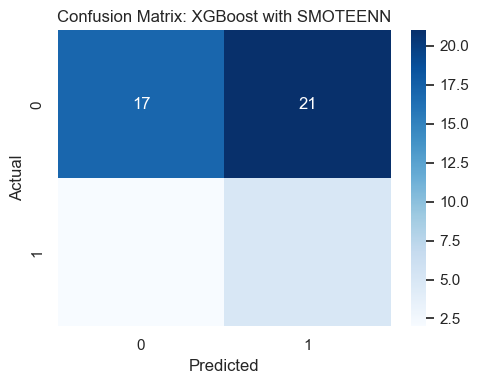

Confusion matrix saved to 'confusion_matrix_XGBoost_SMOTEENN.png'.



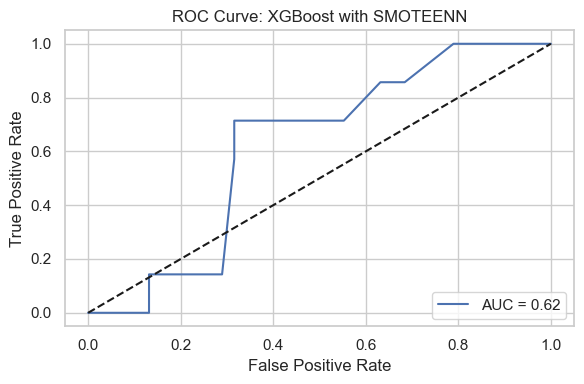

ROC curve saved to 'roc_curve_XGBoost_SMOTEENN.png'.


Training and tuning LightGBM with SMOTEENN...
[LightGBM] [Info] Number of positive: 47, number of negative: 37
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 86
[LightGBM] [Info] Number of data points in the train set: 84, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.559524 -> initscore=0.239230
[LightGBM] [Info] Start training from score 0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 48, number of negative: 37
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000680 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 89
[LightGBM]

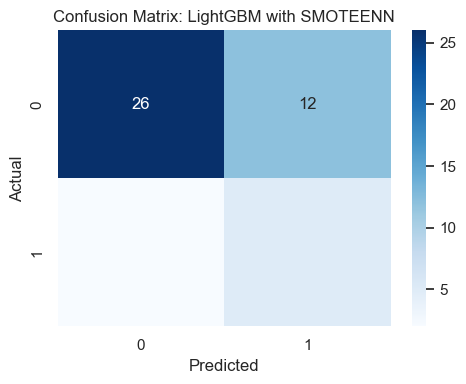

Confusion matrix saved to 'confusion_matrix_LightGBM_SMOTEENN.png'.



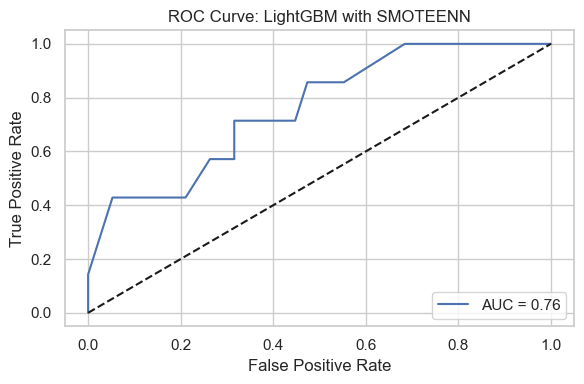

ROC curve saved to 'roc_curve_LightGBM_SMOTEENN.png'.


Training and tuning KNN with SMOTEENN...

KNN Performance with SMOTEENN:
Accuracy: 0.56
Precision: 0.22
Recall: 0.71
F1-Score: 0.33
AUC: 0.71


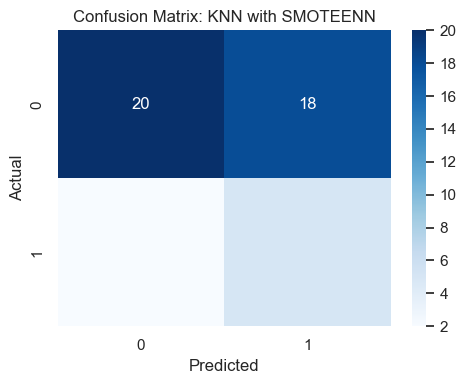

Confusion matrix saved to 'confusion_matrix_KNN_SMOTEENN.png'.



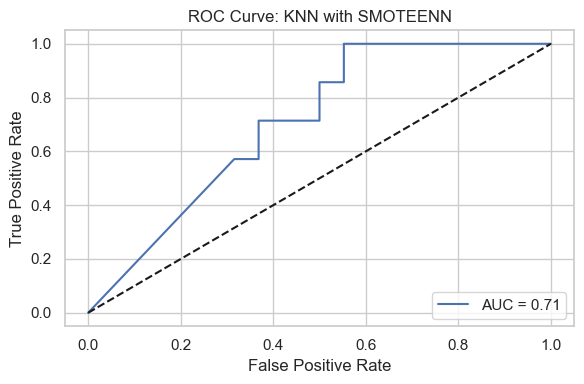

ROC curve saved to 'roc_curve_KNN_SMOTEENN.png'.


Classification Model Performance Comparison (Repayment Risk):
               Resampling                Model  Accuracy  Precision  Recall  \
2           No Resampling        Random Forest      0.87       1.00    0.14   
16   Random Over-Sampling             LightGBM      0.87       0.57    0.57   
0           No Resampling  Logistic Regression      0.84       0.00    0.00   
12   Random Over-Sampling  Logistic Regression      0.69       0.32    0.86   
24                 ADASYN  Logistic Regression      0.71       0.33    0.86   
18                  SMOTE  Logistic Regression      0.71       0.33    0.86   
14   Random Over-Sampling        Random Forest      0.89       0.62    0.71   
15   Random Over-Sampling              XGBoost      0.91       0.71    0.71   
21                  SMOTE              XGBoost      0.82       0.44    0.57   
1           No Resampling        Decision Tree      0.89       0.75    0.43   
30               S

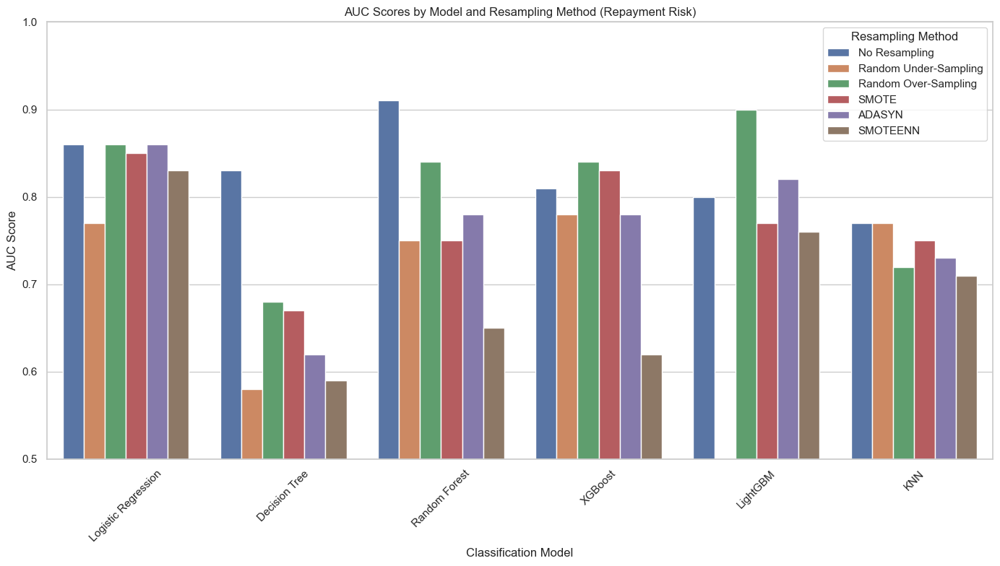

Classification AUC comparison plot saved to 'classification_auc_comparison_repayment.png'.


The best-performing classification model is **Random Forest** with **No Resampling** and an AUC of **0.91**.

Best Classification Model saved as 'best_classification_model_Random Forest_No Resampling.joblib'


Retraining the best model on the entire dataset and generating predictions for all customers...

Best model 'Random Forest_No Resampling' retrained on the entire dataset.
df_repayment_full DataFrame created and saved to 'df_repayment_full.csv'.

Sample of df_repayment_full:
  customer_id True_Repayment_Risk Predicted_Repayment_Risk  \
0       11036            Low Risk                 Low Risk   
1       11154           High Risk                High Risk   
2       11182            Low Risk                 Low Risk   
3       11185           High Risk                High Risk   
4       11244            Low Risk                 Low Risk   

   Predicted_Repayment_Probability  
0           

In [10]:
# ----------------------------
# 2. Loan Repayment Risk Model (Classification)
# ----------------------------
print("\nTraining Loan Repayment Risk Model (Classification)...\n")

# Define Target Variable
high_risk_statuses = ['Written off', 'Past due']
full_data['Repayment_Risk'] = full_data['Loan Status'].apply(lambda x: 1 if x in high_risk_statuses else 0)

required_columns = [
    'customer_id', 'Outstanding Principal', 'Qualified / Verified\nIncome', 
    'Loan Amount', 'Outstanding Balance', 'Loan Term (Months)', 'Date of Birth', 'Disbursement Date',
    'Loan Status', 'Interest Rate', 'Gender', 'Province',
    'Residential Status', 'Stated Income on application', 'Aptitude for change Score',
    'Financial Literacy Score', 'Self Assessments', 'Quiz Count', 'Mood Count',
    'Inspiration Count', 'Average total activities per month',
    'Average activities per day', 'fico_score', 'Repayment_Risk'
]

full_data = full_data[required_columns]

# Handle Zero or Missing Denominators
full_data['Qualified / Verified\nIncome'].replace(0, 1e-6, inplace=True)
full_data['Loan Term (Months)'].replace(0, 1e-6, inplace=True)

# Feature Engineering for Classification
full_data['Debt_to_Income_Ratio'] = full_data['Outstanding Principal'] / full_data['Qualified / Verified\nIncome']
full_data['Loan_to_Income_Ratio'] = full_data['Loan Amount'] / full_data['Qualified / Verified\nIncome']
full_data['Monthly_Repayment_Burden'] = full_data['Outstanding Balance'] / full_data['Loan Term (Months)']

# Drop duplicates in full_data
initial_full_data_records = full_data.shape[0]
full_data = full_data.drop_duplicates()
print(f"\nDropped {initial_full_data_records - full_data.shape[0]} duplicate records from full_data.")

# Debug: Verify 'Repayment_Risk' Creation
print("\nRepayment_Risk column created in full_data:")
print(full_data[['customer_id', 'Loan Status', 'Repayment_Risk']].head())
print("Number of high-risk loans:", full_data['Repayment_Risk'].sum())

# Prepare Data for Classification
# Ensure 'full_data_encoded' is correctly defined and contains all customer_ids
# Replace this with your actual encoding logic

# Example Placeholder for 'full_data_encoded'
# If 'full_data_encoded' is derived from 'df_engagement', ensure it contains all customer_ids
full_data_encoded = df_engagement.copy()  # Placeholder; replace with actual encoded data

# Verify 'full_data_encoded' contains all customer_ids
unique_full_data = full_data['customer_id'].nunique()
unique_full_data_encoded = full_data_encoded['customer_id'].nunique()
print(f"\nUnique customer_ids in full_data: {unique_full_data}")
print(f"Unique customer_ids in full_data_encoded: {unique_full_data_encoded}")

if unique_full_data != unique_full_data_encoded:
    missing_ids = set(full_data['customer_id']) - set(full_data_encoded['customer_id'])
    print(f"Number of missing 'customer_id's in 'full_data_encoded': {len(missing_ids)}")
    print(f"Missing 'customer_id's: {list(missing_ids)[:5]}")  # Show first 5 missing IDs
    # Investigate why these 'customer_id's are missing
else:
    print("No discrepancy: 'full_data_encoded' contains all 'customer_id's from 'full_data'.")

df_encoded = full_data_encoded.copy()

# Merge 'Repayment_Risk' into df_encoded based on 'customer_id' using left join
cis_data = df_encoded.merge(
    full_data[['customer_id', 'Repayment_Risk', 'Debt_to_Income_Ratio', 'Loan_to_Income_Ratio', 'Monthly_Repayment_Burden','fico_score']],
    on='customer_id',
    how='left',
    indicator=True
)

print(f"\nRecords after left merge: {cis_data.shape[0]}")
print(cis_data['_merge'].value_counts())

# Handle Missing 'Repayment_Risk' by imputing with 0 (Low Risk)
missing_repayment = cis_data['Repayment_Risk'].isnull().sum()
print(f"Missing 'Repayment_Risk' before imputation: {missing_repayment}")

cis_data['Repayment_Risk'].fillna(0, inplace=True)
print(f"Filled missing 'Repayment_Risk' with 0 (Low Risk). Remaining missing: {cis_data['Repayment_Risk'].isnull().sum()}")

# Drop duplicates based on 'customer_id' if necessary
duplicate_counts = cis_data['customer_id'].duplicated().sum()
print(f"\nNumber of duplicate 'customer_id's in cis_data: {duplicate_counts}")

if duplicate_counts > 0:
    print("Duplicates found. Aggregating data by 'customer_id'.")
    cis_data = cis_data.groupby('customer_id').agg({
        'Repayment_Risk': 'first',  # Assuming Repayment_Risk is consistent
        'Monthly_Repayment_Burden': 'mean',
        'fico_score': 'mean',
        'Loan_to_Income_Ratio': 'mean',
        'Debt_to_Income_Ratio': 'mean'
    }).reset_index()
    print(f"Records after aggregation: {cis_data.shape[0]}")
else:
    print("No duplicates found. Proceeding without aggregation.")

# Handle Missing and Infinite Values in Engineered Features
cis_data.replace([np.inf, -np.inf], np.nan, inplace=True)
print("\nMissing values after replacing infinities:")
print(cis_data.isnull().sum())

# Impute missing values with median
cis_data['Debt_to_Income_Ratio'].fillna(cis_data['Debt_to_Income_Ratio'].median(), inplace=True)
cis_data['Loan_to_Income_Ratio'].fillna(cis_data['Loan_to_Income_Ratio'].median(), inplace=True)
cis_data['Monthly_Repayment_Burden'].fillna(cis_data['Monthly_Repayment_Burden'].median(), inplace=True)

print("\nMissing values after imputation:")
print(cis_data.isnull().sum())

# Retain 'customer_id' and necessary features
df_encoded = cis_data[['customer_id', 'Repayment_Risk','Monthly_Repayment_Burden', 'fico_score',  'Loan_to_Income_Ratio']]
df_encoded = df_encoded.drop_duplicates()

# Define Features and Target
X_cls_repay = df_encoded[['Monthly_Repayment_Burden', 'fico_score',  'Loan_to_Income_Ratio']]
y_cls_repay = df_encoded['Repayment_Risk']

# Identify Numerical and Categorical Columns
numeric_cols_cls_repay = X_cls_repay.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_cols_cls_repay = X_cls_repay.select_dtypes(include=['object', 'category']).columns.tolist()

# Extract customer_id before splitting
customer_ids_repay = df_encoded['customer_id']

# Split Data into Training and Testing Sets, including customer_ids
X_train_cls_repay, X_test_cls_repay, y_train_cls_repay, y_test_cls_repay, train_ids_repay, test_ids_repay = train_test_split(
    X_cls_repay, y_cls_repay, customer_ids_repay, test_size=0.3, random_state=42, stratify=y_cls_repay
)
print("Data split successfully.\n")

# Preprocessing Pipelines
numeric_transformer_cls_repay = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

if categorical_cols_cls_repay:
    categorical_transformer_cls_repay = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='most_frequent')),
        ('onehot', OneHotEncoder(handle_unknown='ignore', sparse=False))
    ])
    preprocessor_cls_repay = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer_cls_repay, numeric_cols_cls_repay),
            ('cat', categorical_transformer_cls_repay, categorical_cols_cls_repay)
        ]
    )
else:
    preprocessor_cls_repay = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer_cls_repay, numeric_cols_cls_repay)
        ]
    )

# Apply Preprocessing
X_train_cls_repay_processed = preprocessor_cls_repay.fit_transform(X_train_cls_repay)
X_test_cls_repay_processed = preprocessor_cls_repay.transform(X_test_cls_repay)

# **Save the preprocessor_cls**
joblib.dump(preprocessor_cls_repay, os.path.join(OUTPUT_DIR, 'preprocessor_cls_repay.joblib'))
print("Preprocessor for repayment model saved as 'preprocessor_cls_repay.joblib'\n")

# Define Resampling Methods
resampling_methods_cls_repay = {
    'No Resampling': None,
    'Random Under-Sampling': RandomUnderSampler(random_state=42),
    'Random Over-Sampling': RandomOverSampler(random_state=42),
    'SMOTE': SMOTE(random_state=42),
    'ADASYN': ADASYN(random_state=42),
    'SMOTEENN': SMOTEENN(random_state=42)
}

# Define Classification Models and Hyperparameters
classification_models_repay = {
    'Logistic Regression': {
        'model': LogisticRegression(random_state=42, max_iter=1000),
        'params': {
            'C': [0.01, 0.1, 1, 10],
            'penalty': ['l2'],
            'solver': ['lbfgs']
        }
    },
    'Decision Tree': {
        'model': DecisionTreeClassifier(random_state=42),
        'params': {
            'max_depth': [None, 5, 10],
            'min_samples_split': [2, 5, 10]
        }
    },
    'Random Forest': {
        'model': RandomForestClassifier(random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [None, 5, 10],
            'min_samples_split': [2, 5, 10]
        }
    },
    'XGBoost': {
        'model': xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [3, 5, 7],
            'learning_rate': [0.01, 0.1, 0.2]
        }
    },
    'LightGBM': {
        'model': lgb.LGBMClassifier(random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [-1, 5, 10],
            'learning_rate': [0.01, 0.1, 0.2]
        }
    },
    'KNN': {
        'model': KNeighborsClassifier(),
        'params': {
            'n_neighbors': [3, 5, 7],
            'weights': ['uniform', 'distance']
        }
    }
}

# Function to Tune Models Using GridSearchCV
def tune_model_cls(model, param_grid, X_train, y_train):
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        scoring='roc_auc',
        cv=5,
        n_jobs=-1
    )
    grid_search.fit(X_train, y_train)
    return grid_search.best_estimator_, grid_search.best_params_

# Dictionary to Store Best Models
best_models_dict_repay = {}

# List to Store Classification Performance Metrics
classification_performance_repay = []

# Iterate Over Each Resampling Method
for resample_name, resampler in resampling_methods_cls_repay.items():
    print(f"\n--- Resampling Method: {resample_name} ---\n")
    
    # Apply Resampling if Not 'No Resampling'
    if resampler is not None:
        X_train_resampled_repay, y_train_resampled_repay = resampler.fit_resample(X_train_cls_repay_processed, y_train_cls_repay)
        print(f"Applied {resample_name}. Resampled training set size: {X_train_resampled_repay.shape[0]}")
    else:
        X_train_resampled_repay, y_train_resampled_repay = X_train_cls_repay_processed, y_train_cls_repay
        print(f"No resampling applied. Training set size remains: {X_train_resampled_repay.shape[0]}")
    
    # Iterate Over Each Classification Model
    for model_name, model_info in classification_models_repay.items():
        model = model_info['model']
        param_grid = model_info['params']
        
        print(f"\nTraining and tuning {model_name} with {resample_name}...")
        best_model_repay, best_params_repay = tune_model_cls(model, param_grid, X_train_resampled_repay, y_train_resampled_repay)
        
        # Store the best model in the dictionary with a unique key
        key_repay = f"{model_name}_{resample_name}"
        best_models_dict_repay[key_repay] = best_model_repay
        
        # Predict on Test Data
        y_pred_repay = best_model_repay.predict(X_test_cls_repay_processed)
        
        # Predict Probabilities for AUC
        if hasattr(best_model_repay, "predict_proba"):
            y_prob_repay = best_model_repay.predict_proba(X_test_cls_repay_processed)[:, 1]
        else:
            y_prob_repay = best_model_repay.decision_function(X_test_cls_repay_processed)
            y_prob_repay = (y_prob_repay - y_prob_repay.min()) / (y_prob_repay.max() - y_prob_repay.min())  # Normalize to [0,1]
        
        # Calculate Metrics
        acc_repay = accuracy_score(y_test_cls_repay, y_pred_repay)
        prec_repay = precision_score(y_test_cls_repay, y_pred_repay, zero_division=0)
        rec_repay = recall_score(y_test_cls_repay, y_pred_repay, zero_division=0)
        f1_repay = f1_score(y_test_cls_repay, y_pred_repay, zero_division=0)
        auc_repay = roc_auc_score(y_test_cls_repay, y_prob_repay)
        
        # Store Metrics
        classification_performance_repay.append({
            'Resampling': resample_name,
            'Model': model_name,
            'Accuracy': round(acc_repay, 2),
            'Precision': round(prec_repay, 2),
            'Recall': round(rec_repay, 2),
            'F1-Score': round(f1_repay, 2),
            'AUC': round(auc_repay, 2),
            'Best_Params': best_params_repay  # Store best hyperparameters
        })
        
        # Print Metrics
        print(f"\n{model_name} Performance with {resample_name}:")
        print(f"Accuracy: {acc_repay:.2f}")
        print(f"Precision: {prec_repay:.2f}")
        print(f"Recall: {rec_repay:.2f}")
        print(f"F1-Score: {f1_repay:.2f}")
        print(f"AUC: {auc_repay:.2f}")
        
        # Optional: Plot Confusion Matrix and ROC Curve
        # Confusion Matrix
        cm_repay = confusion_matrix(y_test_cls_repay, y_pred_repay)
        plt.figure(figsize=(5,4))
        sns.heatmap(cm_repay, annot=True, fmt='d', cmap='Blues')
        plt.title(f'Confusion Matrix: {model_name} with {resample_name}')
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.tight_layout()
        plt.savefig(os.path.join(OUTPUT_DIR, f'confusion_matrix_{model_name}_{resample_name}.png'))
        plt.show()
        print(f"Confusion matrix saved to 'confusion_matrix_{model_name}_{resample_name}.png'.\n")
        
        # ROC Curve
        fpr_repay, tpr_repay, thresholds_repay = roc_curve(y_test_cls_repay, y_prob_repay)
        plt.figure(figsize=(6,4))
        plt.plot(fpr_repay, tpr_repay, label=f'AUC = {auc_repay:.2f}')
        plt.plot([0,1], [0,1], 'k--')
        plt.title(f'ROC Curve: {model_name} with {resample_name}')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend(loc='lower right')
        plt.tight_layout()
        plt.savefig(os.path.join(OUTPUT_DIR, f'roc_curve_{model_name}_{resample_name}.png'))
        plt.show()
        print(f"ROC curve saved to 'roc_curve_{model_name}_{resample_name}.png'.\n")

# Convert Classification Performance to DataFrame
classification_performance_repay_df = pd.DataFrame(classification_performance_repay)
print("\nClassification Model Performance Comparison (Repayment Risk):")
print(classification_performance_repay_df.sort_values(by='AUC', ascending=False))

# Save Classification Performance
classification_performance_repay_df.to_csv(os.path.join(OUTPUT_DIR, 'classification_performance_repayment.csv'), index=False)
print("\nClassification performance metrics saved to 'classification_performance_repayment.csv'.\n")

# Visualize Classification Performance (AUC Scores)
plt.figure(figsize=(14, 8))
sns.barplot(
    data=classification_performance_repay_df,
    x='Model',
    y='AUC',
    hue='Resampling'
)
plt.title('AUC Scores by Model and Resampling Method (Repayment Risk)')
plt.xlabel('Classification Model')
plt.ylabel('AUC Score')
plt.legend(title='Resampling Method')
plt.xticks(rotation=45)
plt.ylim(0.5, 1.0)
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, 'classification_auc_comparison_repayment.png'))
plt.show()
print("Classification AUC comparison plot saved to 'classification_auc_comparison_repayment.png'.\n")

# Identify Best Classification Model Based on AUC
best_performance_repay = classification_performance_repay_df.loc[classification_performance_repay_df['AUC'].idxmax()]
best_model_name_repay = best_performance_repay['Model']
best_resampling_repay = best_performance_repay['Resampling']
best_auc_repay = best_performance_repay['AUC']

print(f"\nThe best-performing classification model is **{best_model_name_repay}** with **{best_resampling_repay}** and an AUC of **{best_auc_repay}**.\n")

# Retrieve and Save the Best Classification Model
best_model_key_repay = f"{best_model_name_repay}_{best_resampling_repay}"
best_classification_model_repay = best_models_dict_repay.get(best_model_key_repay)

if best_classification_model_repay is not None:
    joblib.dump(best_classification_model_repay, os.path.join(OUTPUT_DIR, f'best_classification_model_{best_model_key_repay}.joblib'))
    print(f"Best Classification Model saved as 'best_classification_model_{best_model_key_repay}.joblib'\n")
else:
    print(f"Error: Best model '{best_model_key_repay}' not found in the trained models dictionary.\n")

# ----------------------------
# Retrain Best Model on Entire Dataset and Predict for All Customers
# ----------------------------

print("\nRetraining the best model on the entire dataset and generating predictions for all customers...\n")

# Preprocess the entire dataset
X_full_processed = preprocessor_cls_repay.fit_transform(X_cls_repay)

# Retrain the best model on the entire dataset
best_classification_model_repay.fit(X_full_processed, y_cls_repay)
print(f"Best model '{best_model_key_repay}' retrained on the entire dataset.")

# Predict probabilities and labels for all customers
y_full_pred_proba = best_classification_model_repay.predict_proba(X_full_processed)[:, 1]
y_full_pred = best_classification_model_repay.predict(X_full_processed)

# Create df_repayment_full DataFrame
df_repayment_full = pd.DataFrame({
    'customer_id': df_encoded['customer_id'].values,
    'True_Repayment_Risk': y_cls_repay.values,
    'Predicted_Repayment_Risk': y_full_pred,
    'Predicted_Repayment_Probability': y_full_pred_proba
})

# Map numerical labels to categorical labels
repayment_risk_mapping = {0: 'Low Risk', 1: 'High Risk'}
df_repayment_full['True_Repayment_Risk'] = df_repayment_full['True_Repayment_Risk'].map(repayment_risk_mapping)
df_repayment_full['Predicted_Repayment_Risk'] = df_repayment_full['Predicted_Repayment_Risk'].map(repayment_risk_mapping)

# Save df_repayment_full to CSV
df_repayment_full.to_csv(os.path.join(OUTPUT_DIR, 'df_repayment_full.csv'), index=False)
print("df_repayment_full DataFrame created and saved to 'df_repayment_full.csv'.\n")

# Display the first few rows
print("Sample of df_repayment_full:")
print(df_repayment_full.head())


Training Loan Repayment Risk Model (Classification)...

Data loaded and merged successfully.


--- Feature Engineering and Preprocessing ---

Deriving 'Repayment_Risk' feature...
Repayment_Risk feature created based on 'Loan Status' and new ratio features engineered.

Counts of 'Repayment_Risk' in the entire dataset:
Repayment_Risk
0    151
1     37
Name: count, dtype: int64


Unique values in 'Repayment_Risk': [0 1]


Mapped 'Repayment_Risk' to categorical labels.

Counts of 'Repayment_Risk_Label' in the entire dataset:
Repayment_Risk_Label
Low     151
High     37
Name: count, dtype: int64


Preprocessing data...
Selected Numeric Columns: ['Monthly_Repayment_Burden', 'fico_score', 'Loan_to_Income_Ratio']
Selected Categorical Columns: []


Splitting data into training and testing sets...
Data split successfully.

Unique values in y_train: [0 1]



--- Exploratory Data Analysis (EDA) ---

1. Dataset Information:
<class 'pandas.core.frame.DataFrame'>
Index: 188 entries, 0 to 2057
Data c

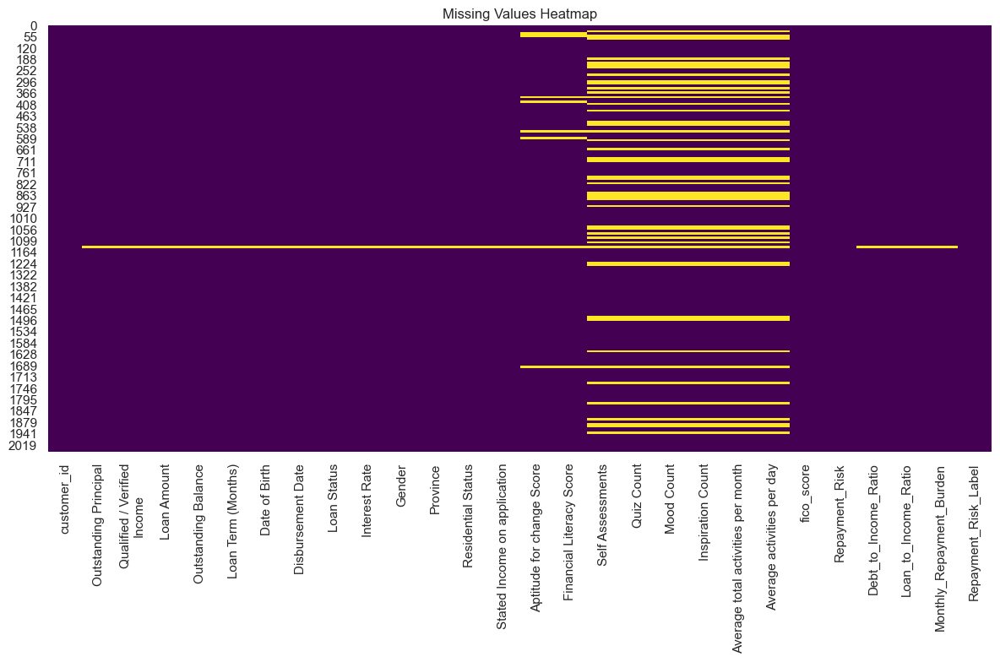

Missing values heatmap displayed.

4. Additional EDA Steps:



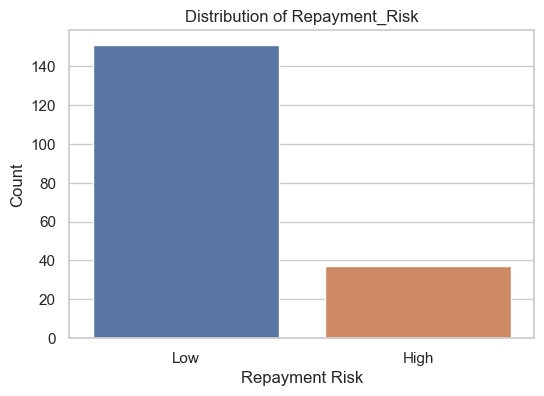

Generating Correlation Heatmap using Numerical Columns...


Handling NaN values in 'Outstanding Principal' after conversion:

Handling NaN values in 'Qualified / Verified
Income' after conversion:

Handling NaN values in 'Loan Amount' after conversion:

Handling NaN values in 'Outstanding Balance' after conversion:

Handling NaN values in 'Loan Term (Months)' after conversion:

Handling NaN values in 'Interest Rate' after conversion:

Handling NaN values in 'Stated Income on application' after conversion:

Handling NaN values in 'Aptitude for change Score' after conversion:

Handling NaN values in 'Financial Literacy Score' after conversion:

Handling NaN values in 'Self Assessments' after conversion:

Handling NaN values in 'Quiz Count' after conversion:

Handling NaN values in 'Mood Count' after conversion:

Handling NaN values in 'Inspiration Count' after conversion:

Handling NaN values in 'Average total activities per month' after conversion:

Handling NaN values in 'Average activ

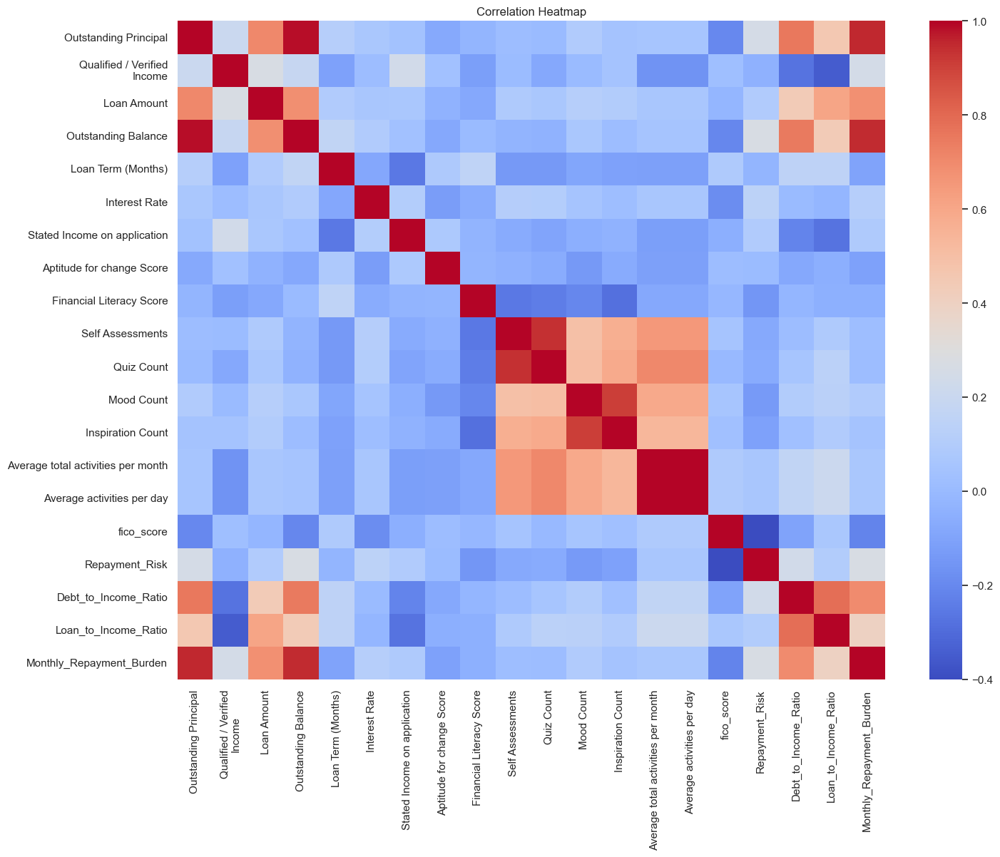

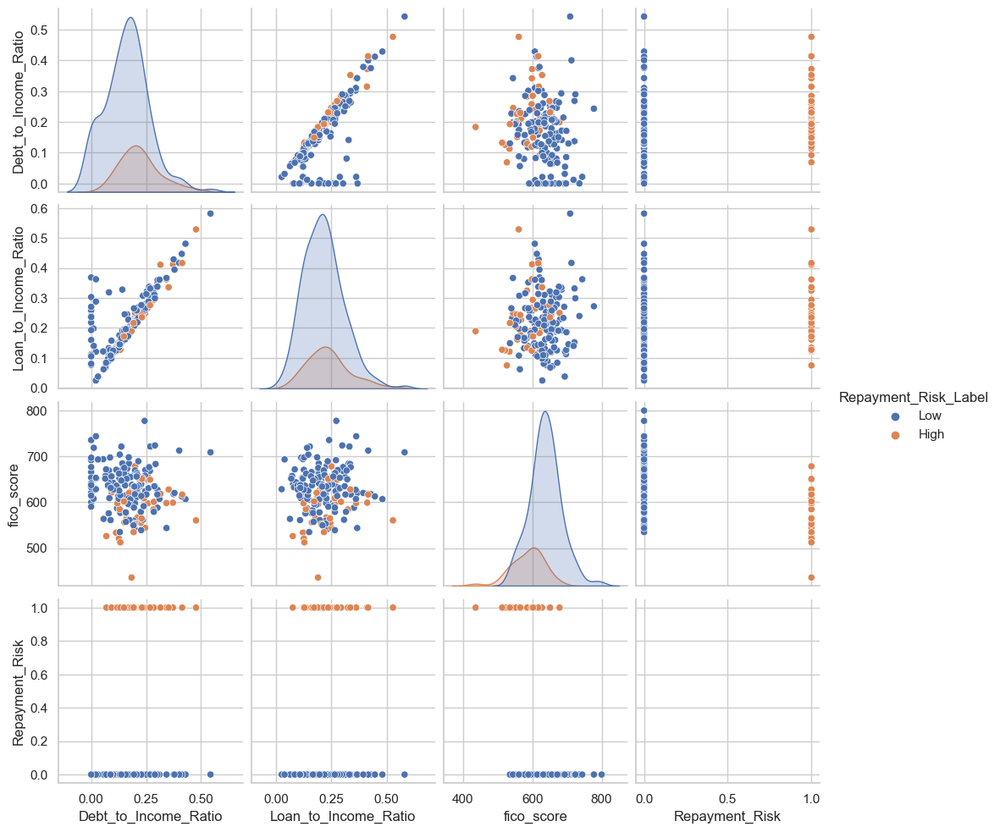

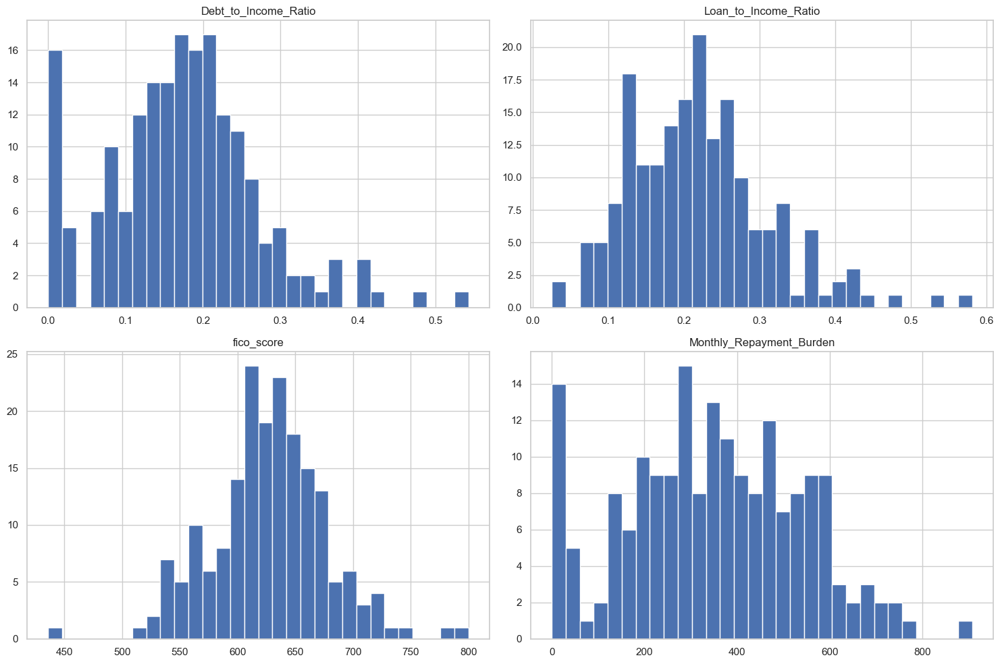

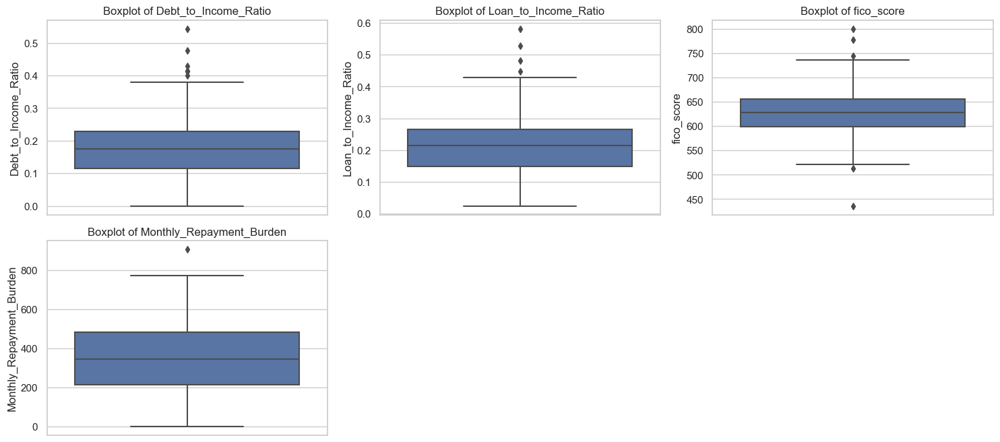

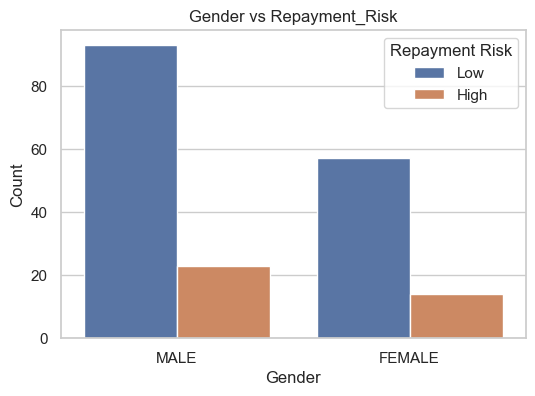

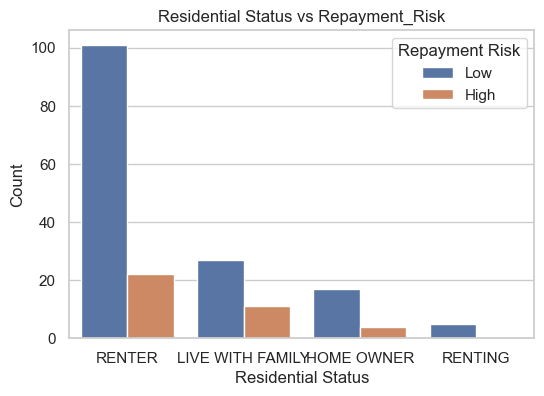

Additional EDA completed.


--- Preprocessing the Data Before Resampling ---

Preprocessing pipelines defined successfully.

Fitting the preprocessor and transforming the data...
Data preprocessing completed.

Feature Names after Preprocessing:
['Monthly_Repayment_Burden', 'fico_score', 'Loan_to_Income_Ratio']



--- Defining Resampling Methods ---

Resampling methods defined:

- No Resampling
- Random Under-Sampling
- Random Over-Sampling
- SMOTE
- ADASYN
- SMOTEENN



--- Initializing and Training Classification Models ---


--- Resampling Method: No Resampling ---

No resampling applied. Training set size remains: 131

Training and tuning Logistic Regression with No Resampling...

Logistic Regression Performance with No Resampling:
Accuracy: 0.82
Precision: 0.67
Recall: 0.18
F1-Score: 0.29
AUC: 0.86


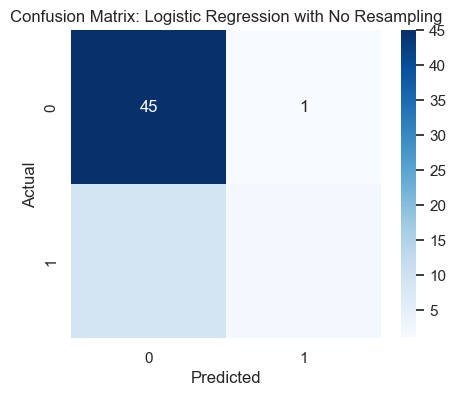

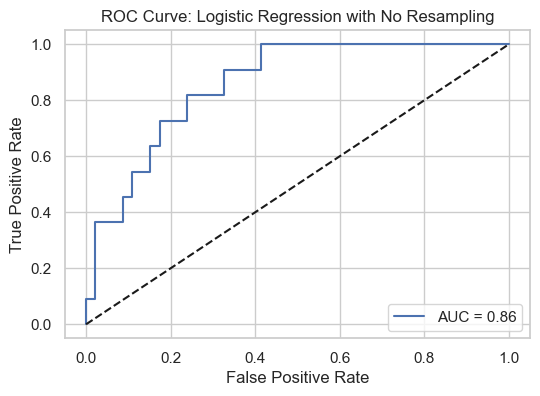


Training and tuning Decision Tree with No Resampling...

Decision Tree Performance with No Resampling:
Accuracy: 0.74
Precision: 0.25
Recall: 0.18
F1-Score: 0.21
AUC: 0.57


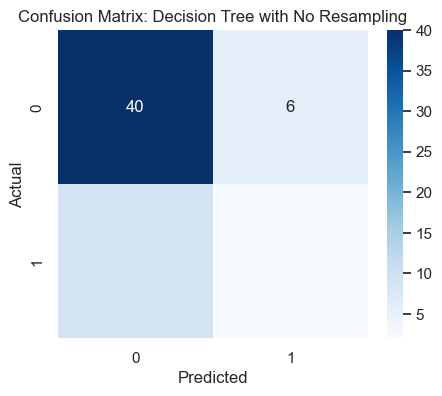

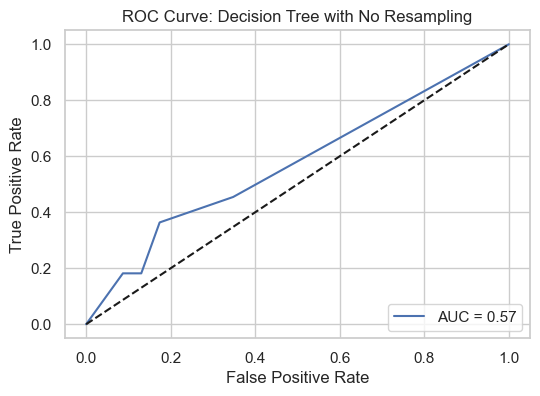


Training and tuning Random Forest with No Resampling...

Random Forest Performance with No Resampling:
Accuracy: 0.86
Precision: 1.00
Recall: 0.27
F1-Score: 0.43
AUC: 0.77


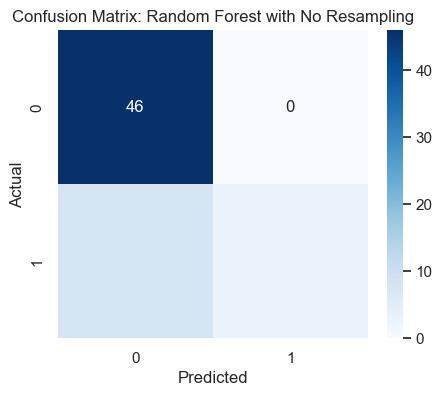

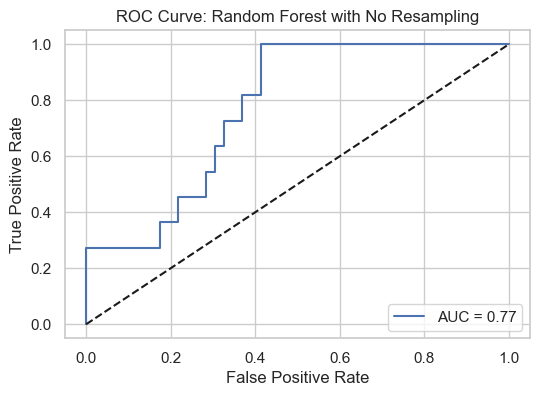


Training and tuning XGBoost with No Resampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:01] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:01] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:01] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:01] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with No Resampling:
Accuracy: 0.82
Precision: 1.00
Recall: 0.09
F1-Score: 0.17
AUC: 0.70


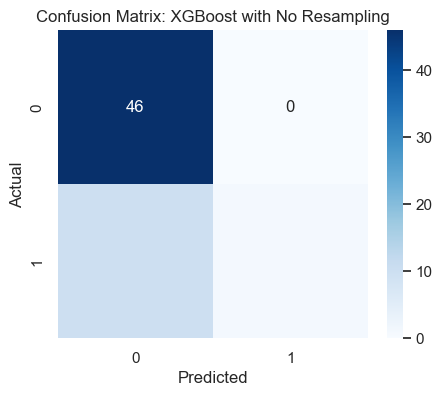

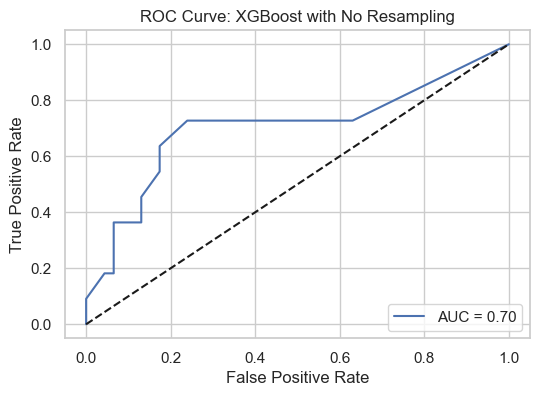


Training and tuning LightGBM with No Resampling...
[LightGBM] [Info] Number of positive: 20, number of negative: 84
[LightGBM] [Info] Number of positive: 21, number of negative: 84
[LightGBM] [Info] Number of positive: 21, number of negative: 84
[LightGBM] [Info] Number of positive: 20, number of negative: 84
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002751 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002329 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Number of positive: 21, number of negative: 84[LightGBM] [Info] Total Bins 108

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 108
[LightGBM] [Info] Number of data point

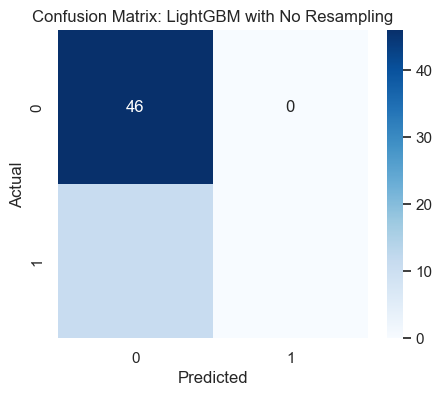

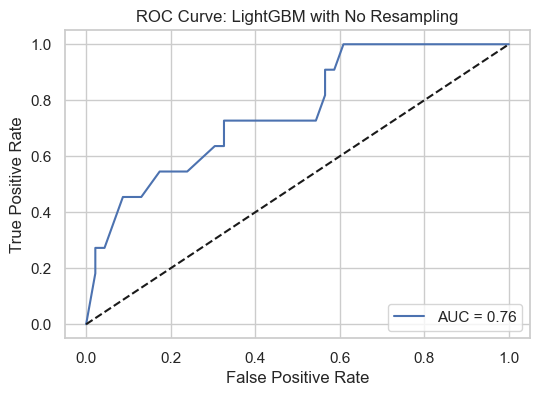


Training and tuning KNN with No Resampling...

KNN Performance with No Resampling:
Accuracy: 0.82
Precision: 1.00
Recall: 0.09
F1-Score: 0.17
AUC: 0.73


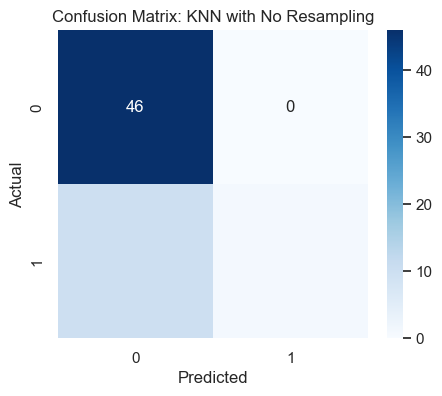

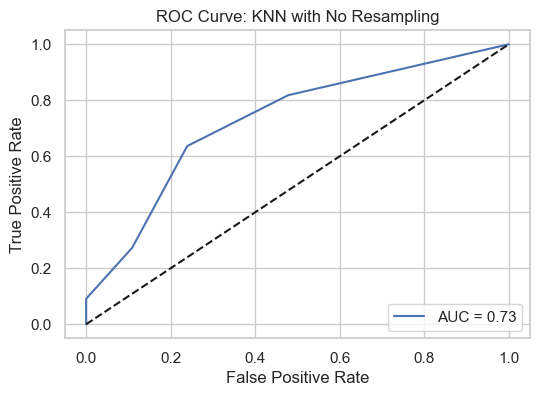


--- Resampling Method: Random Under-Sampling ---

Applied Random Under-Sampling. Resampled training set size: 52

Training and tuning Logistic Regression with Random Under-Sampling...

Logistic Regression Performance with Random Under-Sampling:
Accuracy: 0.75
Precision: 0.42
Recall: 0.73
F1-Score: 0.53
AUC: 0.84


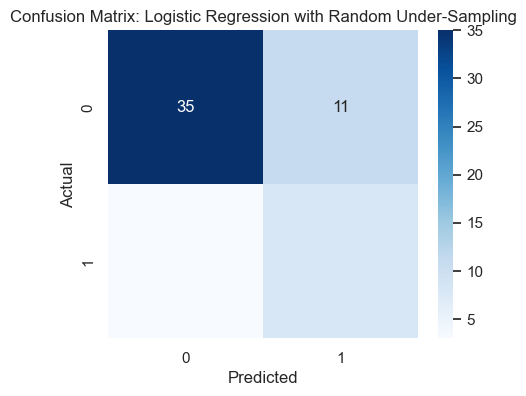

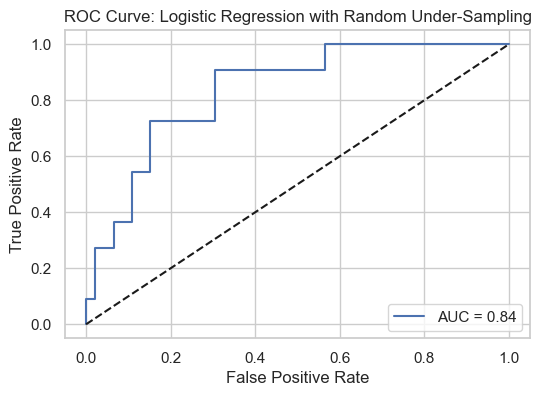


Training and tuning Decision Tree with Random Under-Sampling...

Decision Tree Performance with Random Under-Sampling:
Accuracy: 0.72
Precision: 0.37
Recall: 0.64
F1-Score: 0.47
AUC: 0.70


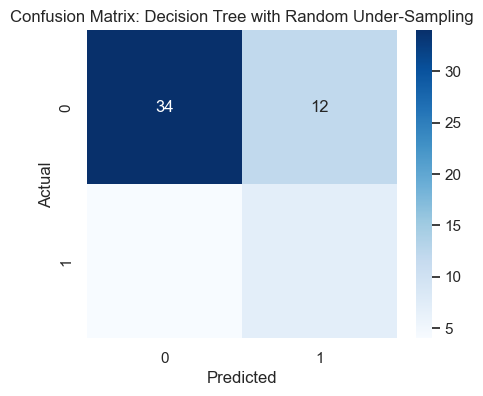

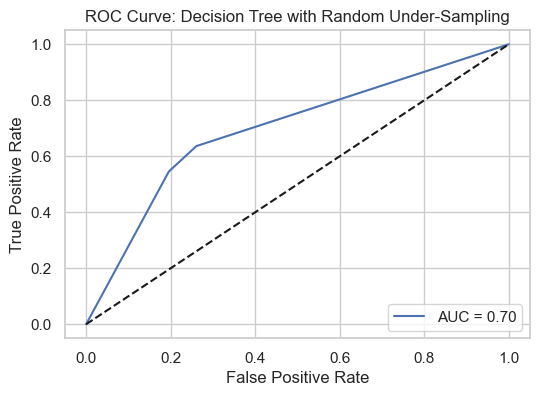


Training and tuning Random Forest with Random Under-Sampling...

Random Forest Performance with Random Under-Sampling:
Accuracy: 0.67
Precision: 0.33
Recall: 0.73
F1-Score: 0.46
AUC: 0.76


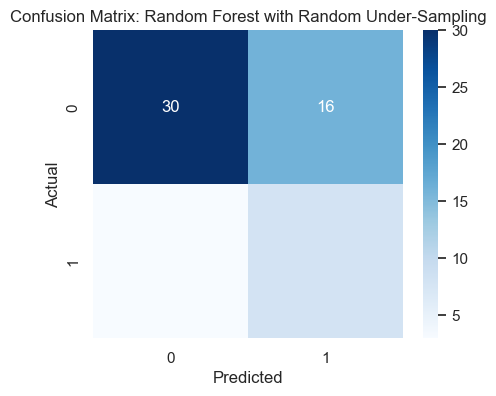

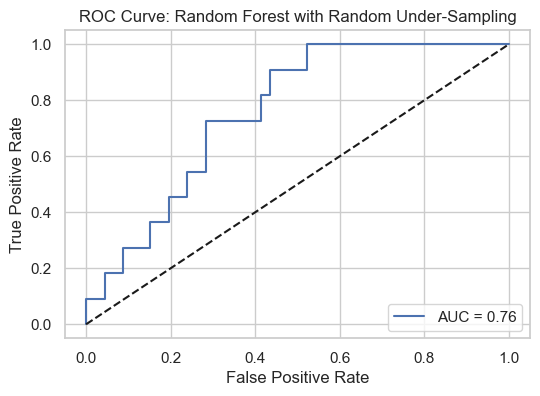


Training and tuning XGBoost with Random Under-Sampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:18] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:18] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:18] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:18] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with Random Under-Sampling:
Accuracy: 0.61
Precision: 0.28
Recall: 0.64
F1-Score: 0.39
AUC: 0.68


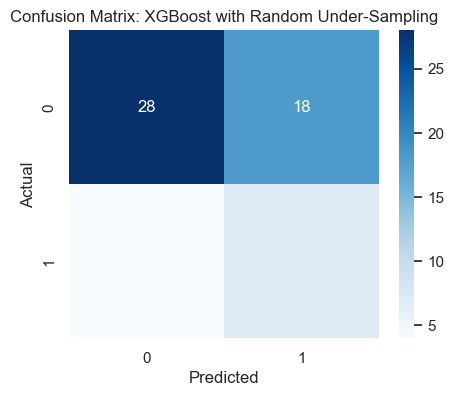

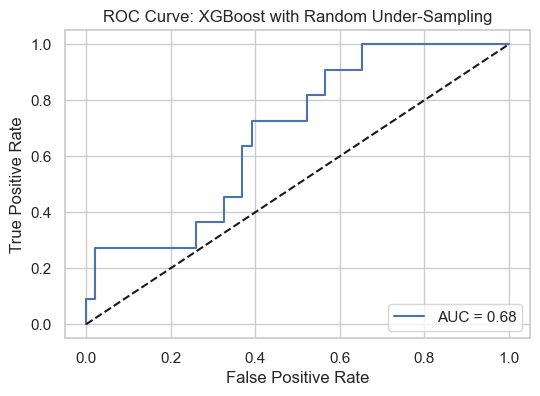


Training and tuning LightGBM with Random Under-Sampling...
[LightGBM] [Info] Number of positive: 21, number of negative: 20
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 30
[LightGBM] [Info] Number of data points in the train set: 41, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

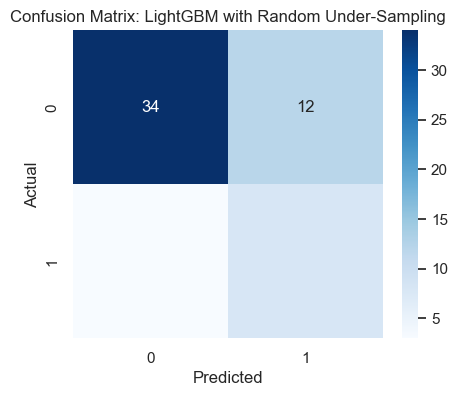

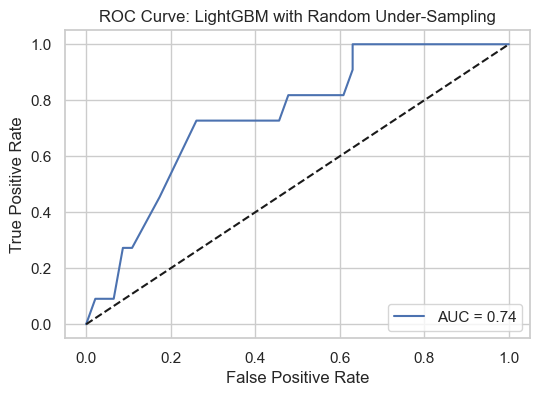


Training and tuning KNN with Random Under-Sampling...

KNN Performance with Random Under-Sampling:
Accuracy: 0.72
Precision: 0.38
Recall: 0.73
F1-Score: 0.50
AUC: 0.79


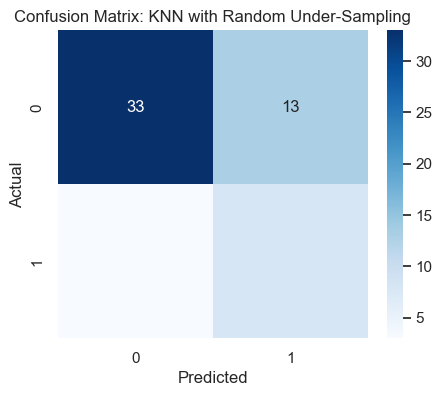

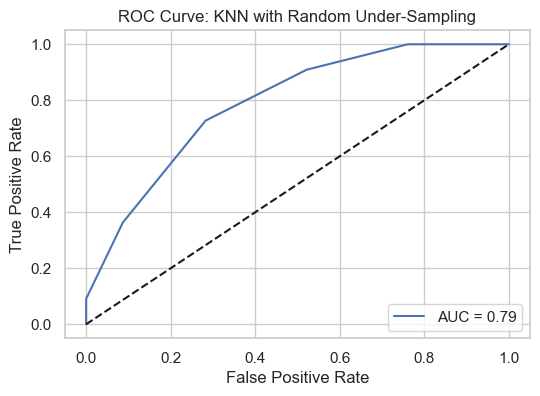


--- Resampling Method: Random Over-Sampling ---

Applied Random Over-Sampling. Resampled training set size: 210

Training and tuning Logistic Regression with Random Over-Sampling...

Logistic Regression Performance with Random Over-Sampling:
Accuracy: 0.72
Precision: 0.38
Recall: 0.73
F1-Score: 0.50
AUC: 0.85


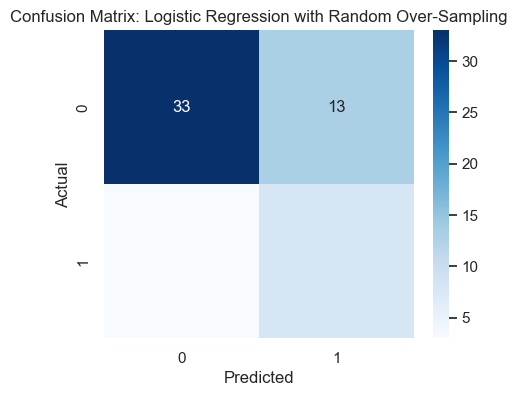

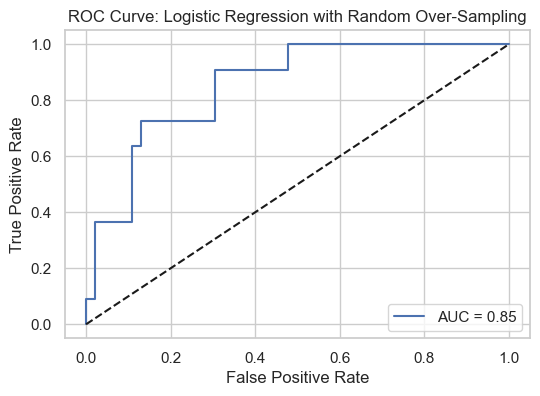


Training and tuning Decision Tree with Random Over-Sampling...

Decision Tree Performance with Random Over-Sampling:
Accuracy: 0.74
Precision: 0.36
Recall: 0.45
F1-Score: 0.40
AUC: 0.63


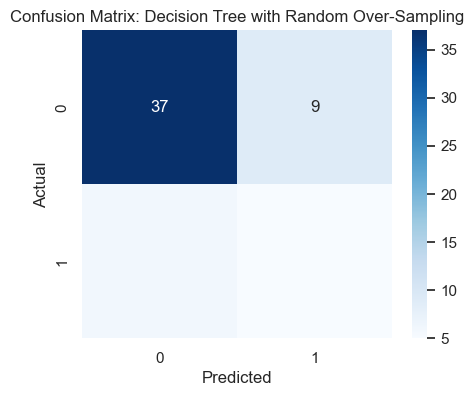

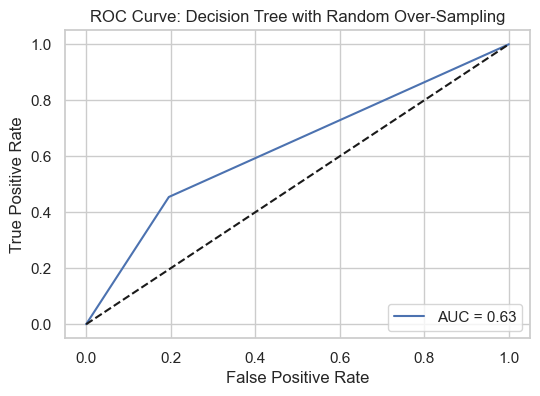


Training and tuning Random Forest with Random Over-Sampling...

Random Forest Performance with Random Over-Sampling:
Accuracy: 0.77
Precision: 0.38
Recall: 0.27
F1-Score: 0.32
AUC: 0.77


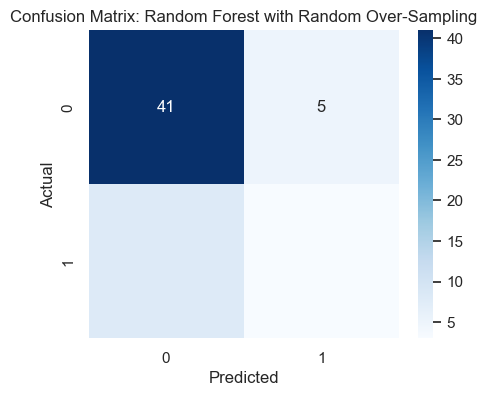

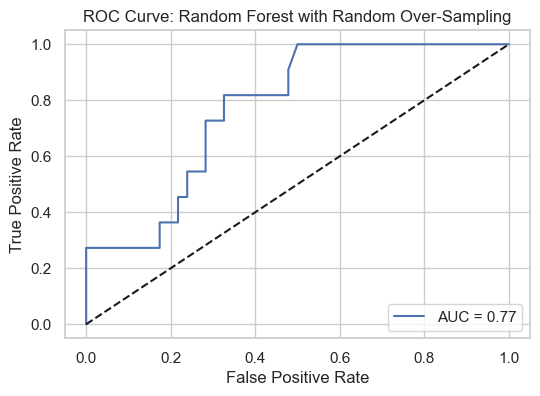


Training and tuning XGBoost with Random Over-Sampling...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:28] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:28] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:28] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:28] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with Random Over-Sampling:
Accuracy: 0.70
Precision: 0.25
Recall: 0.27
F1-Score: 0.26
AUC: 0.77


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:28] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


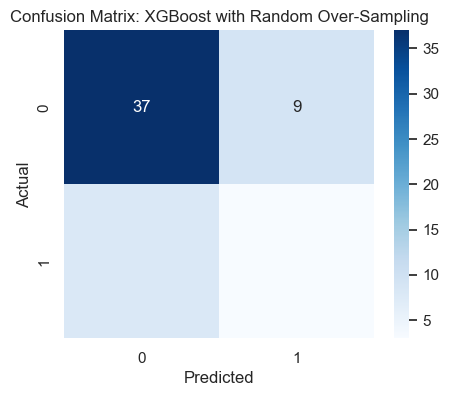

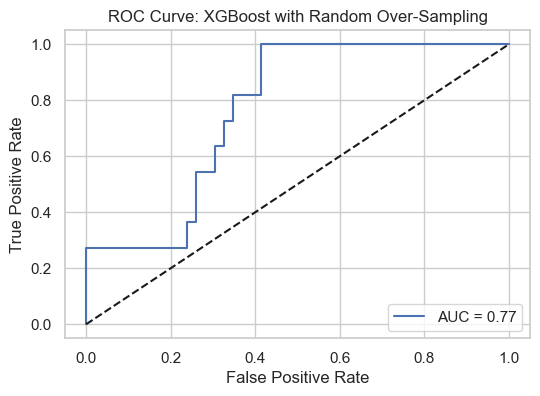


Training and tuning LightGBM with Random Over-Sampling...
[LightGBM] [Info] Number of positive: 84, number of negative: 84
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 132
[LightGBM] [Info] Number of data points in the train set: 168, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of positive: 84, number of negative: 84
[LightGBM] [Info] Number of positive: 84, number of negative: 84
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 138
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002483 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total B

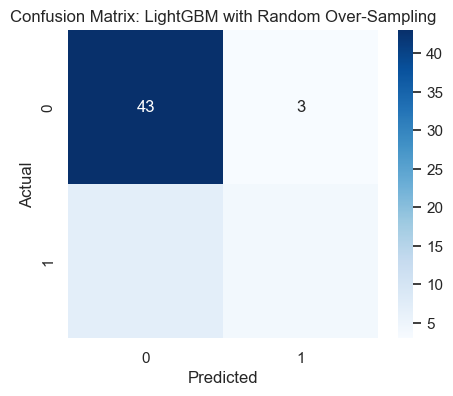

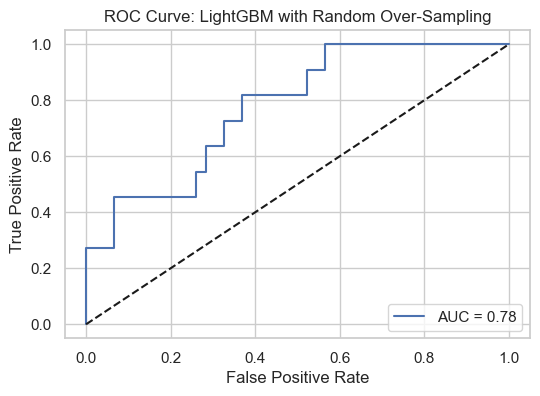


Training and tuning KNN with Random Over-Sampling...

KNN Performance with Random Over-Sampling:
Accuracy: 0.70
Precision: 0.36
Recall: 0.73
F1-Score: 0.48
AUC: 0.75


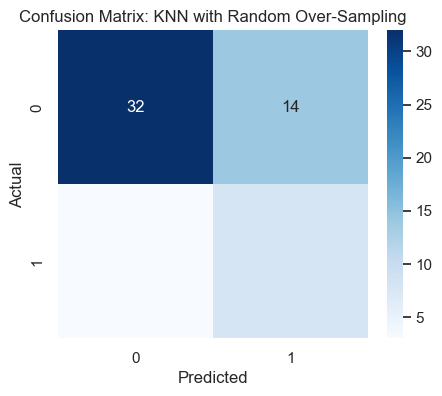

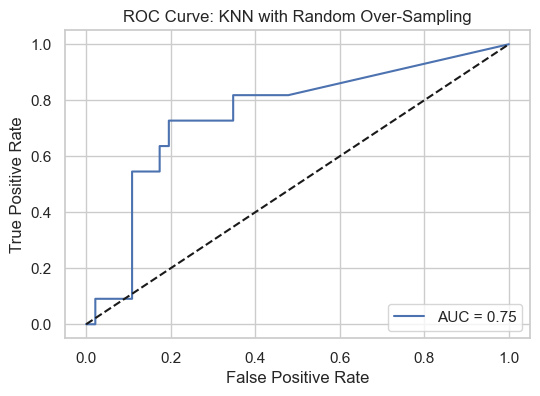


--- Resampling Method: SMOTE ---

Applied SMOTE. Resampled training set size: 210

Training and tuning Logistic Regression with SMOTE...

Logistic Regression Performance with SMOTE:
Accuracy: 0.74
Precision: 0.40
Recall: 0.73
F1-Score: 0.52
AUC: 0.85


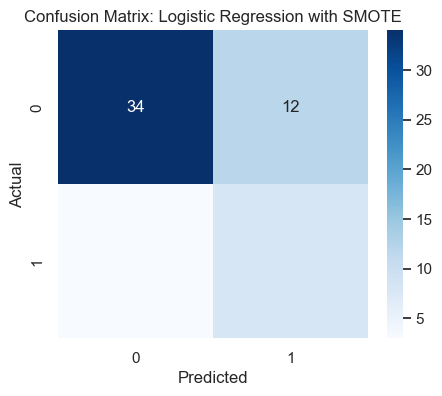

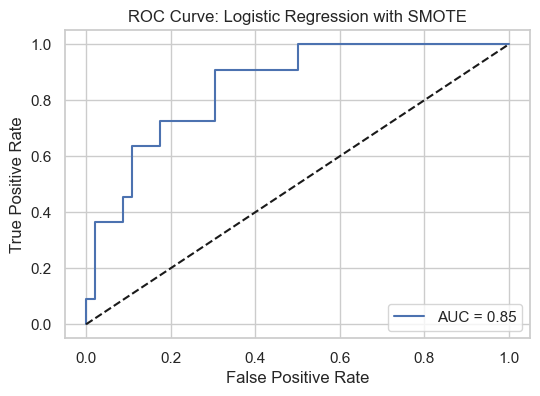


Training and tuning Decision Tree with SMOTE...

Decision Tree Performance with SMOTE:
Accuracy: 0.74
Precision: 0.33
Recall: 0.36
F1-Score: 0.35
AUC: 0.58


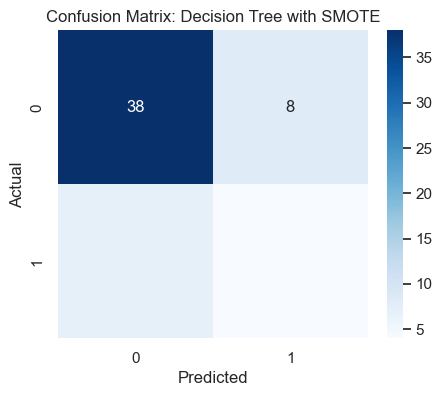

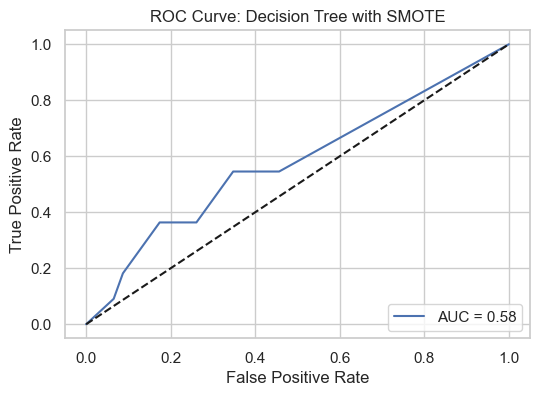


Training and tuning Random Forest with SMOTE...

Random Forest Performance with SMOTE:
Accuracy: 0.70
Precision: 0.31
Recall: 0.45
F1-Score: 0.37
AUC: 0.75


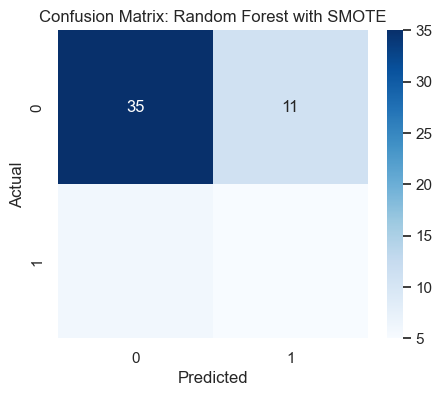

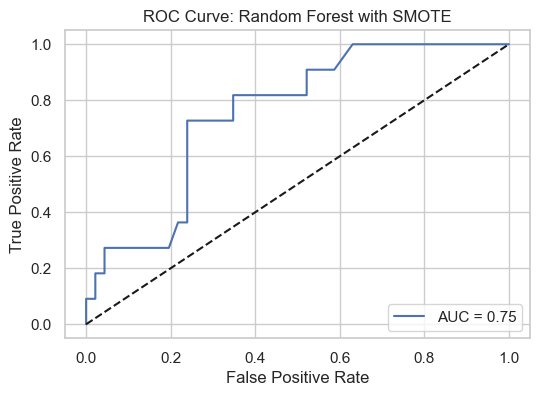


Training and tuning XGBoost with SMOTE...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:58:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with SMOTE:
Accuracy: 0.74
Precision: 0.33
Recall: 0.36
F1-Score: 0.35
AUC: 0.78


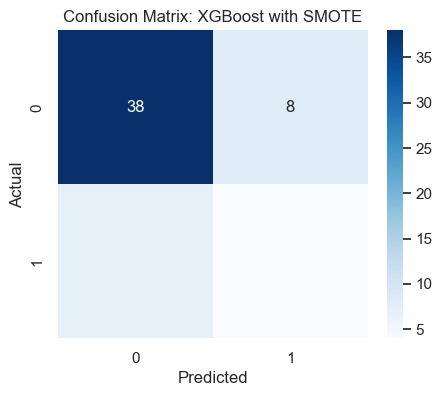

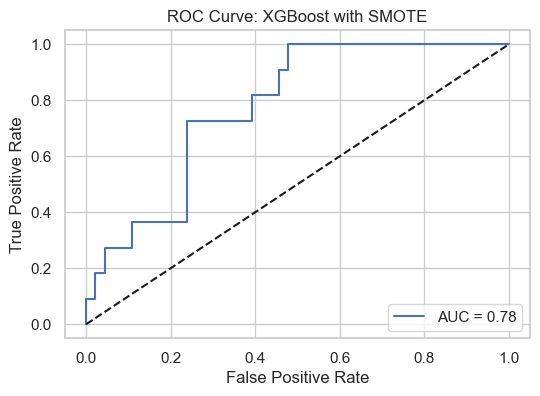


Training and tuning LightGBM with SMOTE...
[LightGBM] [Info] Number of positive: 84, number of negative: 84
[LightGBM] [Info] Number of positive: 84, number of negative: 84
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 170
[LightGBM] [Info] Number of data points in the train set: 168, number of used features: 3
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001065 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 170
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of data points in the train set: 168, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further sp

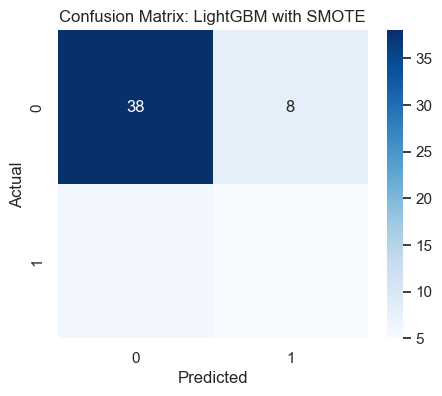

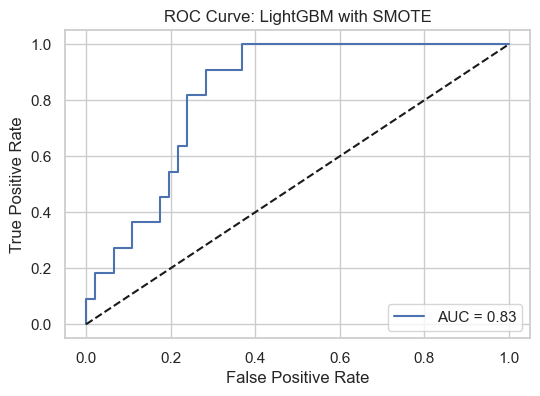


Training and tuning KNN with SMOTE...

KNN Performance with SMOTE:
Accuracy: 0.72
Precision: 0.38
Recall: 0.73
F1-Score: 0.50
AUC: 0.77


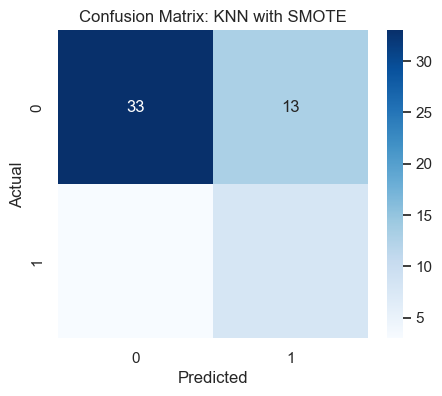

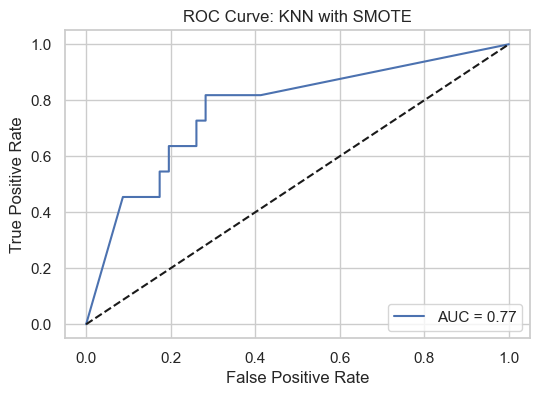


--- Resampling Method: ADASYN ---

Applied ADASYN. Resampled training set size: 207

Training and tuning Logistic Regression with ADASYN...

Logistic Regression Performance with ADASYN:
Accuracy: 0.74
Precision: 0.40
Recall: 0.73
F1-Score: 0.52
AUC: 0.85


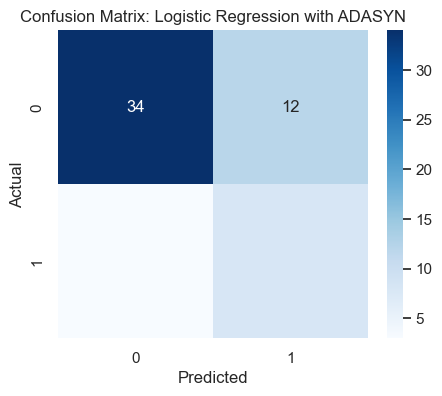

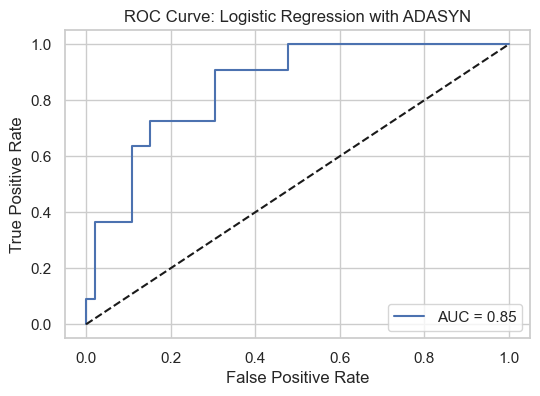


Training and tuning Decision Tree with ADASYN...

Decision Tree Performance with ADASYN:
Accuracy: 0.68
Precision: 0.29
Recall: 0.45
F1-Score: 0.36
AUC: 0.61


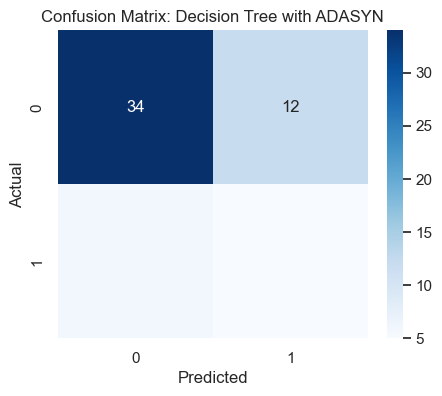

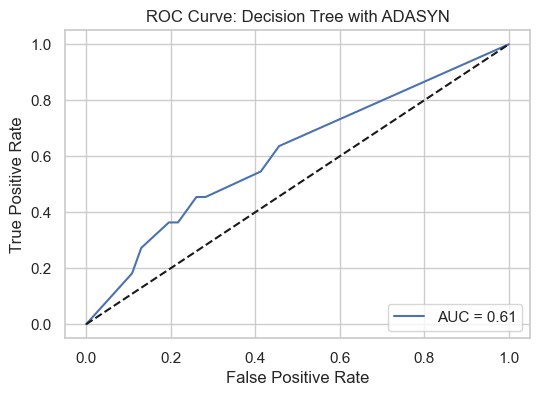


Training and tuning Random Forest with ADASYN...

Random Forest Performance with ADASYN:
Accuracy: 0.74
Precision: 0.36
Recall: 0.45
F1-Score: 0.40
AUC: 0.78


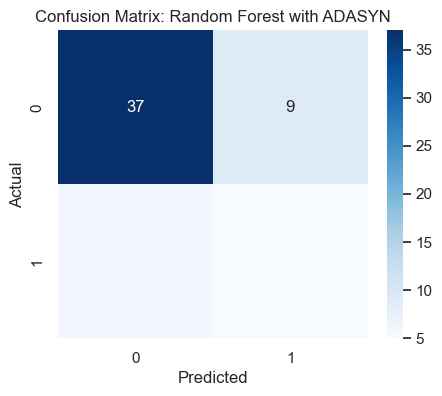

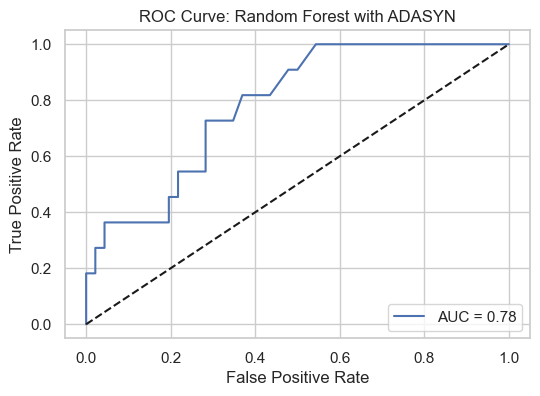


Training and tuning XGBoost with ADASYN...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:09] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with ADASYN:
Accuracy: 0.72
Precision: 0.33
Recall: 0.45
F1-Score: 0.38
AUC: 0.77


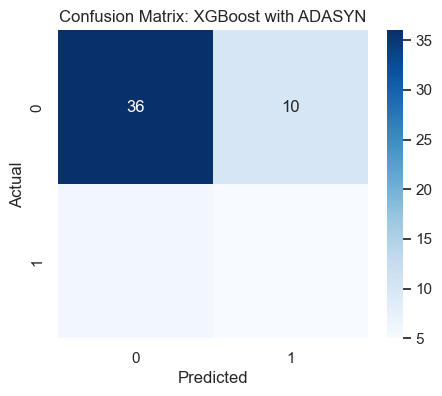

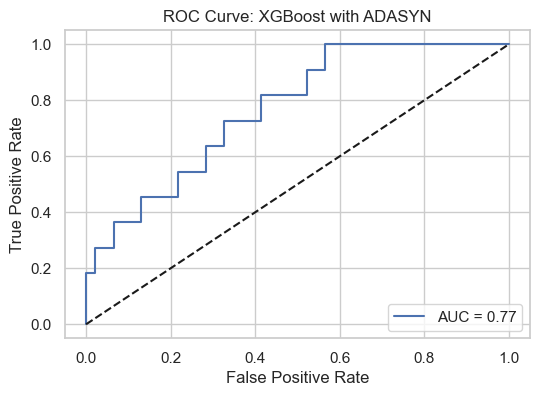


Training and tuning LightGBM with ADASYN...
[LightGBM] [Info] Number of positive: 81, number of negative: 84
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 167
[LightGBM] [Info] Number of data points in the train set: 165, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490909 -> initscore=-0.036368
[LightGBM] [Info] Start training from score -0.036368
[LightGBM] [Info] Number of positive: 81, number of negative: 84
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 82, number of negative: 84
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002333 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 168
[LightGBM] [Info] Number of data points in the train set: 165, number o

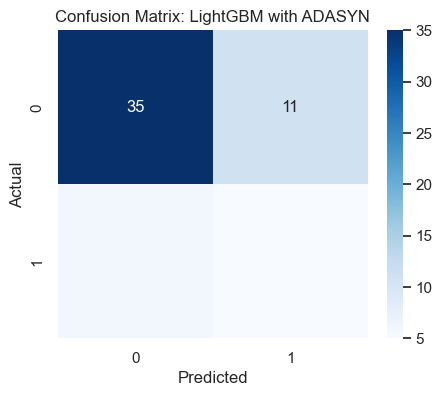

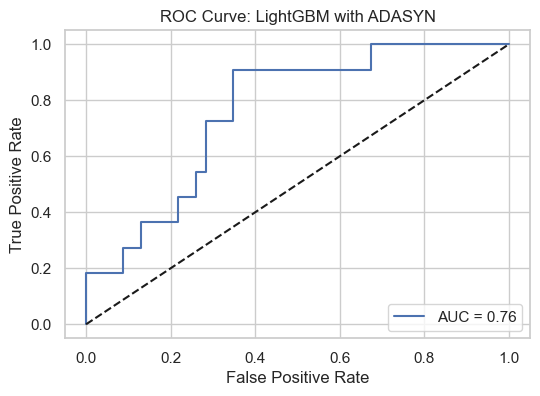


Training and tuning KNN with ADASYN...

KNN Performance with ADASYN:
Accuracy: 0.79
Precision: 0.47
Recall: 0.73
F1-Score: 0.57
AUC: 0.72


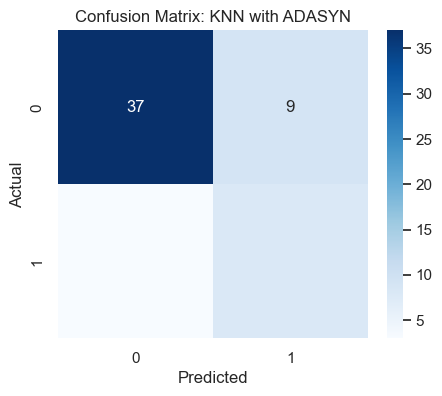

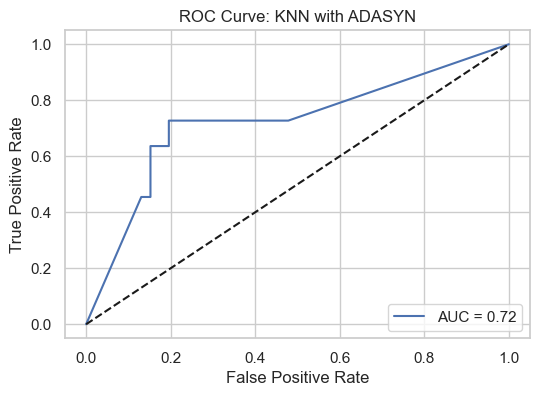


--- Resampling Method: SMOTEENN ---

Applied SMOTEENN. Resampled training set size: 122

Training and tuning Logistic Regression with SMOTEENN...

Logistic Regression Performance with SMOTEENN:
Accuracy: 0.67
Precision: 0.36
Recall: 0.91
F1-Score: 0.51
AUC: 0.84


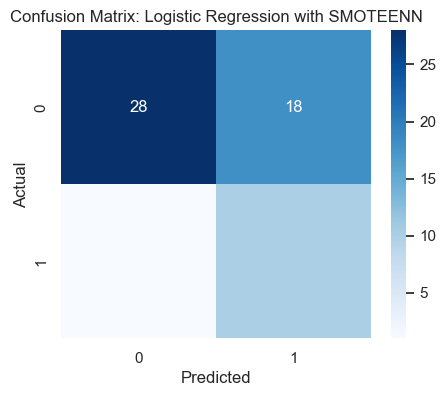

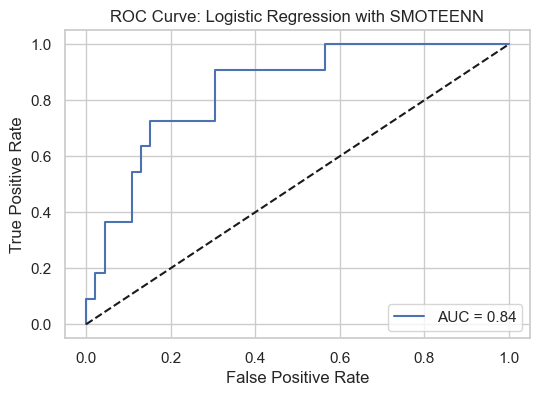


Training and tuning Decision Tree with SMOTEENN...

Decision Tree Performance with SMOTEENN:
Accuracy: 0.68
Precision: 0.33
Recall: 0.64
F1-Score: 0.44
AUC: 0.67


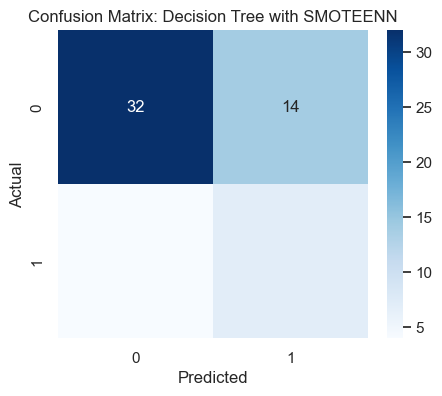

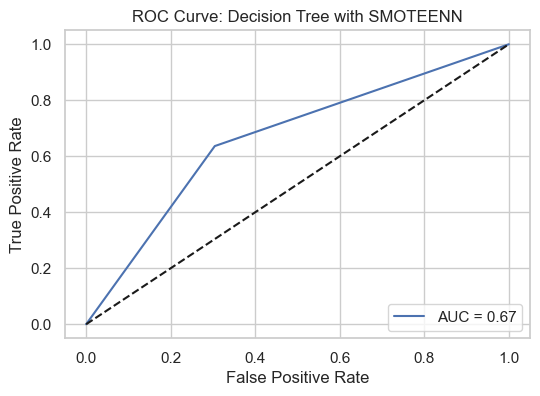


Training and tuning Random Forest with SMOTEENN...

Random Forest Performance with SMOTEENN:
Accuracy: 0.67
Precision: 0.32
Recall: 0.64
F1-Score: 0.42
AUC: 0.77


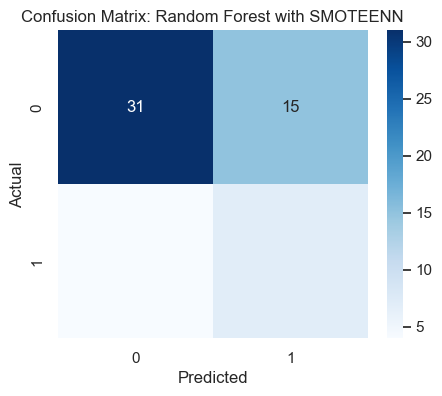

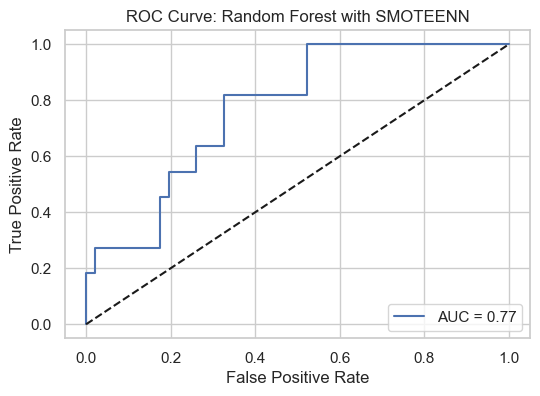


Training and tuning XGBoost with SMOTEENN...


/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:59:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/opt/anaconda3/lib/python3.11/site-packa


XGBoost Performance with SMOTEENN:
Accuracy: 0.70
Precision: 0.35
Recall: 0.64
F1-Score: 0.45
AUC: 0.72


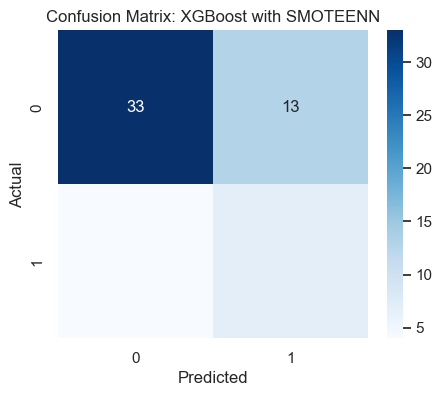

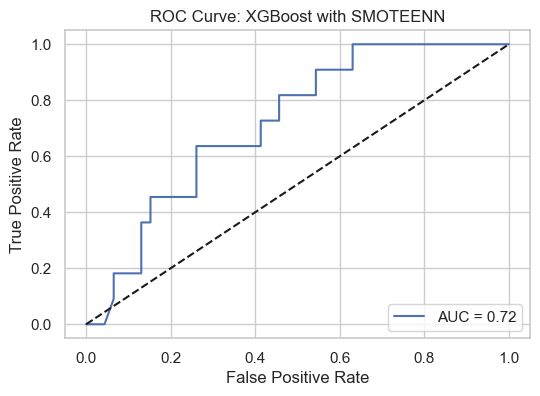


Training and tuning LightGBM with SMOTEENN...
[LightGBM] [Info] Number of positive: 54, number of negative: 43
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 99
[LightGBM] [Info] Number of data points in the train set: 97, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556701 -> initscore=0.227784
[LightGBM] [Info] Start training from score 0.227784
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Numbe

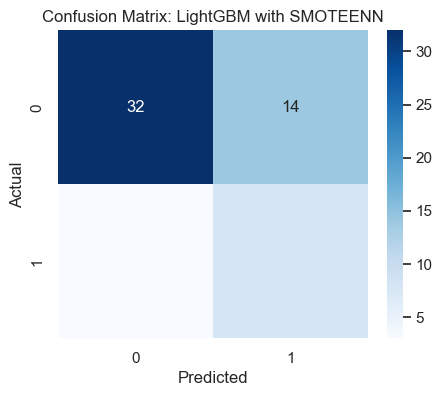

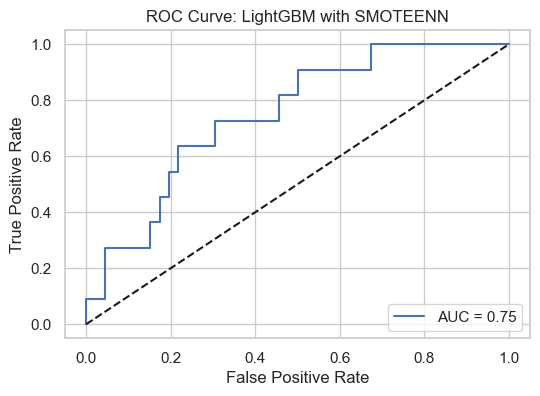


Training and tuning KNN with SMOTEENN...

KNN Performance with SMOTEENN:
Accuracy: 0.60
Precision: 0.29
Recall: 0.73
F1-Score: 0.41
AUC: 0.74


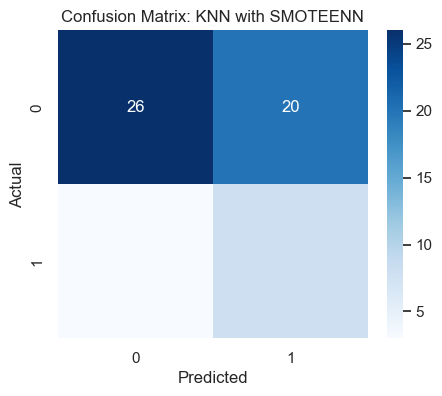

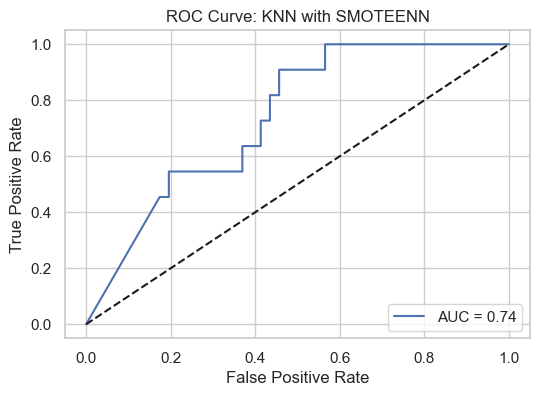


--- Comparing Model Performances ---

Classification Performance Metrics:
      Resampling                Model  Accuracy  Precision  Recall  F1-Score  \
0  No Resampling  Logistic Regression      0.82       0.67    0.18      0.29   
1  No Resampling        Decision Tree      0.74       0.25    0.18      0.21   
2  No Resampling        Random Forest      0.86       1.00    0.27      0.43   
3  No Resampling              XGBoost      0.82       1.00    0.09      0.17   
4  No Resampling             LightGBM      0.81       0.00    0.00      0.00   

    AUC                                        Best_Params  
0  0.86       {'C': 1, 'penalty': 'l2', 'solver': 'lbfgs'}  
1  0.57          {'max_depth': 5, 'min_samples_split': 10}  
2  0.77  {'max_depth': 5, 'min_samples_split': 5, 'n_es...  
3  0.70  {'learning_rate': 0.01, 'max_depth': 3, 'n_est...  
4  0.76  {'learning_rate': 0.01, 'max_depth': -1, 'n_es...  




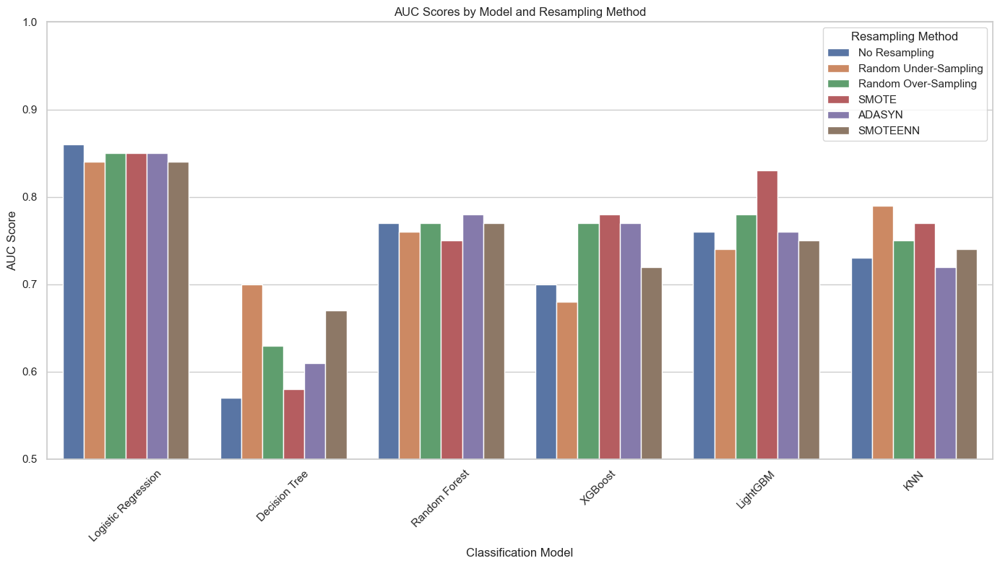

The best-performing model is **Logistic Regression** with **No Resampling** and an AUC of **0.86**.

Best Model Key: Logistic Regression_No Resampling


--- Performing Cross-Validation on the Best Model ---

Cross-Validation AUC Scores: [0.89400922 0.79166667 0.77916667 0.84285714 0.76190476]
Mean AUC: 0.8139
Standard Deviation of AUC: 0.0483

Detailed Cross-Validation Results:
       Accuracy  Precision    Recall  F1-Score       AUC
count  5.000000   5.000000  5.000000  5.000000  5.000000
mean   0.824609   0.666667  0.271429  0.382222  0.813921
std    0.034418   0.204124  0.019562  0.048177  0.053991
min    0.789474   0.500000  0.250000  0.333333  0.761905
25%    0.789474   0.500000  0.250000  0.333333  0.779167
50%    0.837838   0.666667  0.285714  0.400000  0.791667
75%    0.837838   0.666667  0.285714  0.400000  0.842857
max    0.868421   1.000000  0.285714  0.444444  0.894009




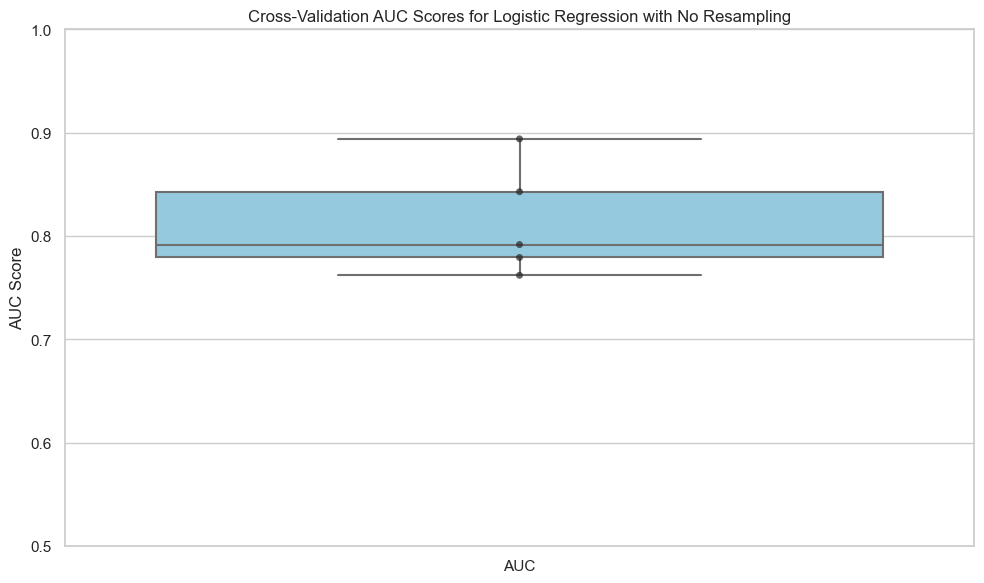

Cross-validation results saved to 'output_cis/cross_validation_Logistic Regression_No Resampling.csv'.


--- Extracting and Visualizing Feature Importances ---


--- Feature Importances for Logistic Regression_No Resampling ---

                    Feature  Importance
0                fico_score    1.028320
1  Monthly_Repayment_Burden    0.539442
2      Loan_to_Income_Ratio    0.186226


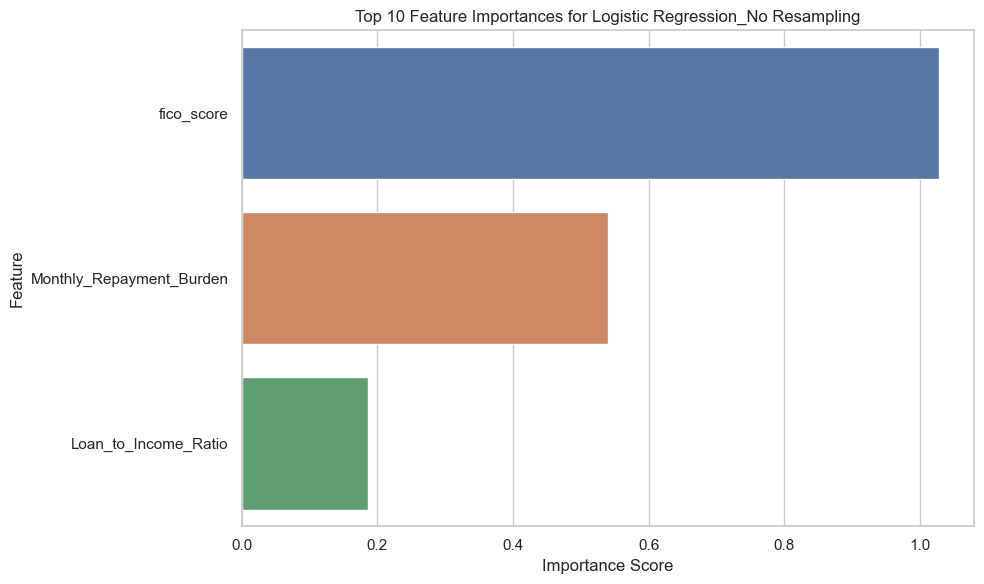


--- Feature Importances for Decision Tree_No Resampling ---

                    Feature  Importance
0                fico_score    0.715115
1  Monthly_Repayment_Burden    0.187583
2      Loan_to_Income_Ratio    0.097303


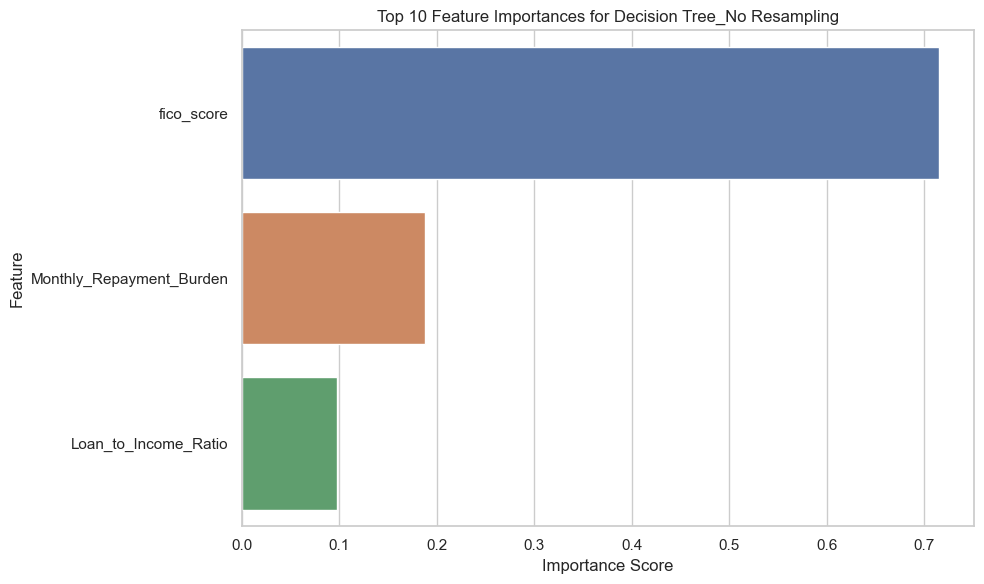


--- Feature Importances for Random Forest_No Resampling ---

                    Feature  Importance
0                fico_score    0.464660
1  Monthly_Repayment_Burden    0.295952
2      Loan_to_Income_Ratio    0.239388


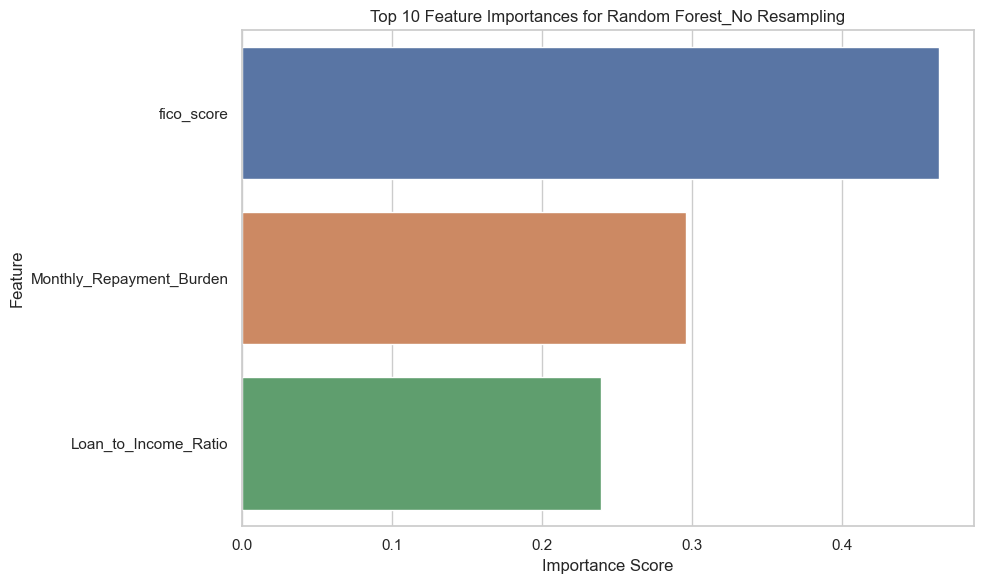


--- Feature Importances for XGBoost_No Resampling ---

                    Feature  Importance
0                fico_score    0.504832
1  Monthly_Repayment_Burden    0.276657
2      Loan_to_Income_Ratio    0.218511


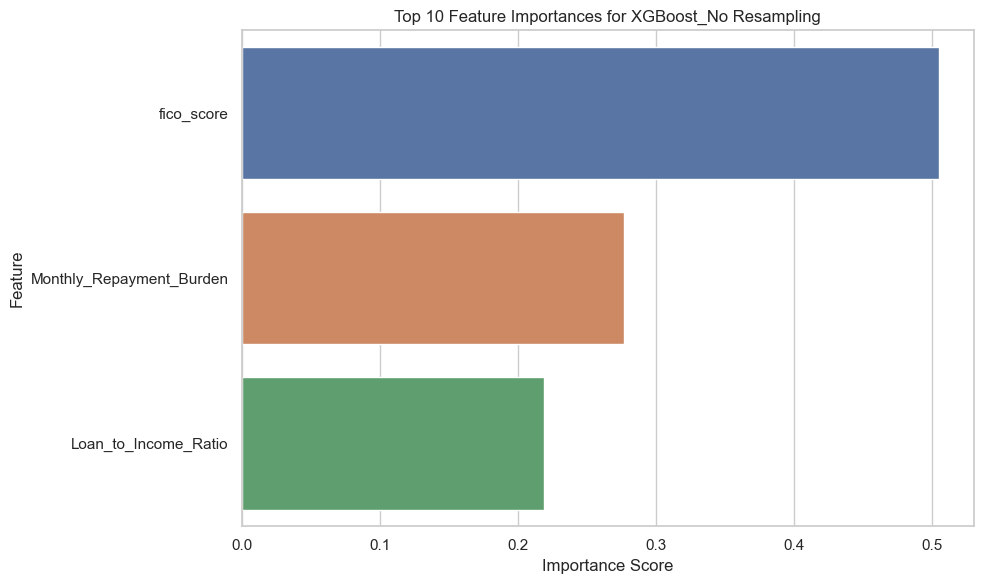


--- Feature Importances for LightGBM_No Resampling ---

                    Feature  Importance
0                fico_score         189
1  Monthly_Repayment_Burden         109
2      Loan_to_Income_Ratio          90


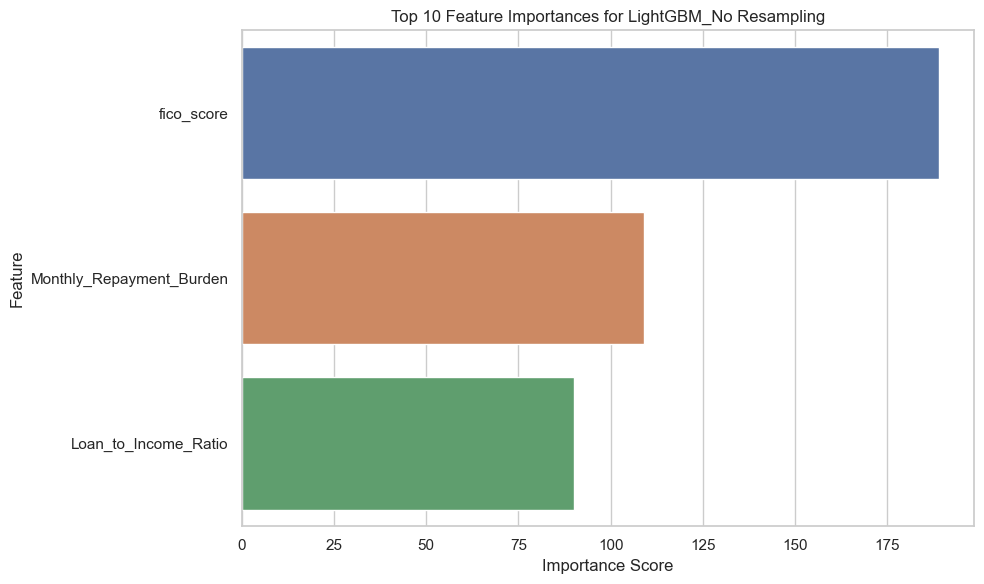


--- Feature Importances for KNN_No Resampling ---

Model does not support feature importances. Using permutation importance.


NameError: name 'permutation_importance' is not defined

In [19]:
# ----------------------------
# 2. Loan Repayment Risk Model (Classification)
# ----------------------------
print("\nTraining Loan Repayment Risk Model (Classification)...\n")

# Ensure Necessary Columns Exist
required_columns = [
    'customer_id', 'Outstanding Principal', 'Qualified / Verified\nIncome', 
    'Loan Amount', 'Outstanding Balance', 'Loan Term (Months)', 'Date of Birth', 'Disbursement Date',
    'Loan Status', 'Interest Rate', 'Gender', 'Province',
    'Residential Status', 'Stated Income on application', 'Aptitude for change Score',
    'Financial Literacy Score', 'Self Assessments', 'Quiz Count', 'Mood Count',
    'Inspiration Count', 'Average total activities per month',
    'Average activities per day', 'fico_score'
]
missing_columns = [col for col in required_columns if col not in full_data.columns]
if missing_columns:
    raise ValueError(f"Missing required columns: {missing_columns}")

print("Data loaded and merged successfully.\n")

# ----------------------------
# 2. Feature Engineering and Preprocessing
# ----------------------------

print("\n--- Feature Engineering and Preprocessing ---\n")

# Derive 'Repayment_Risk' Feature Based on 'Loan Status'
print("Deriving 'Repayment_Risk' feature...")

# Define High-Risk Loan Statuses
high_risk_statuses = ['Written off', 'Past due']

# Function to Determine Repayment Risk
def determine_repayment_risk(row):
    if row['Loan Status'] in high_risk_statuses:
        return 1  # High Risk
    else:
        return 0  # Low Risk

# Apply Function to Create 'Repayment_Risk'
full_data['Repayment_Risk'] = full_data.apply(determine_repayment_risk, axis=1)

# Feature Engineering: Create New Ratio Features
full_data['Debt_to_Income_Ratio'] = full_data['Outstanding Principal'] / full_data['Qualified / Verified\nIncome']
full_data['Loan_to_Income_Ratio'] = full_data['Loan Amount'] / full_data['Qualified / Verified\nIncome']
full_data['Monthly_Repayment_Burden'] = full_data['Outstanding Balance'] / full_data['Loan Term (Months)']

print("Repayment_Risk feature created based on 'Loan Status' and new ratio features engineered.\n")

# Display Counts and Unique Values
print("Counts of 'Repayment_Risk' in the entire dataset:")
print(full_data['Repayment_Risk'].value_counts())
print("\n")

print("Unique values in 'Repayment_Risk':", full_data['Repayment_Risk'].unique())
print("\n")

# Map Numerical Repayment Risk to Categorical Labels for EDA
full_data['Repayment_Risk_Label'] = full_data['Repayment_Risk'].map({0: 'Low', 1: 'High'})

print("Mapped 'Repayment_Risk' to categorical labels.\n")
print("Counts of 'Repayment_Risk_Label' in the entire dataset:")
print(full_data['Repayment_Risk_Label'].value_counts())
print("\n")

# Preprocessing Steps

print("Preprocessing data...")

# Define Columns to Remove (Exclude EDA-specific Columns)
columns_to_remove = [
    'ID', 'Date of Birth', 'Disbursement Date', 'Loan Status',
    # 'Loan Amount', 'Outstanding Balance', 'Outstanding Principal',  # Removed to keep ratio features
    # 'Loan Term (Months)', 'Stated Income on application', 'Qualified / Verified\nIncome',  # Removed to keep ratio features
    # 'Residential Status',  # Keep if essential
    # 'Gender',               # Keep this
    # 'Interest Rate',
    # 'Self Assessments', 'Quiz Count', 'Mood Count', 'Inspiration Count',
    # 'Total Activities', 'Average total activities per month', 'Average activities per day',
    # 'Loan_Age', 'Loan_Age_Months', 'rate_per_month', 'loan_id',
    # 'Province',            # Keep this
    # 'Engagement_Rate', 
    # 'Monthly_Income', 'Is_Homeowner',
    # 'Aptitude for change Score', 'Age_Loan_Interaction', 'Financial Literacy Score',
    # 'Total_Engagement', 'Monthly_Payment', 
    'Repayment_Risk_Label'  # Exclude EDA-specific label
]

# Create a Copy for Modeling
df_encoded = full_data.copy()
df_encoded.drop(columns=[col for col in columns_to_remove if col in df_encoded.columns], inplace=True)

# Handle Infinite Values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)

# Convert Essential Categorical Features to 'category' dtype
essential_categorical = ['Gender', 'Province']  # Add any other essential categorical features here
for col in essential_categorical:
    if col in df_encoded.columns:
        df_encoded[col] = df_encoded[col].astype('category')

# Separate Features and Target
X = df_encoded.drop('Repayment_Risk', axis=1)
y = df_encoded['Repayment_Risk']

# ----------------------------
# **Manual Feature Selection**
# ----------------------------

# Define the list of features you want to include in the model
selected_features = [
    # 'Debt_to_Income_Ratio',
    'Monthly_Repayment_Burden',
    'fico_score',
    'Loan_to_Income_Ratio'
    # Add more features as needed
]

# Ensure that all selected features exist in the DataFrame
missing_selected_features = [feat for feat in selected_features if feat not in X.columns]
if missing_selected_features:
    raise ValueError(f"The following selected features are missing from the dataset: {missing_selected_features}")

# Subset the feature set to include only the selected features
X = X[selected_features]

# Identify Numerical and Categorical Columns After Feature Selection
numeric_cols = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_cols = X.select_dtypes(include=['object', 'category']).columns.tolist()

# Print Columns for Verification
print("Selected Numeric Columns:", numeric_cols)
print("Selected Categorical Columns:", categorical_cols)
print("\n")

# Split Data into Training and Testing Sets
print("Splitting data into training and testing sets...")
X_train_raw, X_test_raw, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y
)
print("Data split successfully.\n")

# Verify y_train Contains Only Numerical Labels
print("Unique values in y_train:", y_train.unique())
print("\n")

# ----------------------------
# 3. Exploratory Data Analysis (EDA)
# ----------------------------

print("\n--- Exploratory Data Analysis (EDA) ---\n")

# Basic Information
print("1. Dataset Information:")
print(full_data.info())
print("\n")

# Summary Statistics
print("2. Summary Statistics:")
print(full_data.describe())
print("\n")

# Missing Values Analysis
print("3. Missing Values:")
missing_values = full_data.isnull().sum()
print(missing_values[missing_values > 0])
print("\n")

# Plot Missing Values Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(full_data.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap')
plt.tight_layout()
plt.show()
print("Missing values heatmap displayed.\n")

# Additional EDA Steps
print("4. Additional EDA Steps:\n")

# Distribution of Target Variable
plt.figure(figsize=(6,4))
if 'Repayment_Risk_Label' in full_data.columns:
    sns.countplot(x='Repayment_Risk_Label', data=full_data)
    plt.title('Distribution of Repayment_Risk')
    plt.xlabel('Repayment Risk')
    plt.ylabel('Count')
    # Remove redundant legend since hue is not used here
    plt.show()
else:
    print("Error: 'Repayment_Risk_Label' column not found in DataFrame.")

# Correlation Heatmap Using Numerical Columns
print("Generating Correlation Heatmap using Numerical Columns...\n")
numeric_df = full_data.select_dtypes(include=[np.number])

# Convert All Numeric Columns to Numeric Types (Handle Errors)
for col in numeric_df.columns:
    numeric_df[col] = pd.to_numeric(numeric_df[col], errors='coerce')

# Impute NaNs in Numerical Columns with Median
for col in numeric_df.columns:
    if numeric_df[col].isnull().any():
        print(f"\nHandling NaN values in '{col}' after conversion:")
        imputer = SimpleImputer(strategy='median')
        numeric_df[col] = imputer.fit_transform(numeric_df[[col]])

# Compute Correlation Matrix
corr = numeric_df.corr()

# Plot Correlation Heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(corr, annot=False, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Pairplot of Selected Numerical Features with Categorical Hue
selected_features = [
    'Debt_to_Income_Ratio', 'Loan_Age', 'Principal_Paid_Ratio', 
    'DTI_Ratio', 'Loan_to_Income_Ratio', 'fico_score', 'Repayment_Risk'
]

# Ensure Selected Features Exist in df
existing_features = [feat for feat in selected_features if feat in full_data.columns]

# Include 'Repayment_Risk_Label' for Hue
pairplot_features = existing_features + ['Repayment_Risk_Label']

# Check for Missing Features
missing_pairplot_features = [feat for feat in pairplot_features if feat not in full_data.columns]
if missing_pairplot_features:
    print(f"Missing features for pairplot: {missing_pairplot_features}")
else:
    sns.pairplot(full_data[pairplot_features], hue='Repayment_Risk_Label', diag_kind='kde')
    plt.show()

# Distribution of Numerical Features
numerical_features = [
    'Debt_to_Income_Ratio', 'Loan_Age', 'Principal_Paid_Ratio', 
    'DTI_Ratio', 'Loan_to_Income_Ratio', 'fico_score', 'Monthly_Repayment_Burden'
]
# Ensure These Features Exist
existing_numerical = [feat for feat in numerical_features if feat in full_data.columns]
full_data[existing_numerical].hist(bins=30, figsize=(15, 10))
plt.tight_layout()
plt.show()

# Boxplots to Detect Outliers
plt.figure(figsize=(15, 10))
for idx, feature in enumerate(existing_numerical):
    plt.subplot(3, 3, idx+1)
    sns.boxplot(y=full_data[feature])
    plt.title(f'Boxplot of {feature}')
plt.tight_layout()
plt.show()

# Categorical Features Analysis
categorical_features = ['Gender', 'Residential Status', 'Disbursement_Season']
for feature in categorical_features:
    if feature in full_data.columns:
        plt.figure(figsize=(6,4))
        sns.countplot(x=feature, hue='Repayment_Risk_Label', data=full_data)
        plt.title(f'{feature} vs Repayment_Risk')
        plt.xlabel(feature)
        plt.ylabel('Count')
        plt.legend(title='Repayment Risk')
        plt.show()
    else:
        print(f"Warning: '{feature}' column not found in DataFrame.")

print("Additional EDA completed.\n")

# ----------------------------
# 4. Preprocess the Data Before Resampling
# ----------------------------

print("\n--- Preprocessing the Data Before Resampling ---\n")

# Define Preprocessing Pipelines

# Numerical Transformer: Impute Missing Values and Scaling
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

# Categorical Transformer: Impute Missing Values and One-Hot Encoding
if categorical_cols:
    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='most_frequent')),
        ('onehot', OneHotEncoder(handle_unknown='ignore', sparse=False))
    ])

    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer, numeric_cols),
            ('cat', categorical_transformer, categorical_cols)
        ]
    )
else:
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer, numeric_cols)
        ]
    )

print("Preprocessing pipelines defined successfully.\n")

# Fit the Preprocessor on the Training Data and Transform Both Training and Testing Data
print("Fitting the preprocessor and transforming the data...")
X_train_processed = preprocessor.fit_transform(X_train_raw)
X_test_processed = preprocessor.transform(X_test_raw)
print("Data preprocessing completed.\n")

# Retrieve Feature Names After Preprocessing
def get_feature_names(column_transformer):
    """
    Retrieves feature names from a ColumnTransformer after preprocessing.
    """
    feature_names = []
    for name, transformer, cols in column_transformer.transformers_:
        if name == 'remainder':
            continue
        if isinstance(transformer, Pipeline):
            transformer = transformer.steps[-1][1]
        if hasattr(transformer, 'get_feature_names_out'):
            names = transformer.get_feature_names_out(cols)
        else:
            names = cols
        feature_names.extend(names)
    return feature_names

feature_names = get_feature_names(preprocessor)
print("Feature Names after Preprocessing:")
print(feature_names)
print("\n")

# ----------------------------
# 5. Define Resampling Methods
# ----------------------------

print("\n--- Defining Resampling Methods ---\n")

resampling_methods = {
    'No Resampling': None,
    'Random Under-Sampling': RandomUnderSampler(random_state=42),
    'Random Over-Sampling': RandomOverSampler(random_state=42),
    'SMOTE': SMOTE(random_state=42),
    'ADASYN': ADASYN(random_state=42),
    'SMOTEENN': SMOTEENN(random_state=42)
}

print("Resampling methods defined:\n")
for method in resampling_methods.keys():
    print(f"- {method}")
print("\n")

# ----------------------------
# 6. Initialize and Train Classification Models with Hyperparameter Tuning
# ----------------------------

print("\n--- Initializing and Training Classification Models ---\n")

# Function to Tune Models Using GridSearchCV
def tune_model(model, param_grid, X_train, y_train):
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        scoring='roc_auc',
        cv=5,
        n_jobs=-1
    )
    grid_search.fit(X_train, y_train)
    return grid_search.best_estimator_, grid_search.best_params_

# Define Classification Models and Their Hyperparameters
classification_models = {
    'Logistic Regression': {
        'model': LogisticRegression(random_state=42, max_iter=1000),
        'params': {
            'C': [0.01, 0.1, 1, 10],
            'penalty': ['l2'],
            'solver': ['lbfgs']
        }
    },
    'Decision Tree': {
        'model': DecisionTreeClassifier(random_state=42),
        'params': {
            'max_depth': [None, 5, 10],
            'min_samples_split': [2, 5, 10]
        }
    },
    'Random Forest': {
        'model': RandomForestClassifier(random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [None, 5, 10],
            'min_samples_split': [2, 5, 10]
        }
    },
    'XGBoost': {
        'model': xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [3, 5, 7],
            'learning_rate': [0.01, 0.1, 0.2]
        }
    },
    'LightGBM': {
        'model': lgb.LGBMClassifier(random_state=42),
        'params': {
            'n_estimators': [100, 200],
            'max_depth': [-1, 5, 10],
            'learning_rate': [0.01, 0.1, 0.2]
        }
    },
    # 'SVC': {  # Removed SVC from the classification models
    #     'model': SVC(probability=True, random_state=42),
    #     'params': {
    #         'C': [0.1, 1, 10],
    #         'kernel': ['linear', 'rbf']
    #     }
    # },
    'KNN': {
        'model': KNeighborsClassifier(),
        'params': {
            'n_neighbors': [3, 5, 7],
            'weights': ['uniform', 'distance']
        }
    }
}

# Initialize a dictionary to store the best models
best_models_dict = {}

# Initialize List to Store Classification Performance Metrics
classification_performance = []

# Iterate Over Each Resampling Method
for resample_name, resampler in resampling_methods.items():
    print(f"\n--- Resampling Method: {resample_name} ---\n")
    
    # Apply Resampling Method if Not 'No Resampling'
    if resampler is not None:
        X_train_resampled, y_train_resampled = resampler.fit_resample(X_train_processed, y_train)
        print(f"Applied {resample_name}. Resampled training set size: {X_train_resampled.shape[0]}")
    else:
        X_train_resampled, y_train_resampled = X_train_processed, y_train
        print(f"No resampling applied. Training set size remains: {X_train_resampled.shape[0]}")
    
    # Iterate Over Each Classification Model
    for model_name, model_info in classification_models.items():
        model = model_info['model']
        param_grid = model_info['params']
        
        print(f"\nTraining and tuning {model_name} with {resample_name}...")
        best_model, best_params = tune_model(model, param_grid, X_train_resampled, y_train_resampled)
        
        # Store the best model in the dictionary with a unique key
        key = f"{model_name}_{resample_name}"
        best_models_dict[key] = best_model
        
        # Predict on Test Data
        y_pred = best_model.predict(X_test_processed)
        
        # Predict Probabilities for AUC
        if hasattr(best_model, "predict_proba"):
            y_prob = best_model.predict_proba(X_test_processed)[:, 1]
        else:
            y_prob = best_model.decision_function(X_test_processed)
            # Normalize decision_function output to [0,1] for consistency
            y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())
        
        # Calculate Metrics
        acc = accuracy_score(y_test, y_pred)
        prec = precision_score(y_test, y_pred, zero_division=0)
        rec = recall_score(y_test, y_pred, zero_division=0)
        f1 = f1_score(y_test, y_pred, zero_division=0)
        auc = roc_auc_score(y_test, y_prob)
        
        # Store Metrics
        classification_performance.append({
            'Resampling': resample_name,
            'Model': model_name,
            'Accuracy': round(acc, 2),
            'Precision': round(prec, 2),
            'Recall': round(rec, 2),
            'F1-Score': round(f1, 2),
            'AUC': round(auc, 2),
            'Best_Params': best_params  # Store best hyperparameters
        })
        
        # Print Metrics
        print(f"\n{model_name} Performance with {resample_name}:")
        print(f"Accuracy: {acc:.2f}")
        print(f"Precision: {prec:.2f}")
        print(f"Recall: {rec:.2f}")
        print(f"F1-Score: {f1:.2f}")
        print(f"AUC: {auc:.2f}")
        
        # Optional: Plot Confusion Matrix and ROC Curve
        # Uncomment the following lines if desired
        
        # Confusion Matrix
        cm = confusion_matrix(y_test, y_pred)
        plt.figure(figsize=(5,4))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
        plt.title(f'Confusion Matrix: {model_name} with {resample_name}')
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.show()
        
        # ROC Curve
        fpr, tpr, thresholds = roc_curve(y_test, y_prob)
        plt.figure(figsize=(6,4))
        plt.plot(fpr, tpr, label=f'AUC = {auc:.2f}')
        plt.plot([0, 1], [0, 1], 'k--')
        plt.title(f'ROC Curve: {model_name} with {resample_name}')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend(loc='lower right')
        plt.show()

# ----------------------------
# 7. Compare Model Performances in a Chart
# ----------------------------

print("\n--- Comparing Model Performances ---\n")

# Convert the classification performance list to a DataFrame
performance_df = pd.DataFrame(classification_performance)

# Display the Performance DataFrame
print("Classification Performance Metrics:")
print(performance_df.head())
print("\n")

# Plotting AUC Scores for All Models and Resampling Methods

plt.figure(figsize=(14, 8))
sns.barplot(
    data=performance_df,
    x='Model',
    y='AUC',
    hue='Resampling'
)
plt.title('AUC Scores by Model and Resampling Method')
plt.xlabel('Classification Model')
plt.ylabel('AUC Score')
plt.legend(title='Resampling Method')
plt.xticks(rotation=45)
plt.ylim(0.5, 1.0)  # Assuming AUC ranges between 0.5 and 1.0
plt.tight_layout()
plt.show()

# Identify the Best-Performing Model Based on AUC

best_performance = performance_df.loc[performance_df['AUC'].idxmax()]
best_model_name = best_performance['Model']
best_resampling = best_performance['Resampling']
best_auc = best_performance['AUC']

print(f"The best-performing model is **{best_model_name}** with **{best_resampling}** and an AUC of **{best_auc}**.\n")

# Retrieve the Best Model
best_model_key = f"{best_model_name}_{best_resampling}"
best_model = best_models_dict.get(best_model_key)

if best_model is None:
    print(f"Error: Best model '{best_model_key}' not found in the trained models dictionary.")
else:
    print(f"Best Model Key: {best_model_key}\n")

    # ----------------------------
    # 8. Perform Cross-Validation on the Best Model
    # ----------------------------

    print("\n--- Performing Cross-Validation on the Best Model ---\n")

    # Define Cross-Validation Strategy
    cv_strategy = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    # Perform Cross-Validation
    cv_scores = cross_val_score(
        best_model,
        preprocessor.transform(X),  # Use the entire dataset with preprocessing
        y,
        cv=cv_strategy,
        scoring='roc_auc',
        n_jobs=-1
    )

    # Report Cross-Validation Results
    print(f"Cross-Validation AUC Scores: {cv_scores}")
    print(f"Mean AUC: {cv_scores.mean():.4f}")
    print(f"Standard Deviation of AUC: {cv_scores.std():.4f}\n")

    # Detailed Cross-Validation Metrics
    # Optionally, you can compute other metrics using cross_validate

    from sklearn.model_selection import cross_validate

    cv_results = cross_validate(
        best_model,
        preprocessor.transform(X),
        y,
        cv=cv_strategy,
        scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'],
        return_train_score=False,
        n_jobs=-1
    )

    # Create a DataFrame for Cross-Validation Results
    cv_results_df = pd.DataFrame({
        'Accuracy': cv_results['test_accuracy'],
        'Precision': cv_results['test_precision'],
        'Recall': cv_results['test_recall'],
        'F1-Score': cv_results['test_f1'],
        'AUC': cv_results['test_roc_auc']
    })

    # Display Cross-Validation Results
    print("Detailed Cross-Validation Results:")
    print(cv_results_df.describe())
    print("\n")

    # Plot Cross-Validation AUC Scores
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=cv_results_df[['AUC']], color='skyblue')
    sns.swarmplot(data=cv_results_df[['AUC']], color='black', alpha=0.7)
    plt.title(f'Cross-Validation AUC Scores for {best_model_name} with {best_resampling}')
    plt.ylabel('AUC Score')
    plt.ylim(0.5, 1.0)
    plt.tight_layout()
    plt.show()

    # Save Cross-Validation Results
    cv_results_df.to_csv(os.path.join(OUTPUT_DIR, f'cross_validation_{best_model_key}.csv'), index=False)
    print(f"Cross-validation results saved to '{os.path.join(OUTPUT_DIR, f'cross_validation_{best_model_key}.csv')}'.\n")

# ----------------------------
# 7. Extract and Visualize Feature Importances
# ----------------------------

print("\n--- Extracting and Visualizing Feature Importances ---\n")

# Define Function to Extract Feature Importances
def get_feature_importances(model, feature_names):
    """
    Extracts feature importances or coefficients from a trained model.
    
    Parameters:
    - model: Trained machine learning model.
    - feature_names: List of feature names after preprocessing.
    
    Returns:
    - DataFrame containing feature names and their importances.
    """
    if hasattr(model, 'feature_importances_'):
        importances = model.feature_importances_
        importance_df = pd.DataFrame({
            'Feature': feature_names,
            'Importance': importances
        })
    elif hasattr(model, 'coef_'):
        coefficients = model.coef_[0]
        importance_df = pd.DataFrame({
            'Feature': feature_names,
            'Importance': np.abs(coefficients)  # Use absolute value for coefficients
        })
    else:
        # For models without feature_importances_ or coef_, use permutation importance
        print("Model does not support feature importances. Using permutation importance.")
        # Compute permutation importance on the test set
        importance_df = compute_permutation_importance(model, X_test_processed, y_test, feature_names)
        return importance_df
    
    # Sort by importance
    importance_df = importance_df.sort_values(by='Importance', ascending=False).reset_index(drop=True)
    return importance_df

# Define Function to Compute Permutation Importance
def compute_permutation_importance(model, X, y, feature_names, n_repeats=30, random_state=42):
    """
    Computes permutation importance for a given model.
    
    Parameters:
    - model: Trained machine learning model.
    - X: Features (numpy array or DataFrame).
    - y: True labels.
    - feature_names: List of feature names.
    - n_repeats: Number of times to permute a feature.
    - random_state: Random seed.
    
    Returns:
    - DataFrame of feature importances.
    """
    result = permutation_importance(model, X, y, n_repeats=n_repeats, random_state=random_state, n_jobs=-1)
    importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': result.importances_mean
    }).sort_values(by='Importance', ascending=False).reset_index(drop=True)
    return importance_df

# Iterate over each trained model to extract feature importances
for key, model in best_models_dict.items():
    print(f"\n--- Feature Importances for {key} ---\n")
    
    importance_df = get_feature_importances(model, feature_names)
    
    if importance_df is not None:
        # Display the top 10 features
        print(importance_df.head(10))
        
        # Plot the top 10 feature importances
        plt.figure(figsize=(10, 6))
        sns.barplot(x='Importance', y='Feature', data=importance_df.head(10))
        plt.title(f'Top 10 Feature Importances for {key}')
        plt.xlabel('Importance Score')
        plt.ylabel('Feature')
        plt.tight_layout()
        plt.show()
    else:
        print("Feature importances could not be extracted for this model.")

# ----------------------------
# 9. Save Performance Metrics and Feature Importances
# ----------------------------

print("\n--- Saving Performance Metrics and Feature Importances ---\n")

# Save the classification performance metrics to a CSV file
performance_df.to_csv(os.path.join(OUTPUT_DIR, 'classification_performance.csv'), index=False)
print(f"Classification performance metrics saved to '{os.path.join(OUTPUT_DIR, 'classification_performance.csv')}'.\n")

# Save feature importances for each model
for key, model in best_models_dict.items():
    importance_df = get_feature_importances(model, feature_names)
    if importance_df is not None:
        importance_df.to_csv(os.path.join(OUTPUT_DIR, f'feature_importance_{key}.csv'), index=False)
        print(f"Feature importances for '{key}' saved to '{os.path.join(OUTPUT_DIR, f'feature_importance_{key}.csv')}'.")
    else:
        print(f"Feature importances could not be saved for '{key}'.")

print("\nAll processes completed successfully.")


True_Engagement_Level column created in df_engagement:
     customer_id  Actual_activities_count True_Engagement_Level
1667       16138                        9     Medium Engagement
480         1215                       11       High Engagement
905        14063                       11       High Engagement
1151        1463                        1        Low Engagement
29         11036                       19       High Engagement

Predicted_Engagement_Level column created in df_engagement:
     customer_id  Predicted_activities_count Predicted_Engagement_Level
1667       16138                    8.703613          Medium Engagement
480         1215                   11.192967            High Engagement
905        14063                    9.850356          Medium Engagement
1151        1463                   10.794711            High Engagement
29         11036                    9.973392          Medium Engagement

DataFrames merged successfully.

Checking for missing values in ci

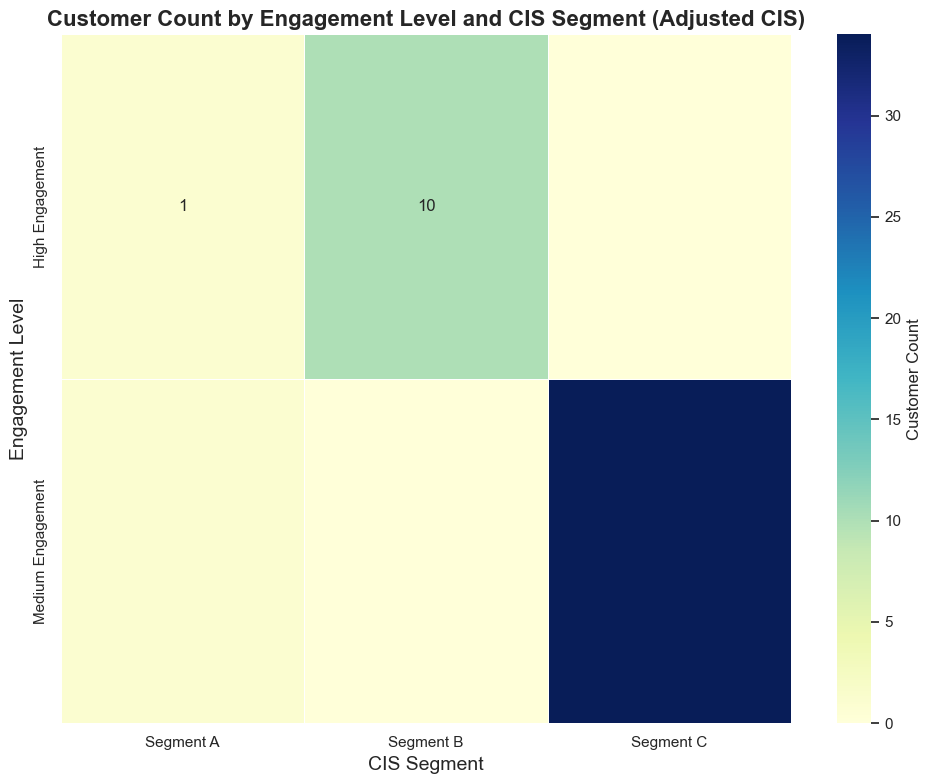

Adjusted CIS heatmap plot saved to 'cis_heatmap_adjusted.png'.

Number of Early Warning Customers (Repayment Risk Probability >= 0.8): 0
Empty DataFrame
Columns: [customer_id, Predicted_Repayment_Probability]
Index: [] 

Early Warning Customers saved to 'output_cis/Early_Warning_Customers_20241202_191005.csv'.

No duplicate customer_ids found in df_engagement.
No duplicate customer_ids found in df_repayment.
No missing customer_ids in cis_data after merge.
All required columns exist in cis_data.

All data integrity checks passed successfully.



In [ ]:
# ----------------------------
# 3. Customer Index Score (CIS) Calculation
# ----------------------------

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Ensure OUTPUT_DIR exists
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)
    print(f"Created directory: {OUTPUT_DIR}")

# 1. Derive 'True_Engagement_Level' from 'Actual_activities_count'
conditions_true_eng = [
    (df_engagement['Actual_activities_count'] <= 5),
    (df_engagement['Actual_activities_count'] > 5) & (df_engagement['Actual_activities_count'] <= 10),
    (df_engagement['Actual_activities_count'] > 10)
]
choices_true_eng = ['Low Engagement', 'Medium Engagement', 'High Engagement']
df_engagement['True_Engagement_Level'] = np.select(conditions_true_eng, choices_true_eng)

print("\nTrue_Engagement_Level column created in df_engagement:")
print(df_engagement[['customer_id', 'Actual_activities_count', 'True_Engagement_Level']].head())

# 2. Derive 'Predicted_Engagement_Level' from 'Predicted_activities_count'
conditions_pred_eng = [
    (df_engagement['Predicted_activities_count'] <= 5),
    (df_engagement['Predicted_activities_count'] > 5) & (df_engagement['Predicted_activities_count'] <= 10),
    (df_engagement['Predicted_activities_count'] > 10)
]
choices_pred_eng = ['Low Engagement', 'Medium Engagement', 'High Engagement']
df_engagement['Predicted_Engagement_Level'] = np.select(conditions_pred_eng, choices_pred_eng)

print("\nPredicted_Engagement_Level column created in df_engagement:")
print(df_engagement[['customer_id', 'Predicted_activities_count', 'Predicted_Engagement_Level']].head())

# 3. Merge df_engagement and df_repayment on 'customer_id'
try:
    cis_data = pd.merge(df_engagement, df_repayment, on='customer_id', how='inner')
    print("\nDataFrames merged successfully.\n")
except KeyError as e:
    print(f"Merge failed. Missing key: {e}")
    raise

# 4. Check for missing values
print("Checking for missing values in cis_data:")
print(cis_data.isnull().sum(), "\n")

# 5. Handle missing values
# Identify categorical and numerical columns
categorical_cols = [
    'Engagement_Level', 
    'True_Engagement_Level', 
    'Predicted_Engagement_Level',
    'True_Repayment_Risk', 
    'Predicted_Repayment_Risk'
]
numerical_cols = ['Predicted_Repayment_Probability']

# Fill categorical columns with mode
for col in categorical_cols:
    if col in cis_data.columns:
        if cis_data[col].isnull().any():
            mode_value = cis_data[col].mode()[0]
            cis_data[col].fillna(mode_value, inplace=True)
            print(f"Filled missing values in '{col}' with mode: {mode_value}")

# Fill numerical columns with mean
for col in numerical_cols:
    if col in cis_data.columns:
        if cis_data[col].isnull().any():
            mean_value = cis_data[col].mean()
            cis_data[col].fillna(mean_value, inplace=True)
            print(f"Filled missing values in '{col}' with mean: {mean_value:.2f}")

# Verify filling
print("\nAfter handling missing values:")
print(cis_data.isnull().sum(), "\n")

# 6. Define numeric scores for categorical variables
engagement_score_mapping = {'Low Engagement': 1, 'Medium Engagement': 2, 'High Engagement': 3}
repayment_risk_mapping = {'Low Risk': 1, 'Medium Risk': 2, 'High Risk': 3}

# Map categorical columns to numeric scores
cis_data['Engagement_Score'] = cis_data['Predicted_Engagement_Level'].map(engagement_score_mapping)
cis_data['Repayment_Risk_Score'] = cis_data['Predicted_Repayment_Risk'].map(repayment_risk_mapping)

# Check for unmapped categories and handle them
unmapped_engagement = cis_data['Engagement_Score'].isnull().sum()
unmapped_risk = cis_data['Repayment_Risk_Score'].isnull().sum()

if unmapped_engagement > 0:
    print(f"Warning: {unmapped_engagement} entries in 'Predicted_Engagement_Level' were not mapped.")
    # Fill unmapped categories with a default value (e.g., 2 for Medium Engagement)
    cis_data['Engagement_Score'].fillna(2, inplace=True)

if unmapped_risk > 0:
    print(f"Warning: {unmapped_risk} entries in 'Predicted_Repayment_Risk' were not mapped.")
    # Fill unmapped categories with a default value (e.g., 2 for Medium Risk)
    cis_data['Repayment_Risk_Score'].fillna(2, inplace=True)

# 7. Define CIS as a weighted combination
# Example weights: Engagement = 0.45, Repayment Risk = 0.55
cis_data['CIS'] = (cis_data['Engagement_Score'] * 0.3) + (cis_data['Repayment_Risk_Score'] * 0.7)

# 8. Define CIS Segments based on CIS score
def define_cis_segment(cis_score):
    if cis_score >= 2.6:
        return 'Segment A'
    elif cis_score >= 1.3:
        return 'Segment B'
    else:
        return 'Segment C'

cis_data['CIS_Segment'] = cis_data['CIS'].apply(define_cis_segment)

# 9. Verify CIS and CIS_Segment
print("CIS and CIS_Segment Distribution:")
print(cis_data[['CIS', 'CIS_Segment']].head())
print("\nCIS_Segment Value Counts:")
print(cis_data['CIS_Segment'].value_counts(), "\n")

# 10. Save CIS Data
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
cis_output_path = os.path.join(OUTPUT_DIR, f'Customer_Index_Score_Adjusted_{timestamp}.csv')
cis_data.to_csv(cis_output_path, index=False)
print(f"Adjusted CIS Calculation Completed and saved to '{cis_output_path}'.\n")

# 11. Create Pivot Table
pivot_table_cis = pd.pivot_table(
    cis_data, 
    index='Predicted_Engagement_Level', 
    columns='CIS_Segment', 
    aggfunc='size',
    fill_value=0
).astype(int)

print("Pivot Table for Heatmap:")
print(pivot_table_cis, "\n")

# 12. Plot Heatmap
plt.figure(figsize=(10,8))
sns.heatmap(pivot_table_cis, annot=True, fmt='d', cmap='YlGnBu', linewidths=.5, cbar_kws={'label': 'Customer Count'})
plt.title('Customer Count by Engagement Level and CIS Segment (Adjusted CIS)', fontsize=16, fontweight='bold')
plt.xlabel('CIS Segment', fontsize=14)
plt.ylabel('Engagement Level', fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, f'cis_heatmap_adjusted_{timestamp}.png'))
plt.show()
print("Adjusted CIS heatmap plot saved to 'cis_heatmap_adjusted.png'.\n")

# 13. Define High-Risk Threshold
high_risk_threshold = 0.8  # Adjust as per business requirements

# 14. Identify Early Warning Customers
early_warning_customers = cis_data[cis_data['Predicted_Repayment_Probability'] >= high_risk_threshold]

print(f"Number of Early Warning Customers (Repayment Risk Probability >= {high_risk_threshold}): {early_warning_customers.shape[0]}")
print(early_warning_customers[['customer_id', 'Predicted_Repayment_Probability']].head(), "\n")

# 15. Save Early Warning Customers
early_warning_output_path = os.path.join(OUTPUT_DIR, f'Early_Warning_Customers_{timestamp}.csv')
early_warning_customers.to_csv(early_warning_output_path, index=False)
print(f"Early Warning Customers saved to '{early_warning_output_path}'.\n")

# 16. Ensure Data Integrity

# Assert that 'customer_id' is unique in both DataFrames
try:
    assert df_engagement['customer_id'].is_unique, "Duplicate customer_ids found in df_engagement."
    print("No duplicate customer_ids found in df_engagement.")
except AssertionError as e:
    print(e)
    # Handle duplicates as needed, e.g., drop duplicates
    df_engagement = df_engagement.drop_duplicates(subset='customer_id')
    print("Duplicates removed from df_engagement.")

try:
    assert df_repayment['customer_id'].is_unique, "Duplicate customer_ids found in df_repayment."
    print("No duplicate customer_ids found in df_repayment.")
except AssertionError as e:
    print(e)
    # Handle duplicates as needed, e.g., drop duplicates
    df_repayment = df_repayment.drop_duplicates(subset='customer_id')
    print("Duplicates removed from df_repayment.")

# Ensure no missing customer_ids after merge
try:
    assert not cis_data['customer_id'].isnull().any(), "Missing customer_ids in cis_data after merge."
    print("No missing customer_ids in cis_data after merge.")
except AssertionError as e:
    print(e)
    # Handle missing customer_ids as needed, e.g., drop rows with missing customer_id
    cis_data = cis_data.dropna(subset=['customer_id'])
    print("Rows with missing customer_id removed from cis_data.")

# Validate that all required columns exist
required_columns = [
    'customer_id', 
    'True_Engagement_Level', 
    'Predicted_Engagement_Level',
    'Predicted_Repayment_Probability', 
    'True_Repayment_Risk', 
    'Predicted_Repayment_Risk',
    'CIS', 
    'CIS_Segment',
    'Engagement_Score', 
    'Repayment_Risk_Score'
]

missing_required_cols = [col for col in required_columns if col not in cis_data.columns]
if missing_required_cols:
    print(f"Error: The following required columns are missing in cis_data: {missing_required_cols}")
    # Decide on a strategy: raise an error, fill missing columns, or exclude affected rows
    raise KeyError(f"Missing columns: {missing_required_cols}")
else:
    print("All required columns exist in cis_data.\n")

print("All data integrity checks passed successfully.\n")